In [1]:
# This module trains a GRU model for the prediction of wind speed
# and prints the error metrics

import pandas as pd
import numpy as np

from prophet import Prophet

from sklearn.preprocessing import MinMaxScaler
from sklearn import metrics

from PyEMD import CEEMDAN

import matplotlib.pyplot as plt
%matplotlib notebook

from tensorflow import keras
from tensorflow.keras.utils import plot_model

from prophet.plot import plot_plotly, plot_components_plotly, add_changepoints_to_plot

In [2]:
#function for printing the metrics of the predictions
def print_metrics(pred, y_vals):
    print('mape: ', metrics.mean_absolute_percentage_error(y_vals, pred))
    print('mae: ', metrics.mean_absolute_error(y_vals, pred))
    print('mse: ', metrics.mean_squared_error(y_vals, pred))
    print('rmse: ', np.sqrt(metrics.mean_squared_error(y_vals, pred)))
    print('score: ', metrics.r2_score(y_vals, pred))
    count = 0
    y_error = pred.flatten() - y_vals.flatten()
    y_error = np.array([abs(e) for e in y_error]).flatten()

    # accuracy calculation(number of predictions having less than 20% error)
    for i in range(len(y_error)):
        if(y_error[i] < 0.20 * y_test[i]):
            count += 1
    print('accuracy: ', count / len(pred))

In [3]:
data = pd.read_csv('data.csv')

In [4]:
data.describe().round()

,lrad,prec,pres,shum,srad,temp,wind
count,5840.0,5840.0,5840.0,5840.0,5840.0,5840.0,5840.0
mean,269.0,0.0,85521.0,0.0,193.0,281.0,4.0
std,65.0,0.0,611.0,0.0,268.0,14.0,2.0
min,132.0,0.0,83722.0,0.0,0.0,246.0,0.0
25%,216.0,0.0,85050.0,0.0,0.0,270.0,2.0
50%,266.0,0.0,85520.0,0.0,3.0,283.0,4.0
75%,321.0,0.0,85974.0,0.0,352.0,293.0,5.0
max,450.0,3.0,86820.0,0.0,990.0,311.0,16.0


In [5]:
y = data[["wind"]][1:]

In [6]:
IImfs=[]
def ceemdan_decompose_res(data):
    ceemdan = CEEMDAN()
    ceemdan.ceemdan(data)
    imfs, res = ceemdan.get_imfs_and_residue()
    plt.figure(figsize=(12,9))
    plt.subplots_adjust(hspace=0.1)
    plt.subplot(imfs.shape[0]+3, 1, 1)
    plt.plot(data,'r')
    for i in range(imfs.shape[0]):
        plt.subplot(imfs.shape[0]+3,1,i+2)
        plt.plot(imfs[i], 'g')
        plt.ylabel("IMF %i" %(i+1))
        plt.locator_params(axis='x', nbins=10)
        # 在函数前必须设置一个全局变量 IImfs=[]
        IImfs.append(imfs[i])
    plt.subplot(imfs.shape[0]+3, 1, imfs.shape[0]+3)
    plt.plot(res,'g')
    return res

<IPython.core.display.Javascript object>


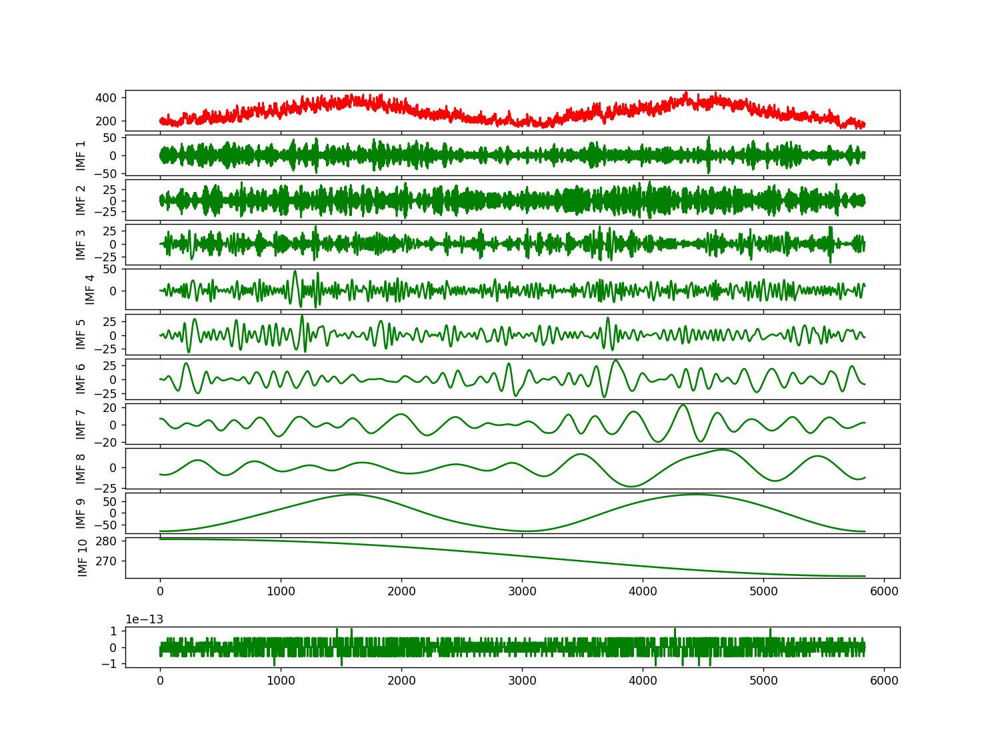

<IPython.core.display.Javascript object>


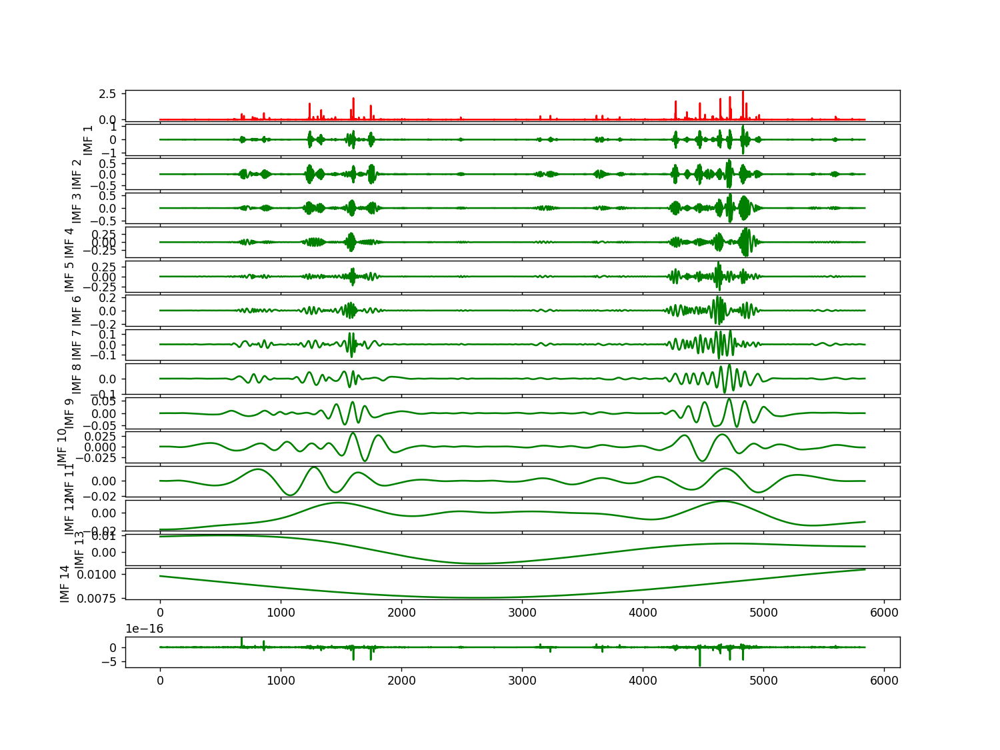

<IPython.core.display.Javascript object>


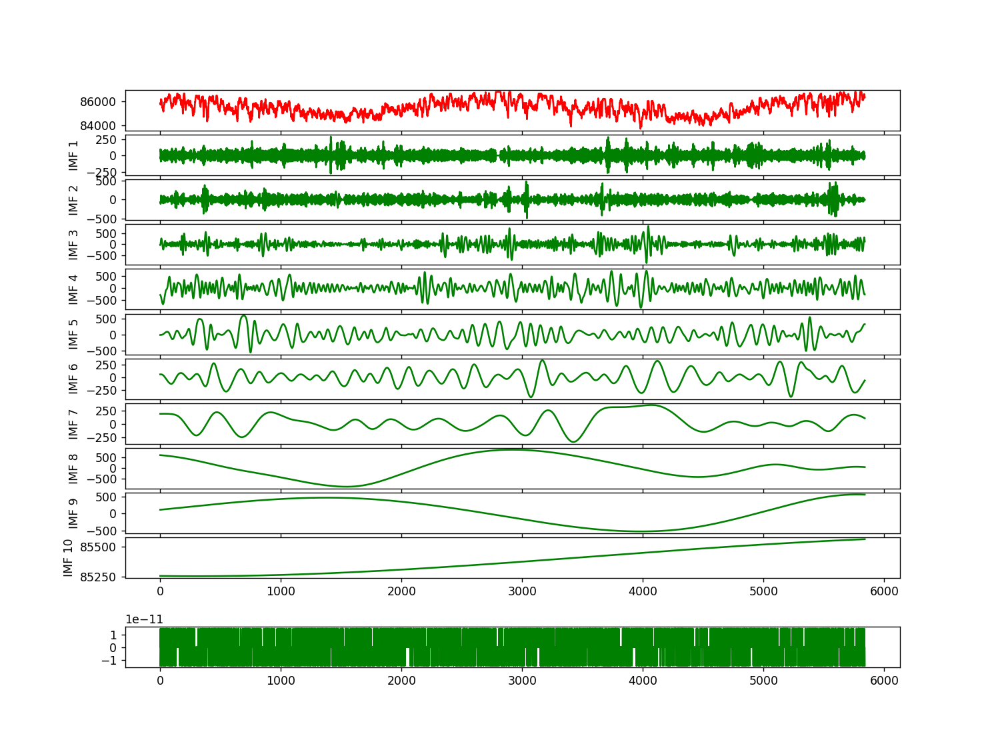

<IPython.core.display.Javascript object>


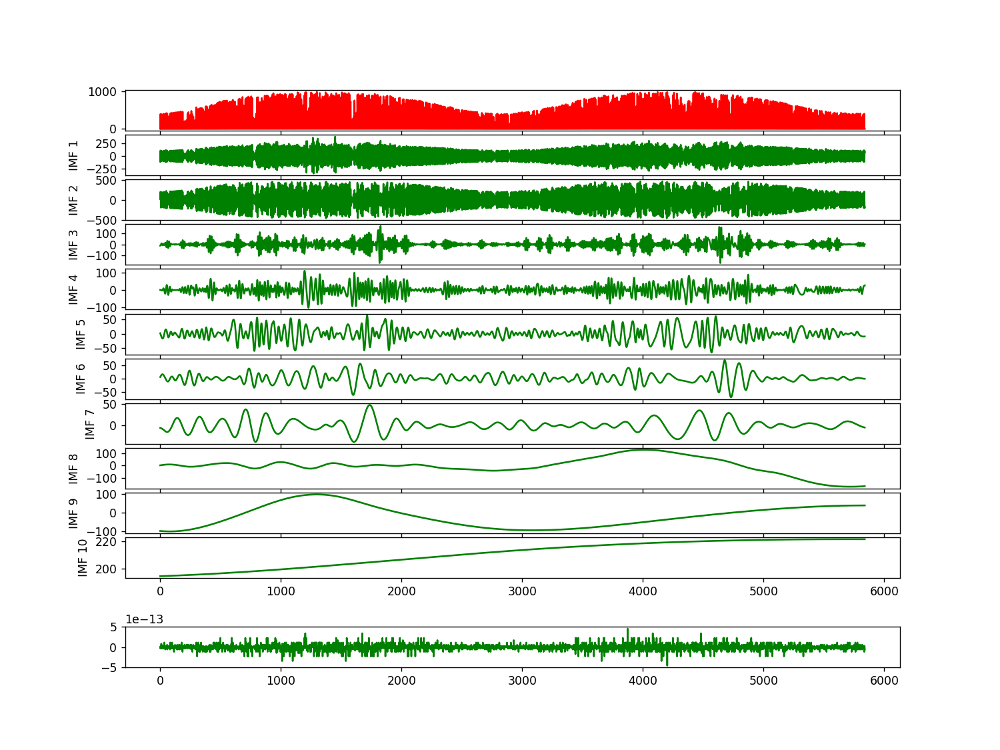

<IPython.core.display.Javascript object>


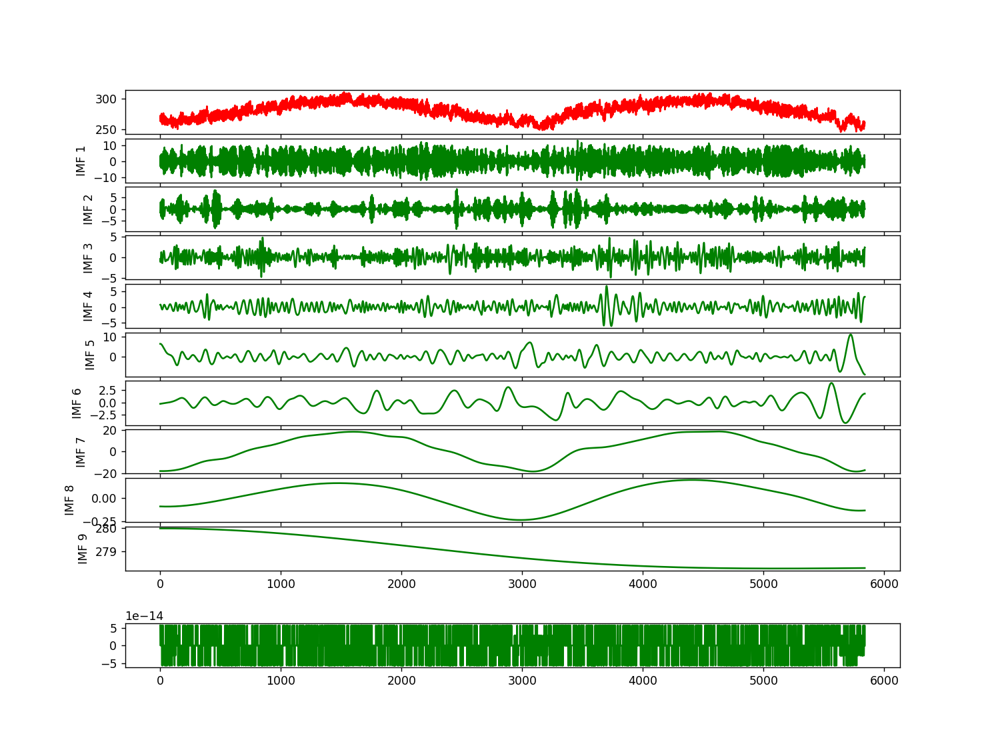

<IPython.core.display.Javascript object>


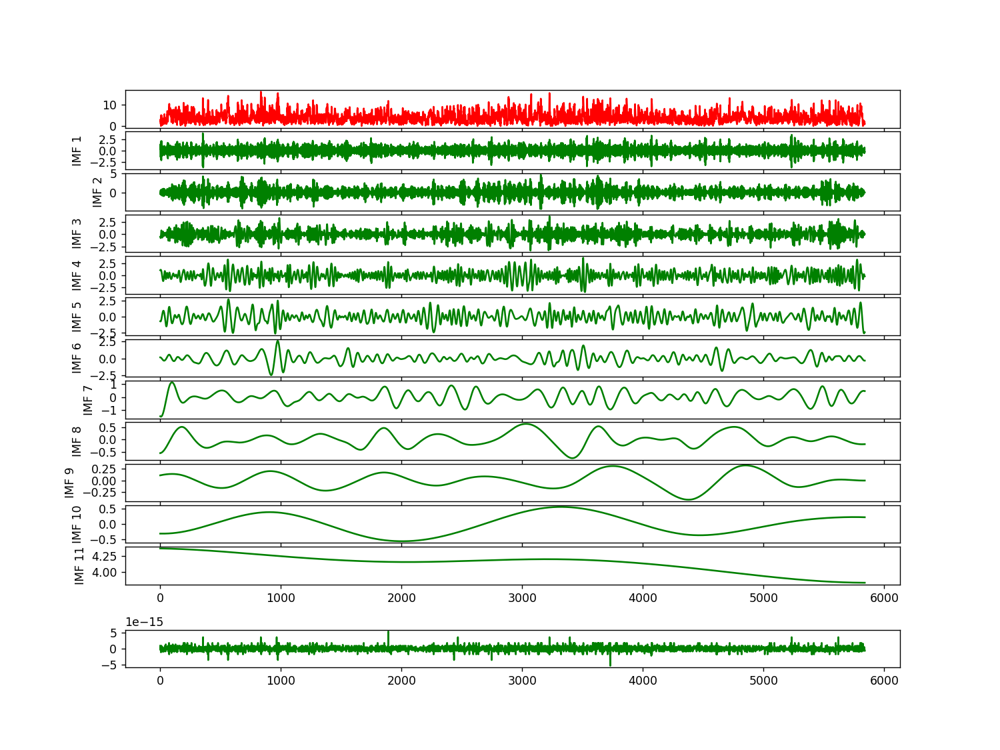

In [7]:
for item in ["lrad", "prec", "pres", "srad", "temp", "wind"]:
    res=ceemdan_decompose_res(data[item].to_numpy().ravel())
    IImfs.append(res)
for item in ["lrad", "prec", "pres", "srad", "temp", "wind"]:
    IImfs.append(data[item].to_numpy().ravel())

<IPython.core.display.Javascript object>


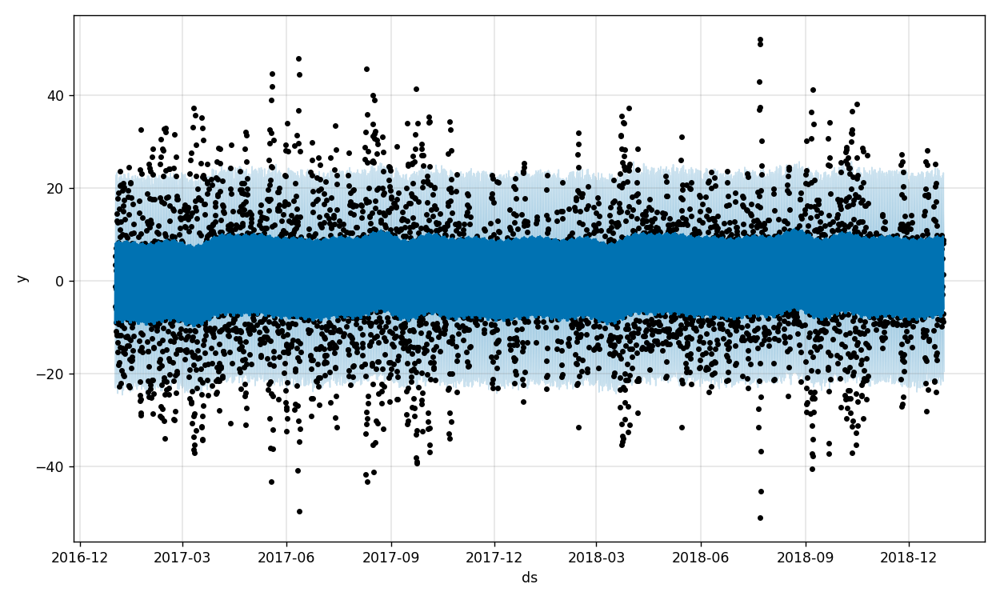

         trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
5835  0.238867   -4.986210   23.310404     0.238867     0.238867   
5836  0.238953  -11.775914   15.128584     0.238953     0.238953   
5837  0.239039  -15.882363   13.135296     0.239039     0.239039   
5838  0.239125  -17.834707   10.987013     0.239125     0.239125   
5839  0.239211  -19.488041    8.013841     0.239211     0.239211   

      additive_terms  additive_terms_lower  additive_terms_upper     daily  \
5835        9.307132              9.307132              9.307132  9.130113   
5836        1.905621              1.905621              1.905621  1.762917   
5837       -1.055852             -1.055852             -1.055852 -1.166908   
5838       -3.483533             -3.483533             -3.483533 -3.571803   
5839       -6.189017             -6.189017             -6.189017 -6.268123   

      daily_lower  daily_upper    yearly  yearly_lower  yearly_upper      yhat  
5835     9.130113     9.130113  0.006625 

<IPython.core.display.Javascript object>


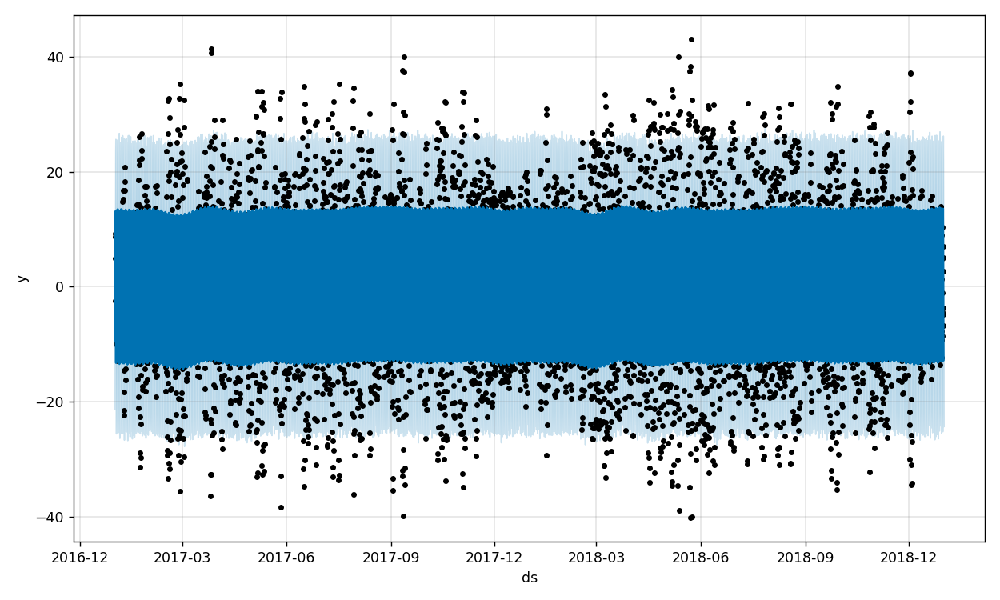

         trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
5835  0.052165    0.184463   26.257388     0.052165     0.052165   
5836  0.052164   -3.407400   21.675555     0.052164     0.052164   
5837  0.052162  -12.007015   12.005085     0.052162     0.052162   
5838  0.052161  -21.864181    3.226555     0.052161     0.052161   
5839  0.052160  -24.303492   -0.964707     0.052160     0.052160   

      additive_terms  additive_terms_lower  additive_terms_upper      daily  \
5835       13.509805             13.509805             13.509805  13.302359   
5836        8.481637              8.481637              8.481637   8.242926   
5837       -0.568300             -0.568300             -0.568300  -0.838105   
5838       -9.114977             -9.114977             -9.114977  -9.414917   
5839      -12.816800            -12.816800            -12.816800 -13.144928   

      daily_lower  daily_upper    yearly  yearly_lower  yearly_upper  \
5835    13.302359    13.302359  0.205728    

<IPython.core.display.Javascript object>


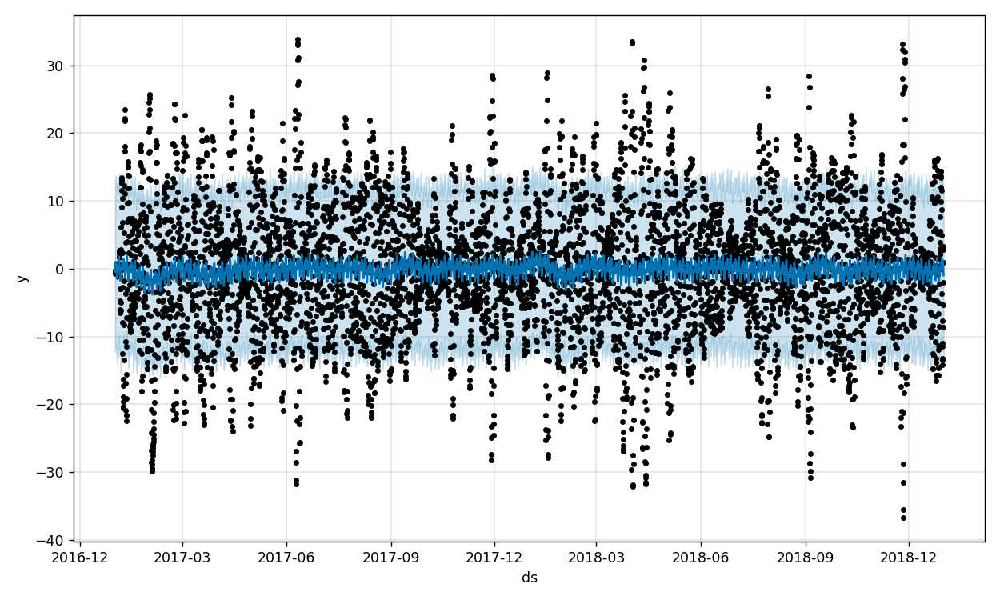

         trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
5835 -0.133515  -11.775011   13.231251    -0.133515    -0.133515   
5836 -0.133537  -10.519614   12.619965    -0.133537    -0.133537   
5837 -0.133559  -11.303388   12.373412    -0.133559    -0.133559   
5838 -0.133581  -12.137968   11.747255    -0.133581    -0.133581   
5839 -0.133603  -13.369701   10.892680    -0.133603    -0.133603   

      additive_terms  additive_terms_lower  additive_terms_upper     daily  \
5835        1.268387              1.268387              1.268387  0.554921   
5836        0.889703              0.889703              0.889703  0.456422   
5837        0.246348              0.246348              0.246348  0.094142   
5838       -0.412156             -0.412156             -0.412156 -0.310150   
5839       -0.835726             -0.835726             -0.835726 -0.532920   

      daily_lower  daily_upper    yearly  yearly_lower  yearly_upper      yhat  
5835     0.554921     0.554921  0.474851 

<IPython.core.display.Javascript object>


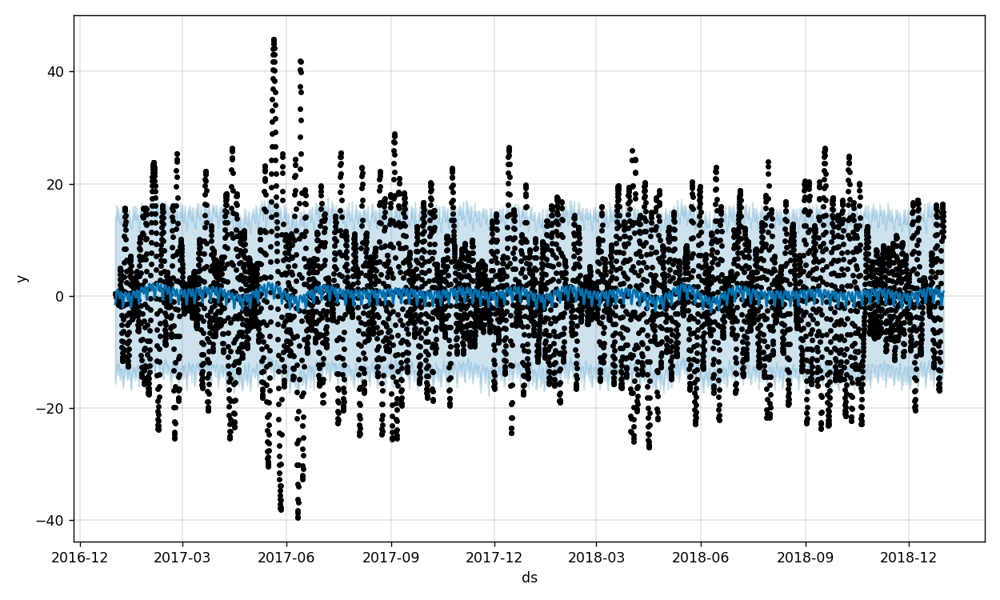

         trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
5835 -0.055229  -13.287896   13.546233    -0.055229    -0.055229   
5836 -0.055293  -12.474504   13.845893    -0.055293    -0.055293   
5837 -0.055356  -12.947995   13.925472    -0.055356    -0.055356   
5838 -0.055420  -12.665023   15.810896    -0.055420    -0.055420   
5839 -0.055483  -12.675478   15.811459    -0.055483    -0.055483   

      additive_terms  additive_terms_lower  additive_terms_upper     daily  \
5835        0.591134              0.591134              0.591134  0.015260   
5836        0.701383              0.701383              0.701383  0.014885   
5837        0.767056              0.767056              0.767056  0.006024   
5838        0.800819              0.800819              0.800819 -0.004442   
5839        0.815310              0.815310              0.815310 -0.010605   

      daily_lower  daily_upper    yearly  yearly_lower  yearly_upper      yhat  
5835     0.015260     0.015260 -0.025355 

<IPython.core.display.Javascript object>


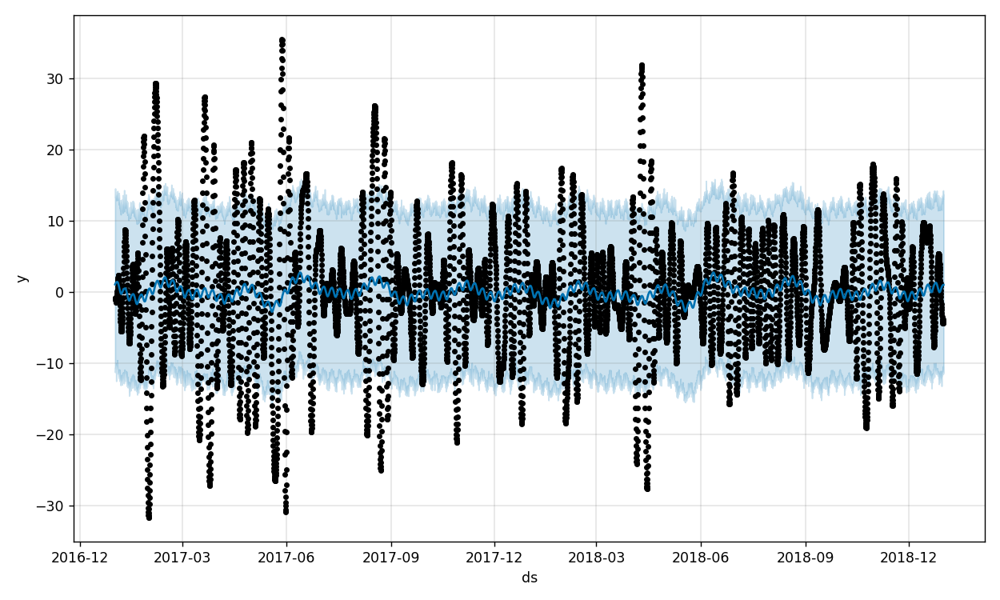

         trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
5835 -0.044002  -10.473503   14.165263    -0.044002    -0.044002   
5836 -0.043995  -11.518625   14.270657    -0.043995    -0.043995   
5837 -0.043989  -11.195838   13.942572    -0.043989    -0.043989   
5838 -0.043982  -11.286552   13.117106    -0.043982    -0.043982   
5839 -0.043976  -10.942958   13.699110    -0.043976    -0.043976   

      additive_terms  additive_terms_lower  additive_terms_upper     daily  \
5835        1.018691              1.018691              1.018691  0.000945   
5836        1.033021              1.033021              1.033021  0.000514   
5837        1.043738              1.043738              1.043738 -0.000022   
5838        1.049524              1.049524              1.049524 -0.001310   
5839        1.050758              1.050758              1.050758 -0.002173   

      daily_lower  daily_upper    yearly  yearly_lower  yearly_upper      yhat  
5835     0.000945     0.000945  0.512331 

<IPython.core.display.Javascript object>


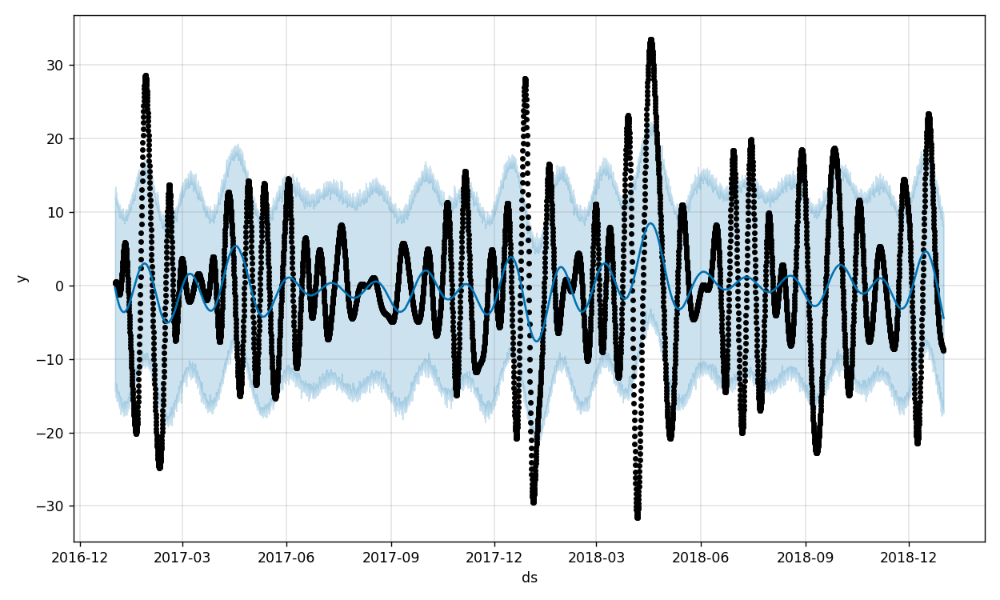

         trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
5835  0.541611  -16.555336    8.091056     0.541611     0.541611   
5836  0.541879  -17.213823    9.752546     0.541879     0.541879   
5837  0.542147  -17.170378    8.985395     0.542147     0.542147   
5838  0.542416  -17.311663    8.311883     0.542416     0.542416   
5839  0.542684  -16.698817    8.423157     0.542684     0.542684   

      additive_terms  additive_terms_lower  additive_terms_upper     daily  \
5835       -4.624949             -4.624949             -4.624949  0.000403   
5836       -4.712624             -4.712624             -4.712624 -0.000353   
5837       -4.799141             -4.799141             -4.799141 -0.001290   
5838       -4.884214             -4.884214             -4.884214 -0.002063   
5839       -4.968297             -4.968297             -4.968297 -0.003024   

      daily_lower  daily_upper    yearly  yearly_lower  yearly_upper      yhat  
5835     0.000403     0.000403 -4.627814 

<IPython.core.display.Javascript object>


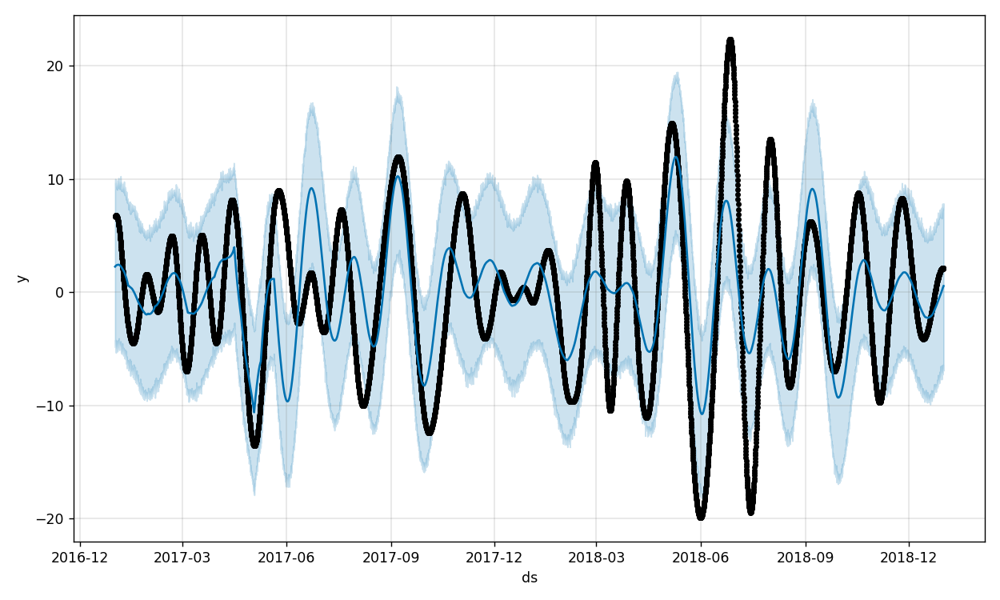

         trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
5835 -0.887195   -6.399586    7.268044    -0.887195    -0.887195   
5836 -0.887566   -6.766777    7.399760    -0.887566    -0.887566   
5837 -0.887937   -6.938829    7.448278    -0.887937    -0.887937   
5838 -0.888308   -6.892256    7.497185    -0.888308    -0.888308   
5839 -0.888679   -6.340985    7.830949    -0.888679    -0.888679   

      additive_terms  additive_terms_lower  additive_terms_upper     daily  \
5835        1.310376              1.310376              1.310376  0.000697   
5836        1.342473              1.342473              1.342473  0.000344   
5837        1.373611              1.373611              1.373611 -0.000477   
5838        1.404438              1.404438              1.404438 -0.001302   
5839        1.435053              1.435053              1.435053 -0.002194   

      daily_lower  daily_upper    yearly  yearly_lower  yearly_upper      yhat  
5835     0.000697     0.000697  1.294260 

<IPython.core.display.Javascript object>


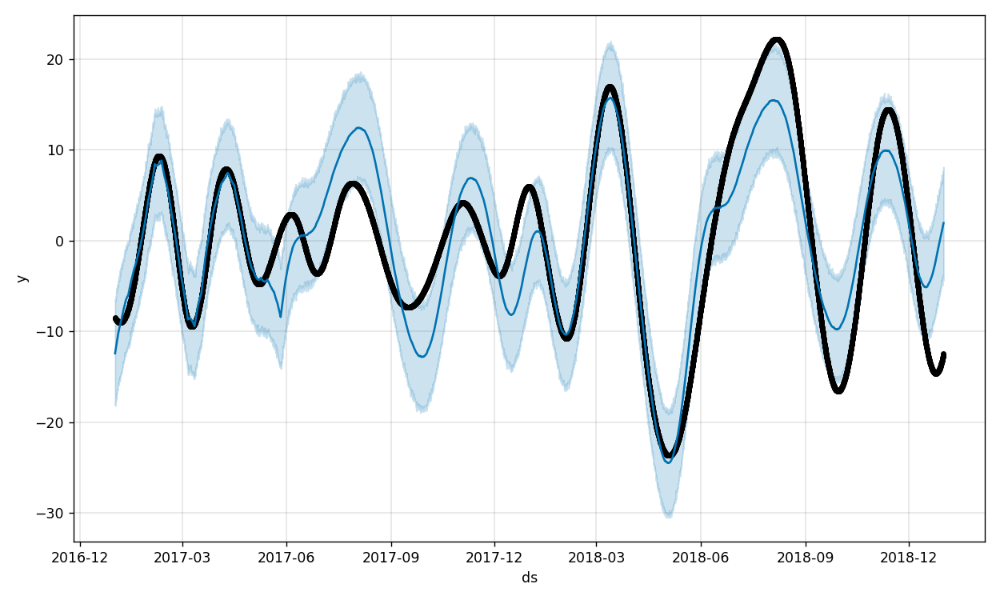

         trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
5835  1.733897   -3.820779    7.661390     1.733897     1.733897   
5836  1.734945   -3.978937    7.727478     1.734945     1.734945   
5837  1.735993   -4.403747    7.498834     1.735993     1.735993   
5838  1.737041   -3.893380    8.120012     1.737041     1.737041   
5839  1.738089   -3.779912    8.121992     1.738089     1.738089   

      additive_terms  additive_terms_lower  additive_terms_upper     daily  \
5835       -0.090974             -0.090974             -0.090974  0.001441   
5836       -0.019694             -0.019694             -0.019694 -0.001705   
5837        0.053916              0.053916              0.053916 -0.004658   
5838        0.129023              0.129023              0.129023 -0.007796   
5839        0.205345              0.205345              0.205345 -0.010728   

      daily_lower  daily_upper    yearly  yearly_lower  yearly_upper      yhat  
5835     0.001441     0.001441 -0.043309 

<IPython.core.display.Javascript object>


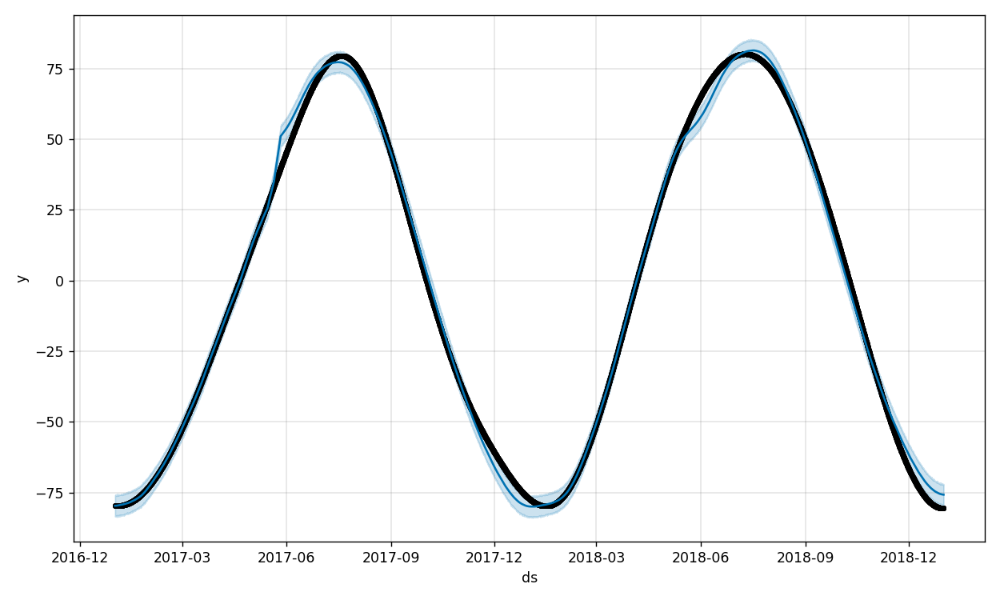

         trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
5835  2.789330  -79.281402  -72.052157     2.789330     2.789330   
5836  2.790748  -79.705313  -72.454342     2.790748     2.790748   
5837  2.792166  -79.500917  -72.099708     2.792166     2.792166   
5838  2.793584  -79.431520  -72.049193     2.793584     2.793584   
5839  2.795002  -79.490625  -72.178243     2.795002     2.795002   

      additive_terms  additive_terms_lower  additive_terms_upper     daily  \
5835      -78.575045            -78.575045            -78.575045  0.000600   
5836      -78.582938            -78.582938            -78.582938 -0.000363   
5837      -78.589627            -78.589627            -78.589627 -0.001287   
5838      -78.595401            -78.595401            -78.595401 -0.002264   
5839      -78.600409            -78.600409            -78.600409 -0.003187   

      daily_lower  daily_upper     yearly  yearly_lower  yearly_upper  \
5835     0.000600     0.000600 -78.566619    -78.

<IPython.core.display.Javascript object>


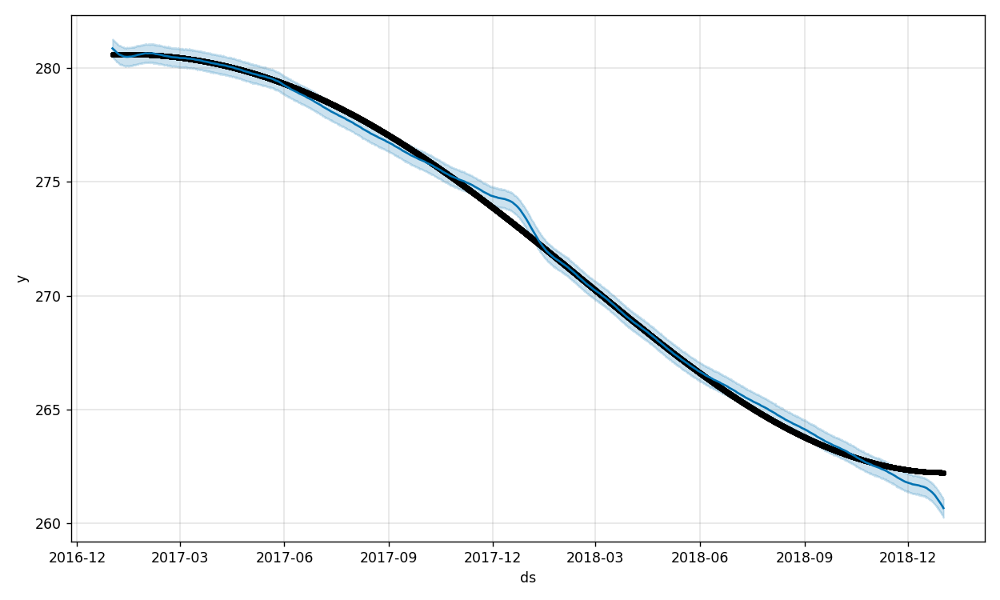

           trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
5835  259.899701  260.278902  261.145022   259.899701   259.899701   
5836  259.895385  260.293567  261.093933   259.895385   259.895385   
5837  259.891068  260.250590  261.044922   259.891068   259.891068   
5838  259.886752  260.232906  261.067443   259.886752   259.886752   
5839  259.882436  260.257528  261.058452   259.882436   259.882436   

      additive_terms  additive_terms_lower  additive_terms_upper     daily  \
5835        0.805084              0.805084              0.805084 -0.000157   
5836        0.798301              0.798301              0.798301  0.000148   
5837        0.791218              0.791218              0.791218  0.000478   
5838        0.783838              0.783838              0.783838  0.000785   
5839        0.776280              0.776280              0.776280  0.001116   

      daily_lower  daily_upper    yearly  yearly_lower  yearly_upper  \
5835    -0.000157    -0.000157  0.7999

<IPython.core.display.Javascript object>


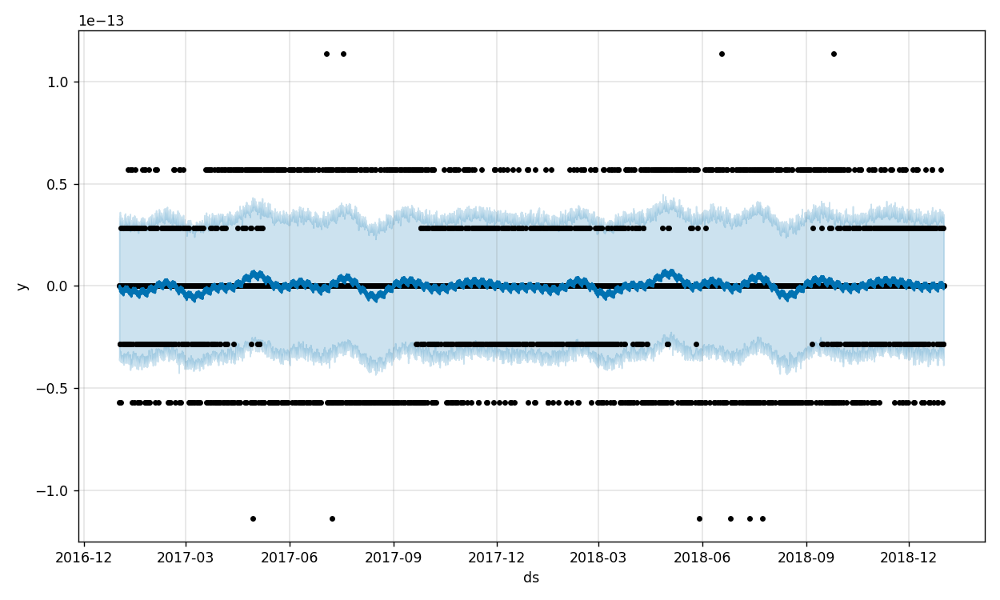

             trend    yhat_lower    yhat_upper   trend_lower   trend_upper  \
5835  6.383153e-16 -3.327620e-14  3.522376e-14  6.383153e-16  6.383153e-16   
5836  6.384831e-16 -3.870197e-14  3.050971e-14  6.384831e-16  6.384831e-16   
5837  6.386510e-16 -3.144190e-14  3.477120e-14  6.386510e-16  6.386510e-16   
5838  6.388189e-16 -3.542617e-14  3.237067e-14  6.388189e-16  6.388189e-16   
5839  6.389868e-16 -3.494686e-14  3.398025e-14  6.389868e-16  6.389868e-16   

      additive_terms  additive_terms_lower  additive_terms_upper  \
5835    4.866465e-16          4.866465e-16          4.866465e-16   
5836   -1.401046e-15         -1.401046e-15         -1.401046e-15   
5837    1.531786e-16          1.531786e-16          1.531786e-16   
5838   -2.321447e-15         -2.321447e-15         -2.321447e-15   
5839   -1.871157e-15         -1.871157e-15         -1.871157e-15   

             daily   daily_lower   daily_upper        yearly  yearly_lower  \
5835  1.336487e-15  1.336487e-15  1.336487e-

<IPython.core.display.Javascript object>


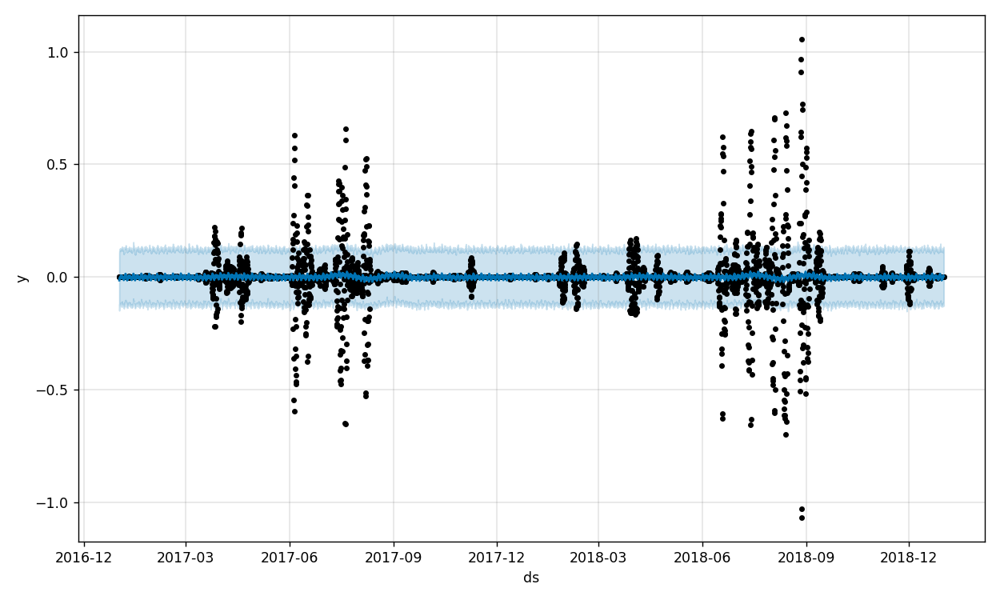

         trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
5835  0.000799   -0.118847    0.120269     0.000799     0.000799   
5836  0.000799   -0.115170    0.126819     0.000799     0.000799   
5837  0.000799   -0.116399    0.133708     0.000799     0.000799   
5838  0.000799   -0.111836    0.129151     0.000799     0.000799   
5839  0.000799   -0.128427    0.120901     0.000799     0.000799   

      additive_terms  additive_terms_lower  additive_terms_upper     daily  \
5835        0.004541              0.004541              0.004541  0.002516   
5836        0.005991              0.005991              0.005991  0.003706   
5837        0.005069              0.005069              0.005069  0.002799   
5838        0.003222              0.003222              0.003222  0.001173   
5839        0.001960              0.001960              0.001960  0.000256   

      daily_lower  daily_upper    yearly  yearly_lower  yearly_upper      yhat  
5835     0.002516     0.002516 -0.001159 

<IPython.core.display.Javascript object>


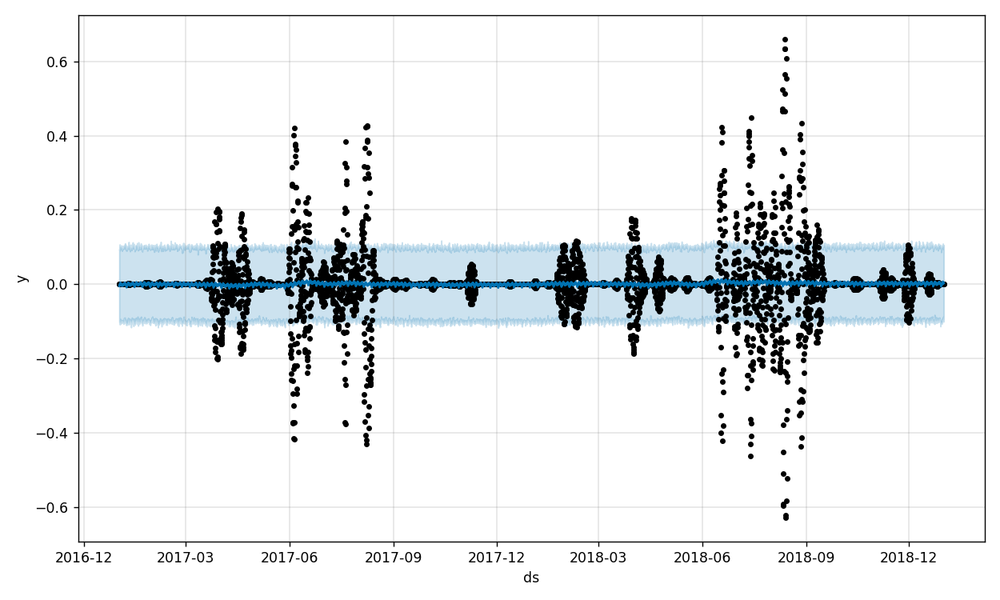

         trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
5835  0.003164   -0.088297    0.103397     0.003164     0.003164   
5836  0.003165   -0.097985    0.104070     0.003165     0.003165   
5837  0.003166   -0.101250    0.094808     0.003166     0.003166   
5838  0.003167   -0.096930    0.104638     0.003167     0.003167   
5839  0.003168   -0.095483    0.105551     0.003168     0.003168   

      additive_terms  additive_terms_lower  additive_terms_upper     daily  \
5835        0.000553              0.000553              0.000553 -0.001103   
5836       -0.001563             -0.001563             -0.001563 -0.002653   
5837       -0.000348             -0.000348             -0.000348 -0.000754   
5838        0.001192              0.001192              0.001192  0.001519   
5839       -0.000579             -0.000579             -0.000579  0.000466   

      daily_lower  daily_upper    yearly  yearly_lower  yearly_upper      yhat  
5835    -0.001103    -0.001103 -0.001513 

<IPython.core.display.Javascript object>


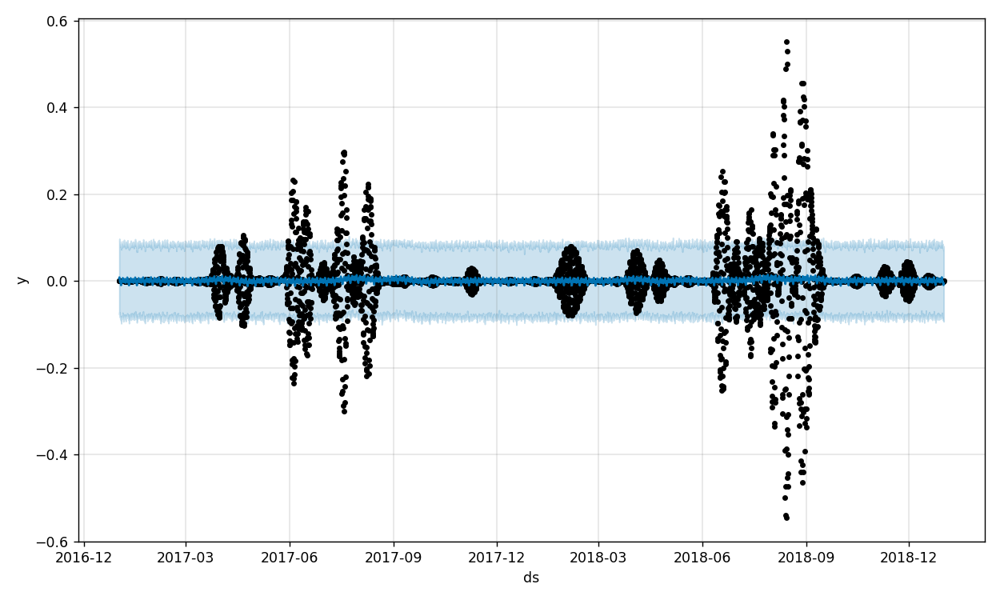

         trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
5835  0.001641   -0.091329    0.072658     0.001641     0.001641   
5836  0.001641   -0.090941    0.073045     0.001641     0.001641   
5837  0.001641   -0.091850    0.070880     0.001641     0.001641   
5838  0.001642   -0.092883    0.075282     0.001642     0.001642   
5839  0.001642   -0.093118    0.080516     0.001642     0.001642   

      additive_terms  additive_terms_lower  additive_terms_upper     daily  \
5835       -0.007154             -0.007154             -0.007154  0.000408   
5836       -0.009922             -0.009922             -0.009922 -0.002055   
5837       -0.010885             -0.010885             -0.010885 -0.003158   
5838       -0.010045             -0.010045             -0.010045 -0.002881   
5839       -0.007253             -0.007253             -0.007253 -0.001019   

      daily_lower  daily_upper    yearly  yearly_lower  yearly_upper      yhat  
5835     0.000408     0.000408 -0.000908 

C:\Users\j8843\anaconda3\lib\site-packages\prophet\plot.py:66: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure(facecolor='w', figsize=figsize)


<IPython.core.display.Javascript object>


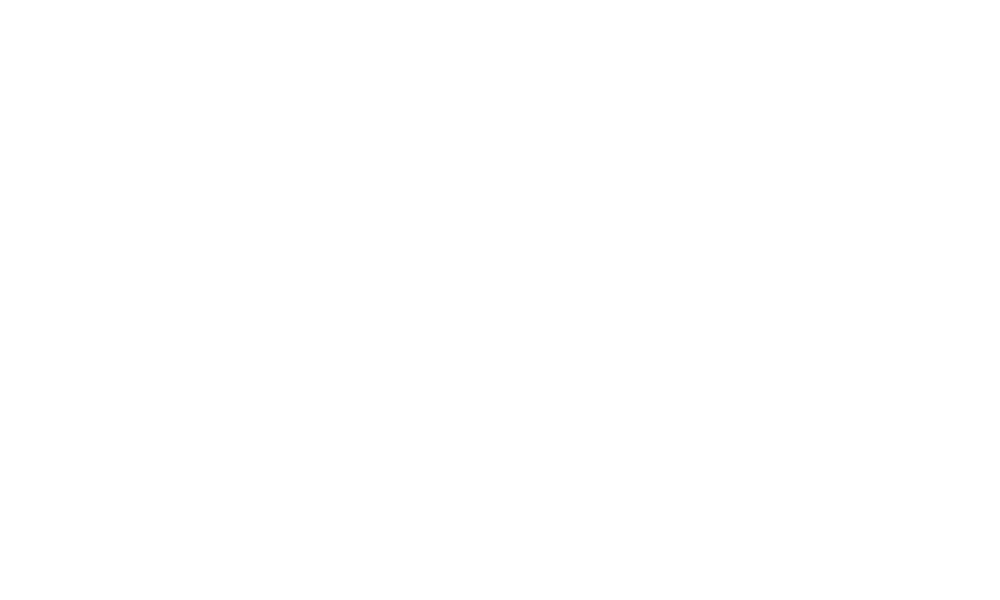

         trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
5835  0.001563   -0.060188    0.065798     0.001563     0.001563   
5836  0.001563   -0.061988    0.060209     0.001563     0.001563   
5837  0.001564   -0.064101    0.060538     0.001564     0.001564   
5838  0.001564   -0.060019    0.065429     0.001564     0.001564   
5839  0.001564   -0.064891    0.064116     0.001564     0.001564   

      additive_terms  additive_terms_lower  additive_terms_upper     daily  \
5835       -0.001366             -0.001366             -0.001366  0.000264   
5836       -0.001379             -0.001379             -0.001379  0.000114   
5837       -0.001313             -0.001313             -0.001313 -0.000167   
5838       -0.001051             -0.001051             -0.001051 -0.000364   
5839       -0.000488             -0.000488             -0.000488 -0.000260   

      daily_lower  daily_upper    yearly  yearly_lower  yearly_upper      yhat  
5835     0.000264     0.000264 -0.000409 

<IPython.core.display.Javascript object>


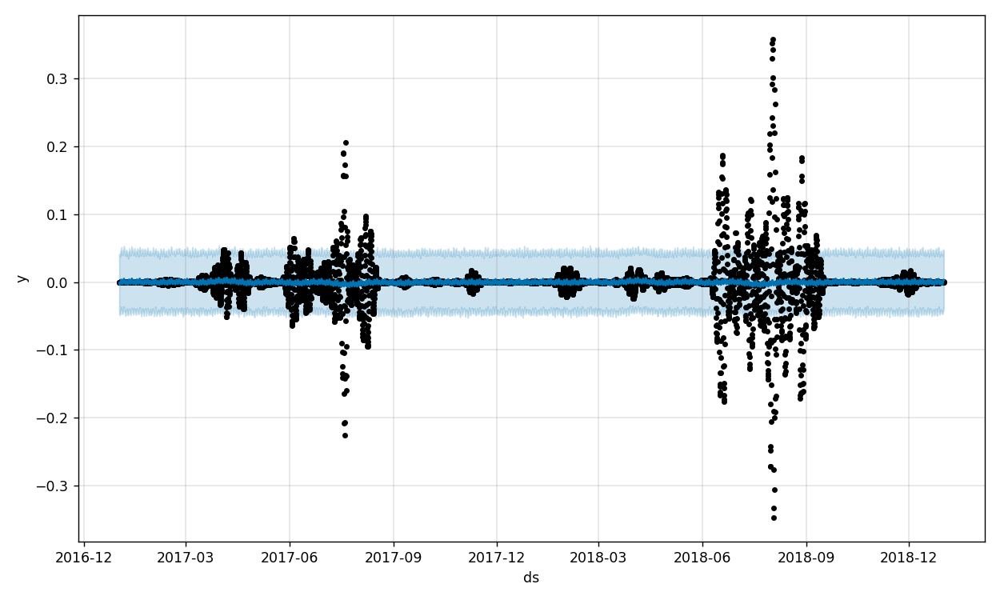

         trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
5835 -0.000096   -0.043517    0.048238    -0.000096    -0.000096   
5836 -0.000096   -0.038191    0.045393    -0.000096    -0.000096   
5837 -0.000096   -0.037748    0.045293    -0.000096    -0.000096   
5838 -0.000096   -0.038272    0.047238    -0.000096    -0.000096   
5839 -0.000096   -0.040829    0.046300    -0.000096    -0.000096   

      additive_terms  additive_terms_lower  additive_terms_upper     daily  \
5835        0.002212              0.002212              0.002212  0.000179   
5836        0.002938              0.002938              0.002938 -0.000004   
5837        0.003373              0.003373              0.003373 -0.000166   
5838        0.003546              0.003546              0.003546 -0.000218   
5839        0.003437              0.003437              0.003437 -0.000161   

      daily_lower  daily_upper    yearly  yearly_lower  yearly_upper      yhat  
5835     0.000179     0.000179  0.000069 

<IPython.core.display.Javascript object>


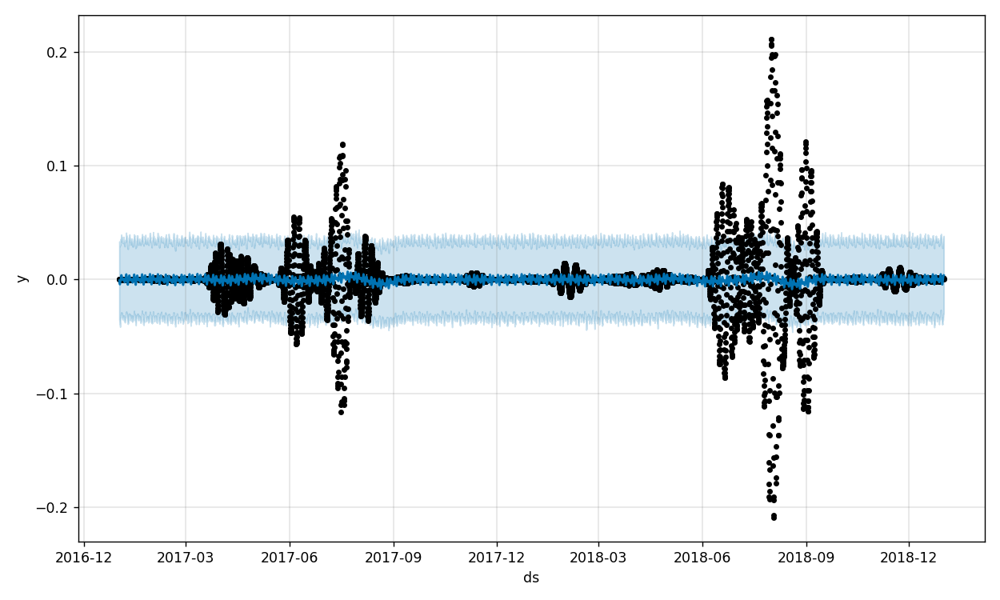

         trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
5835 -0.000384   -0.033399    0.036091    -0.000384    -0.000384   
5836 -0.000384   -0.032793    0.037891    -0.000384    -0.000384   
5837 -0.000384   -0.030102    0.036344    -0.000384    -0.000384   
5838 -0.000384   -0.030279    0.038201    -0.000384    -0.000384   
5839 -0.000384   -0.029584    0.037182    -0.000384    -0.000384   

      additive_terms  additive_terms_lower  additive_terms_upper     daily  \
5835        0.001716              0.001716              0.001716 -0.000015   
5836        0.002630              0.002630              0.002630 -0.000087   
5837        0.003343              0.003343              0.003343 -0.000111   
5838        0.003816              0.003816              0.003816 -0.000076   
5839        0.004015              0.004015              0.004015  0.000002   

      daily_lower  daily_upper    yearly  yearly_lower  yearly_upper      yhat  
5835    -0.000015    -0.000015  0.000513 

<IPython.core.display.Javascript object>


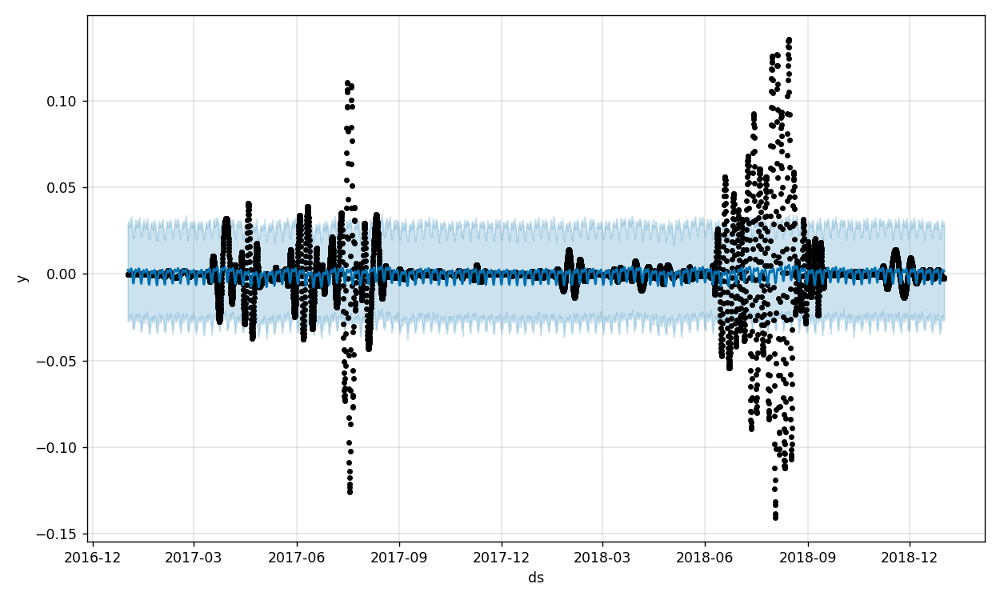

         trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
5835  0.000426   -0.023346    0.027488     0.000426     0.000426   
5836  0.000427   -0.024589    0.030343     0.000427     0.000427   
5837  0.000427   -0.027285    0.028164     0.000427     0.000427   
5838  0.000427   -0.025031    0.028476     0.000427     0.000427   
5839  0.000427   -0.025772    0.027986     0.000427     0.000427   

      additive_terms  additive_terms_lower  additive_terms_upper     daily  \
5835        0.000923              0.000923              0.000923  0.000004   
5836        0.000974              0.000974              0.000974  0.000012   
5837        0.001058              0.001058              0.001058  0.000009   
5838        0.001182              0.001182              0.001182  0.000005   
5839        0.001333              0.001333              0.001333 -0.000007   

      daily_lower  daily_upper    yearly  yearly_lower  yearly_upper      yhat  
5835     0.000004     0.000004 -0.000072 

<IPython.core.display.Javascript object>


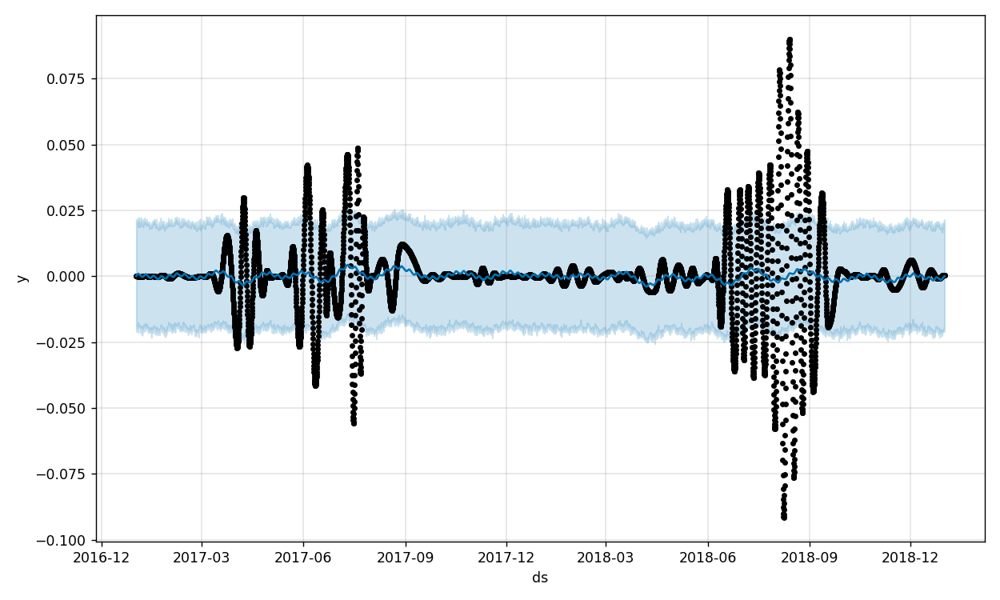

         trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
5835 -0.000934   -0.019666    0.020639    -0.000934    -0.000934   
5836 -0.000935   -0.019963    0.021536    -0.000935    -0.000935   
5837 -0.000935   -0.020929    0.020101    -0.000935    -0.000935   
5838 -0.000935   -0.020955    0.018966    -0.000935    -0.000935   
5839 -0.000936   -0.019668    0.021031    -0.000936    -0.000936   

      additive_terms  additive_terms_lower  additive_terms_upper  \
5835        0.000836              0.000836              0.000836   
5836        0.000870              0.000870              0.000870   
5837        0.000898              0.000898              0.000898   
5838        0.000912              0.000912              0.000912   
5839        0.000917              0.000917              0.000917   

             daily   daily_lower   daily_upper    yearly  yearly_lower  \
5835  3.849491e-07  3.849491e-07  3.849491e-07  0.000275      0.000275   
5836 -1.301229e-06 -1.301229e-06 -

<IPython.core.display.Javascript object>


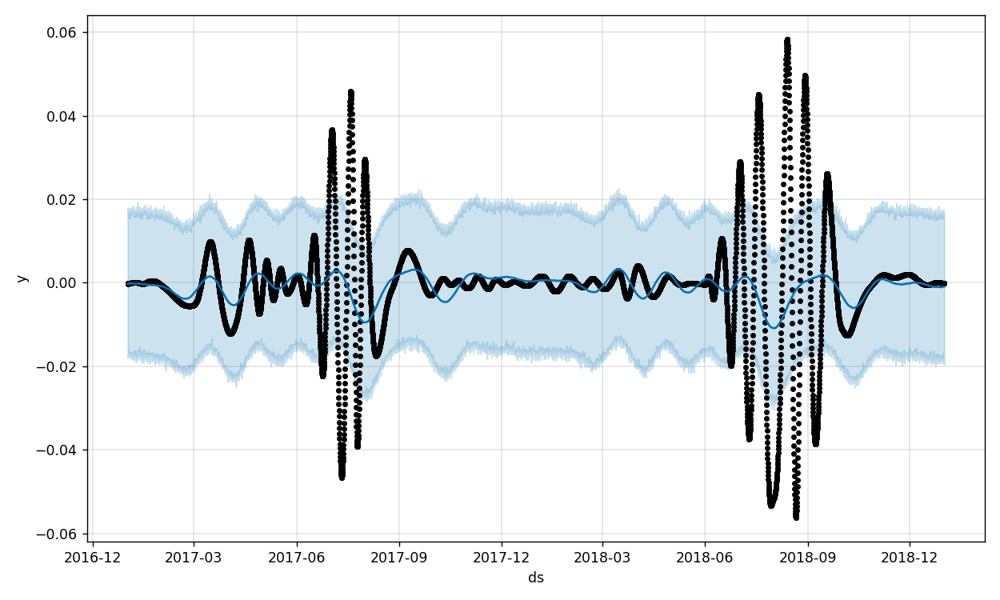

         trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
5835 -0.001796   -0.019495    0.015420    -0.001796    -0.001796   
5836 -0.001796   -0.017365    0.016971    -0.001796    -0.001796   
5837 -0.001797   -0.018162    0.015909    -0.001797    -0.001797   
5838 -0.001797   -0.018489    0.016518    -0.001797    -0.001797   
5839 -0.001798   -0.019681    0.015244    -0.001798    -0.001798   

      additive_terms  additive_terms_lower  additive_terms_upper  \
5835        0.000853              0.000853              0.000853   
5836        0.000859              0.000859              0.000859   
5837        0.000865              0.000865              0.000865   
5838        0.000870              0.000870              0.000870   
5839        0.000875              0.000875              0.000875   

             daily   daily_lower   daily_upper    yearly  yearly_lower  \
5835 -5.642348e-09 -5.642348e-09 -5.642348e-09  0.000830      0.000830   
5836 -1.029558e-08 -1.029558e-08 -

<IPython.core.display.Javascript object>


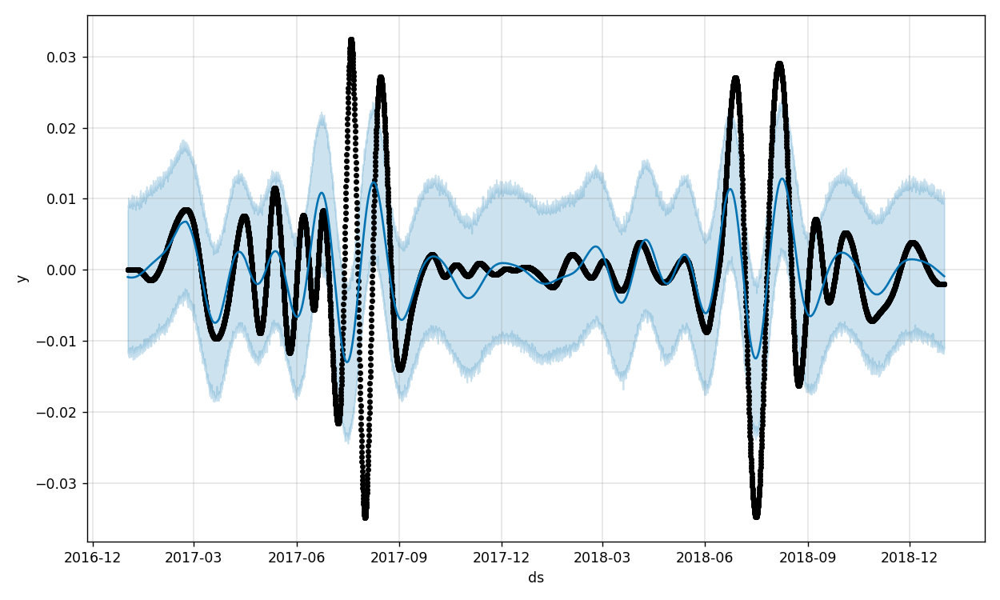

         trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
5835  0.000305   -0.011427    0.011002     0.000305     0.000305   
5836  0.000306   -0.011361    0.009784     0.000306     0.000306   
5837  0.000306   -0.011184    0.009896     0.000306     0.000306   
5838  0.000306   -0.010883    0.010204     0.000306     0.000306   
5839  0.000306   -0.011048    0.009308     0.000306     0.000306   

      additive_terms  additive_terms_lower  additive_terms_upper  \
5835       -0.001139             -0.001139             -0.001139   
5836       -0.001155             -0.001155             -0.001155   
5837       -0.001171             -0.001171             -0.001171   
5838       -0.001186             -0.001186             -0.001186   
5839       -0.001201             -0.001201             -0.001201   

             daily   daily_lower   daily_upper    yearly  yearly_lower  \
5835  1.050626e-07  1.050626e-07  1.050626e-07 -0.001133     -0.001133   
5836 -1.548774e-07 -1.548774e-07 -

<IPython.core.display.Javascript object>


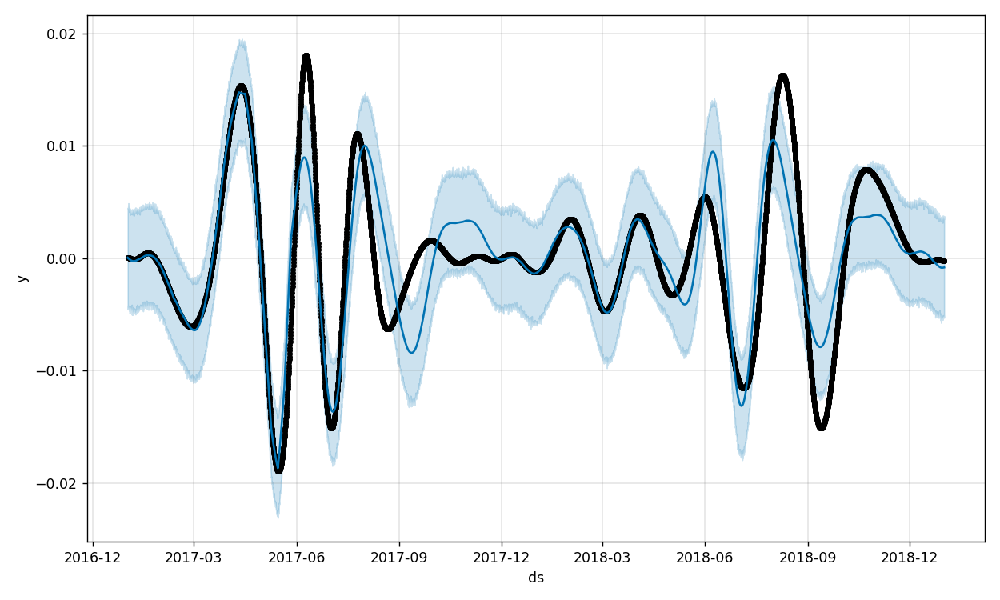

         trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
5835  0.000526   -0.005179    0.003453     0.000526     0.000526   
5836  0.000527   -0.005053    0.003741     0.000527     0.000527   
5837  0.000527   -0.005167    0.003524     0.000527     0.000527   
5838  0.000527   -0.005292    0.003492     0.000527     0.000527   
5839  0.000527   -0.005143    0.003756     0.000527     0.000527   

      additive_terms  additive_terms_lower  additive_terms_upper  \
5835       -0.001346             -0.001346             -0.001346   
5836       -0.001344             -0.001344             -0.001344   
5837       -0.001341             -0.001341             -0.001341   
5838       -0.001338             -0.001338             -0.001338   
5839       -0.001335             -0.001335             -0.001335   

             daily   daily_lower   daily_upper    yearly  yearly_lower  \
5835  1.032215e-07  1.032215e-07  1.032215e-07 -0.001358     -0.001358   
5836  2.517682e-07  2.517682e-07  

<IPython.core.display.Javascript object>


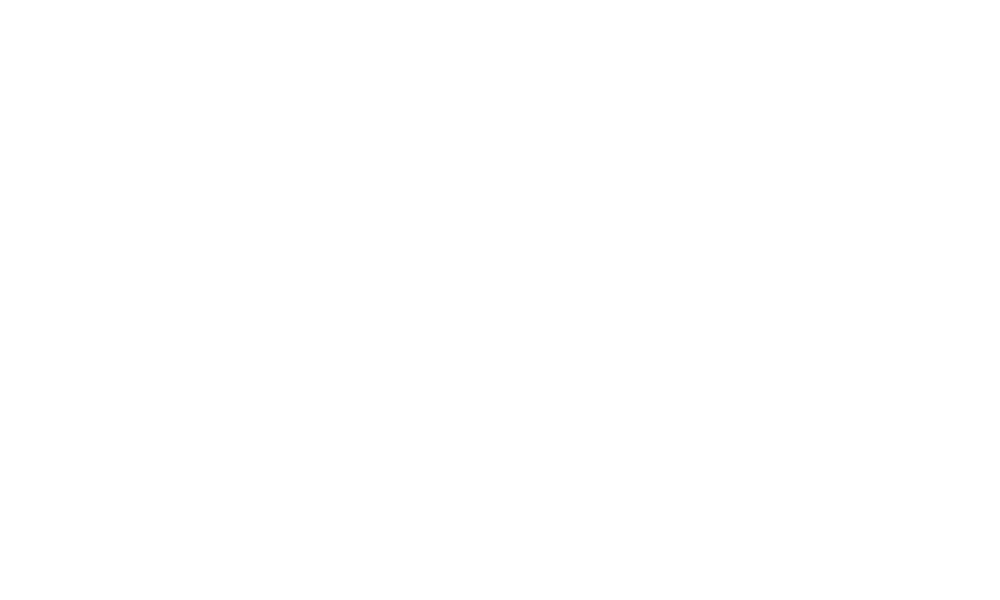

         trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
5835 -0.005570   -0.010604   -0.002267    -0.005570    -0.005570   
5836 -0.005572   -0.010770   -0.002171    -0.005572    -0.005572   
5837 -0.005574   -0.010878   -0.002317    -0.005574    -0.005574   
5838 -0.005576   -0.010865   -0.002493    -0.005576    -0.005576   
5839 -0.005578   -0.010798   -0.002384    -0.005578    -0.005578   

      additive_terms  additive_terms_lower  additive_terms_upper  \
5835       -0.000993             -0.000993             -0.000993   
5836       -0.000964             -0.000964             -0.000964   
5837       -0.000935             -0.000935             -0.000935   
5838       -0.000906             -0.000906             -0.000906   
5839       -0.000875             -0.000875             -0.000875   

             daily   daily_lower   daily_upper    yearly  yearly_lower  \
5835  4.903886e-07  4.903886e-07  4.903886e-07 -0.000983     -0.000983   
5836 -4.668637e-07 -4.668637e-07 -

<IPython.core.display.Javascript object>


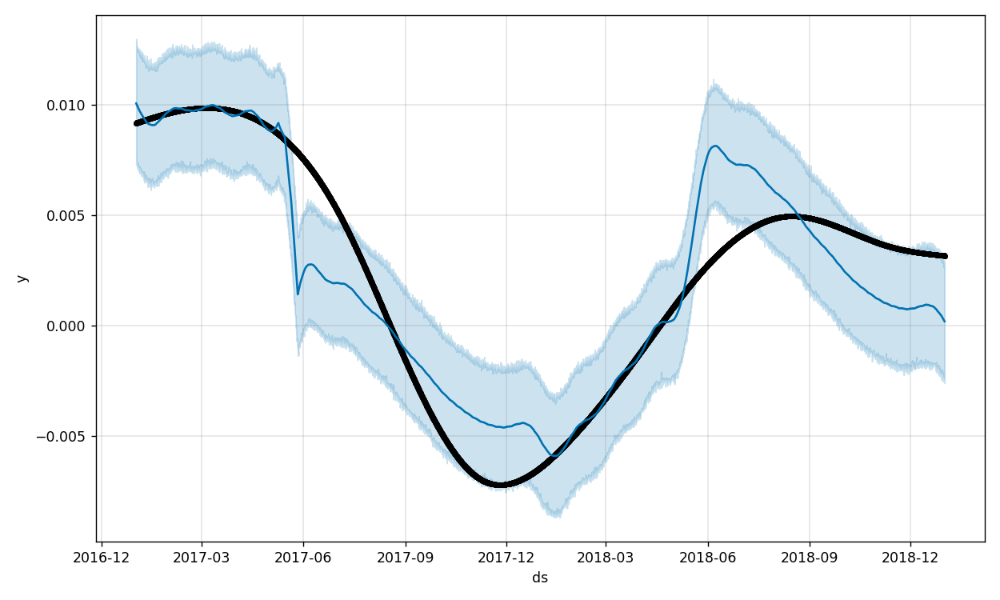

         trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
5835  0.004213   -0.002461    0.002757     0.004213     0.004213   
5836  0.004215   -0.002225    0.002855     0.004215     0.004215   
5837  0.004217   -0.002433    0.002950     0.004217     0.004217   
5838  0.004219   -0.002487    0.002804     0.004219     0.004219   
5839  0.004221   -0.002603    0.002859     0.004221     0.004221   

      additive_terms  additive_terms_lower  additive_terms_upper  \
5835       -0.003974             -0.003974             -0.003974   
5836       -0.003987             -0.003987             -0.003987   
5837       -0.004001             -0.004001             -0.004001   
5838       -0.004015             -0.004015             -0.004015   
5839       -0.004029             -0.004029             -0.004029   

             daily   daily_lower   daily_upper    yearly  yearly_lower  \
5835 -3.811067e-07 -3.811067e-07 -3.811067e-07 -0.003978     -0.003978   
5836  2.310659e-07  2.310659e-07  

<IPython.core.display.Javascript object>


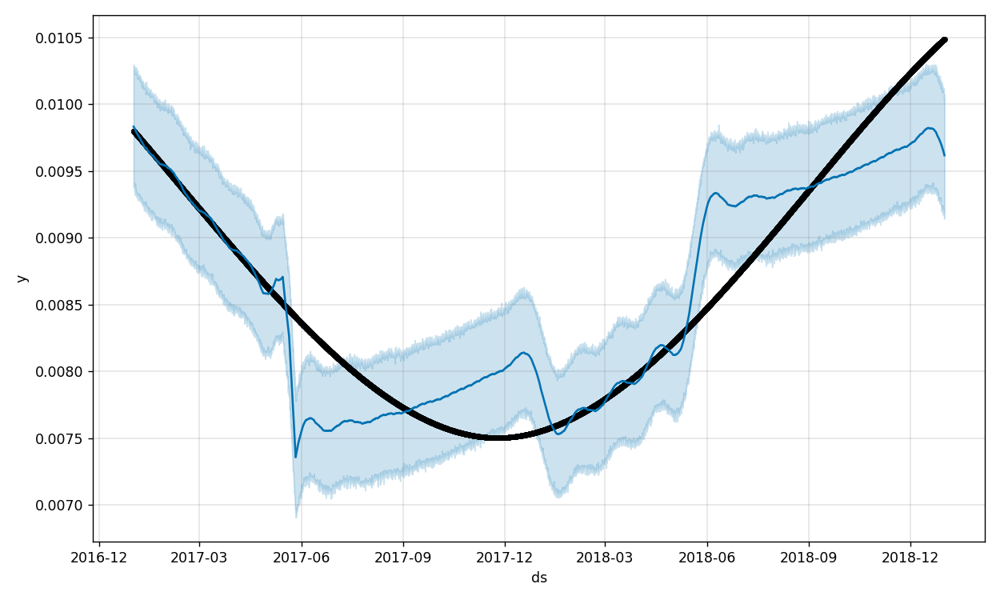

         trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
5835  0.009694    0.009188    0.010081     0.009694     0.009694   
5836  0.009694    0.009179    0.010080     0.009694     0.009694   
5837  0.009695    0.009144    0.010027     0.009695     0.009695   
5838  0.009695    0.009160    0.010073     0.009695     0.009695   
5839  0.009696    0.009185    0.010047     0.009696     0.009696   

      additive_terms  additive_terms_lower  additive_terms_upper  \
5835       -0.000059             -0.000059             -0.000059   
5836       -0.000064             -0.000064             -0.000064   
5837       -0.000069             -0.000069             -0.000069   
5838       -0.000074             -0.000074             -0.000074   
5839       -0.000078             -0.000078             -0.000078   

             daily   daily_lower   daily_upper    yearly  yearly_lower  \
5835 -9.739217e-08 -9.739217e-08 -9.739217e-08 -0.000062     -0.000062   
5836  6.080913e-08  6.080913e-08  

<IPython.core.display.Javascript object>


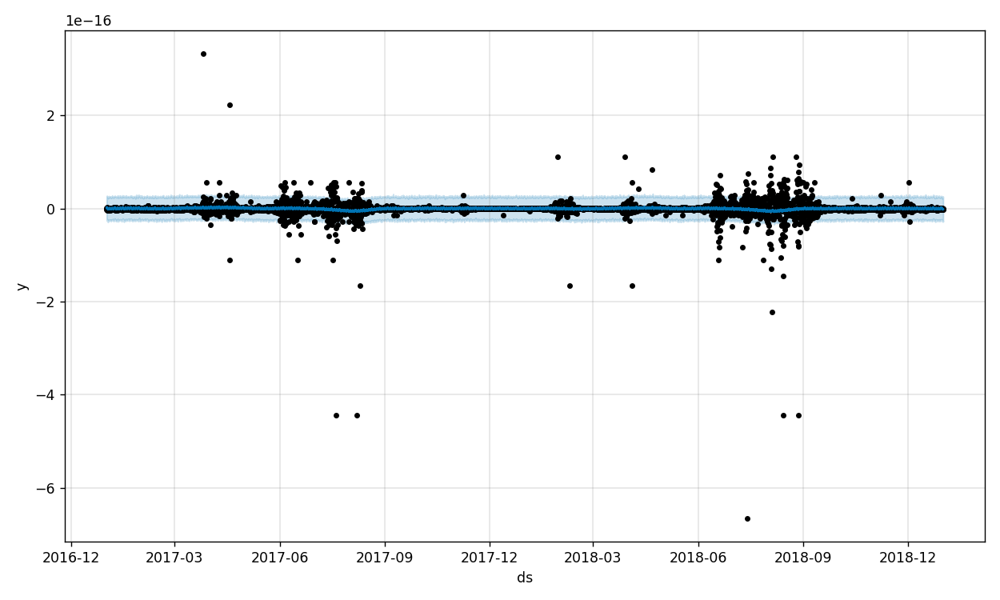

             trend    yhat_lower    yhat_upper   trend_lower   trend_upper  \
5835 -5.097044e-19 -2.664514e-17  2.342709e-17 -5.097044e-19 -5.097044e-19   
5836 -5.097370e-19 -2.603905e-17  2.578933e-17 -5.097370e-19 -5.097370e-19   
5837 -5.097696e-19 -2.850124e-17  2.253208e-17 -5.097696e-19 -5.097696e-19   
5838 -5.098022e-19 -2.606697e-17  2.453794e-17 -5.098022e-19 -5.098022e-19   
5839 -5.098349e-19 -2.824961e-17  2.524784e-17 -5.098349e-19 -5.098349e-19   

      additive_terms  additive_terms_lower  additive_terms_upper  \
5835   -8.821637e-19         -8.821637e-19         -8.821637e-19   
5836   -1.153104e-19         -1.153104e-19         -1.153104e-19   
5837   -1.462841e-18         -1.462841e-18         -1.462841e-18   
5838   -5.918348e-19         -5.918348e-19         -5.918348e-19   
5839   -8.910416e-19         -8.910416e-19         -8.910416e-19   

             daily   daily_lower   daily_upper        yearly  yearly_lower  \
5835  1.733082e-19  1.733082e-19  1.733082e-

<IPython.core.display.Javascript object>


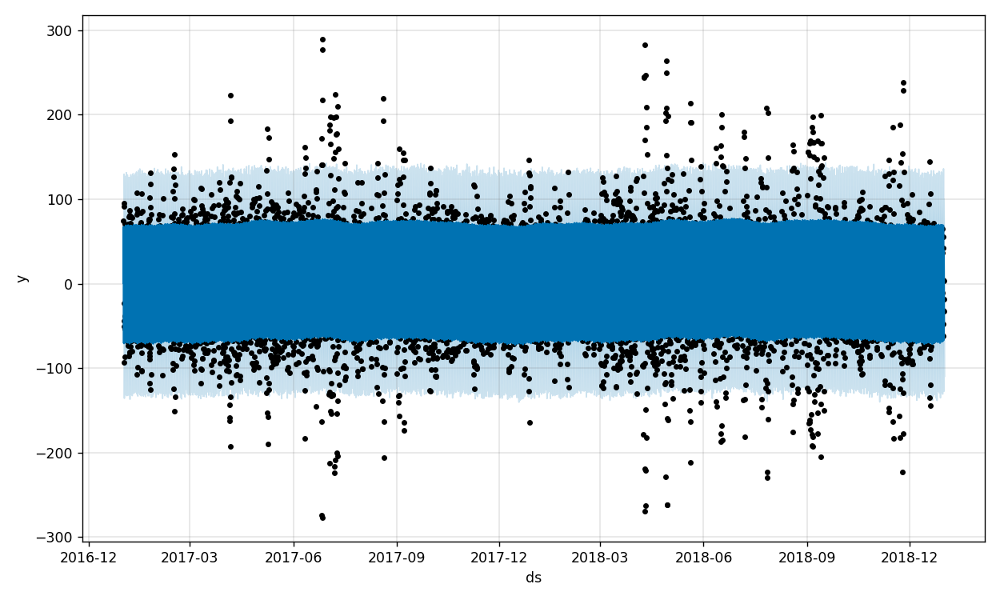

         trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
5835  0.233486 -127.055145   -8.315318     0.233486     0.233486   
5836  0.233731  -74.649342   44.341168     0.233731     0.233731   
5837  0.233976  -23.522590  100.334356     0.233976     0.233976   
5838  0.234222  -51.292804   76.575524     0.234222     0.234222   
5839  0.234467 -109.932124   17.647028     0.234467     0.234467   

      additive_terms  additive_terms_lower  additive_terms_upper      daily  \
5835      -67.209332            -67.209332            -67.209332 -65.199855   
5836      -14.429912            -14.429912            -14.429912 -12.898583   
5837       38.704897             38.704897             38.704897  39.835151   
5838       13.579679             13.579679             13.579679  14.425796   
5839      -45.457365            -45.457365            -45.457365 -44.752048   

      daily_lower  daily_upper    yearly  yearly_lower  yearly_upper  \
5835   -65.199855   -65.199855 -2.388529    

<IPython.core.display.Javascript object>


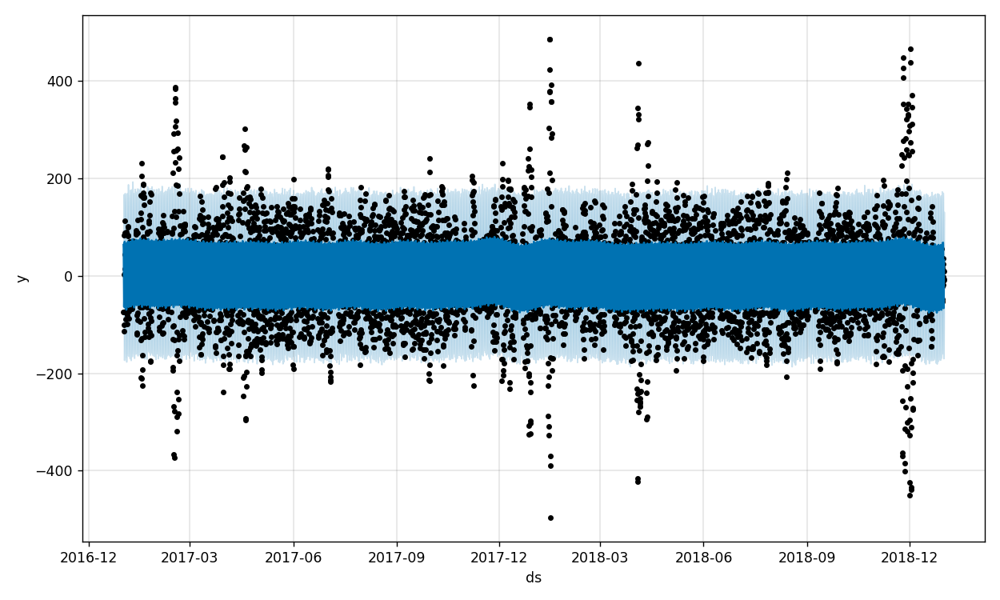

         trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
5835  0.050819 -144.906856   54.645301     0.050819     0.050819   
5836  0.050507 -169.290206   39.697530     0.050507     0.050507   
5837  0.050195 -161.471762   50.102894     0.050195     0.050195   
5838  0.049883 -118.618769   94.192807     0.049883     0.049883   
5839  0.049571  -73.554676  130.853109     0.049571     0.049571   

      additive_terms  additive_terms_lower  additive_terms_upper      daily  \
5835      -40.242341            -40.242341            -40.242341 -40.338931   
5836      -66.675708            -66.675708            -66.675708 -65.504385   
5837      -56.018440            -56.018440            -56.018440 -53.461815   
5838      -16.771716            -16.771716            -16.771716 -12.840917   
5839       31.272639             31.272639             31.272639  36.436171   

      daily_lower  daily_upper    yearly  yearly_lower  yearly_upper  \
5835   -40.338931   -40.338931 -1.801379    

<IPython.core.display.Javascript object>


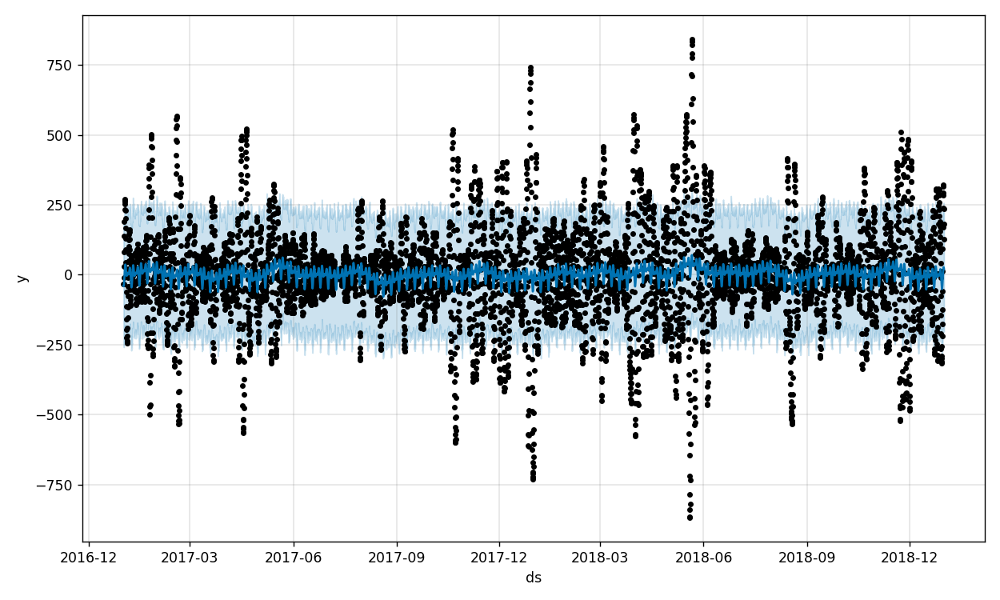

         trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
5835  7.788839 -190.493613  238.301785     7.788839     7.788839   
5836  7.791498 -192.042778  245.325391     7.791498     7.791498   
5837  7.794158 -198.251175  256.824438     7.794158     7.794158   
5838  7.796817 -204.062620  228.524810     7.796817     7.796817   
5839  7.799477 -203.516040  237.056389     7.799477     7.799477   

      additive_terms  additive_terms_lower  additive_terms_upper     daily  \
5835       17.024527             17.024527             17.024527 -0.187507   
5836       19.082905             19.082905             19.082905 -0.517180   
5837       18.904793             18.904793             18.904793 -0.539604   
5838       16.802380             16.802380             16.802380 -0.186241   
5839       12.912976             12.912976             12.912976  0.245643   

      daily_lower  daily_upper     yearly  yearly_lower  yearly_upper  \
5835    -0.187507    -0.187507 -12.600591    -12.

<IPython.core.display.Javascript object>


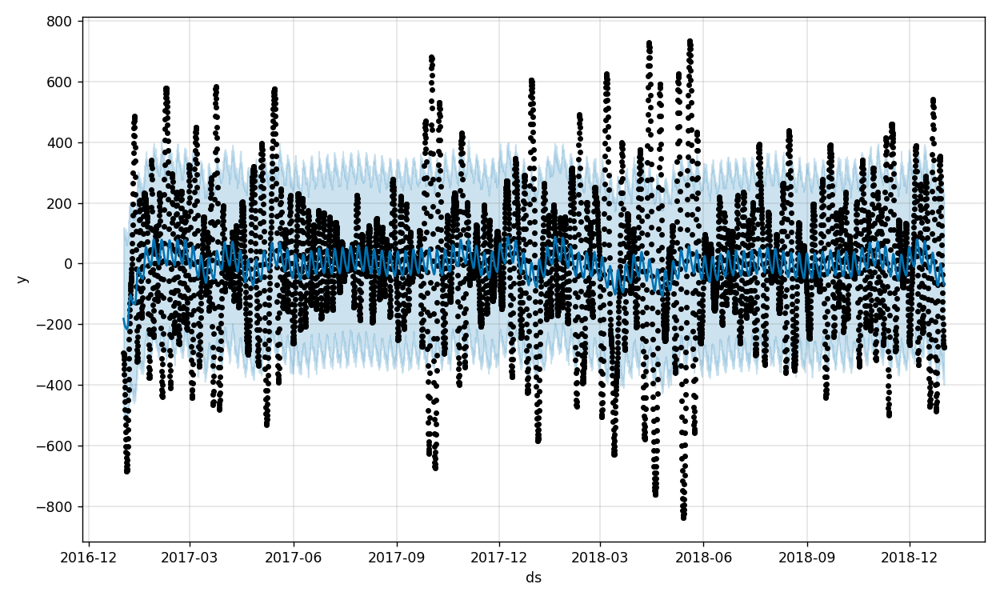

          trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
5835 -10.641431 -370.586391  233.891203   -10.641431   -10.641431   
5836 -10.643850 -359.822040  223.372826   -10.643850   -10.643850   
5837 -10.646269 -341.879541  225.374286   -10.646269   -10.646269   
5838 -10.648688 -397.643795  220.020202   -10.648688   -10.648688   
5839 -10.651107 -400.141218  231.454691   -10.651107   -10.651107   

      additive_terms  additive_terms_lower  additive_terms_upper     daily  \
5835      -50.835996            -50.835996            -50.835996 -0.056334   
5836      -53.070348            -53.070348            -53.070348 -0.034028   
5837      -55.205037            -55.205037            -55.205037 -0.052460   
5838      -57.159503            -57.159503            -57.159503  0.004040   
5839      -59.128541            -59.128541            -59.128541 -0.022367   

      daily_lower  daily_upper     yearly  yearly_lower  yearly_upper  \
5835    -0.056334    -0.056334 -38.928526  

<IPython.core.display.Javascript object>


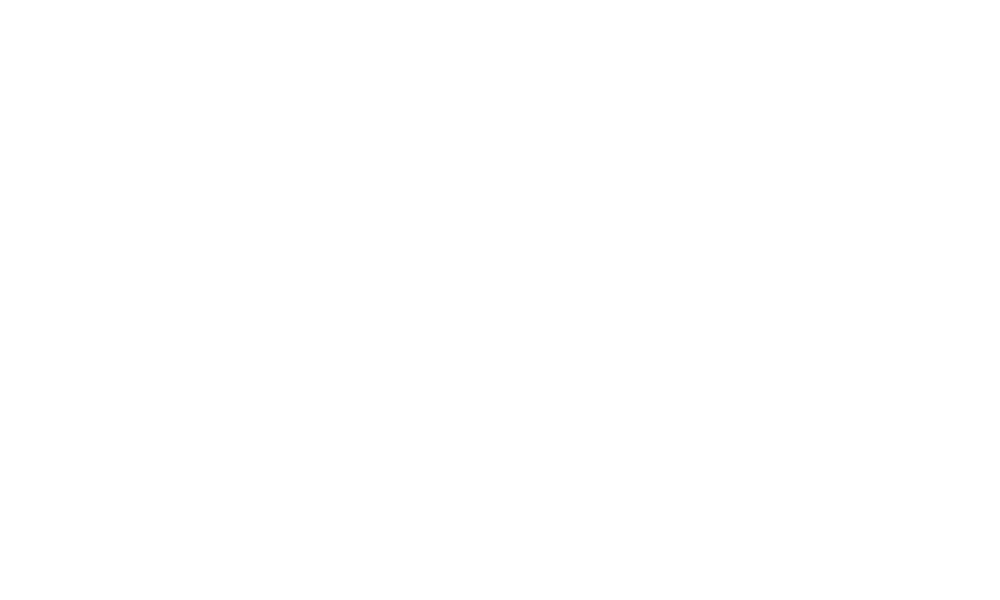

         trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
5835  7.970502 -209.864905  281.265750     7.970502     7.970502   
5836  7.976009 -205.715312  273.555792     7.976009     7.976009   
5837  7.981517 -201.179844  269.838808     7.981517     7.981517   
5838  7.987025 -191.327132  275.749326     7.987025     7.987025   
5839  7.992533 -202.599484  286.918018     7.992533     7.992533   

      additive_terms  additive_terms_lower  additive_terms_upper     daily  \
5835       32.257374             32.257374             32.257374 -0.025311   
5836       32.417861             32.417861             32.417861  0.024198   
5837       32.487089             32.487089             32.487089  0.076867   
5838       32.473198             32.473198             32.473198  0.126508   
5839       32.399435             32.399435             32.399435  0.177986   

      daily_lower  daily_upper     yearly  yearly_lower  yearly_upper  \
5835    -0.025311    -0.025311  28.020813     28.

<IPython.core.display.Javascript object>


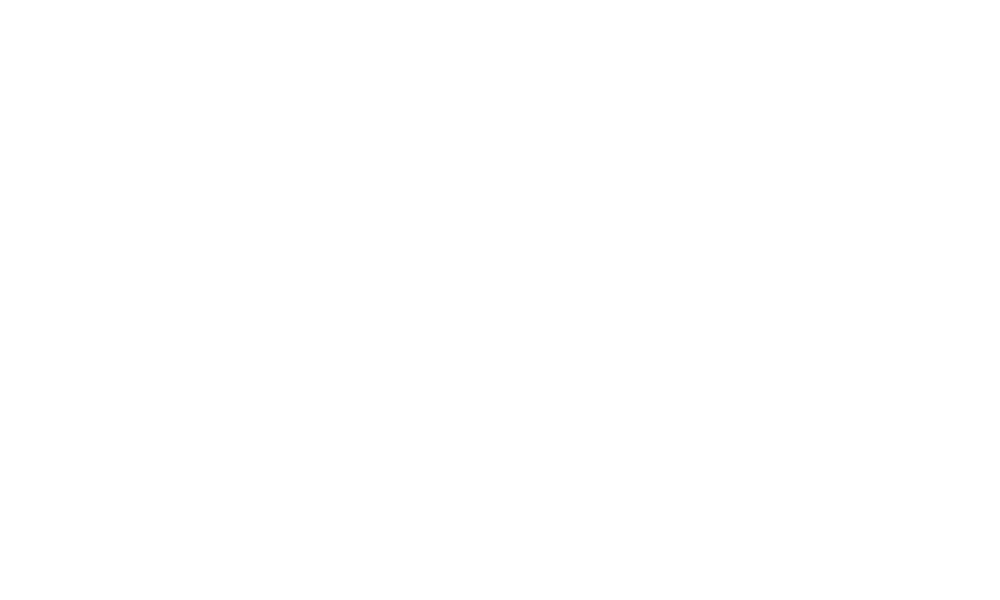

          trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
5835 -10.063975 -216.931596  107.945723   -10.063975   -10.063975   
5836 -10.066541 -215.010028  118.712288   -10.066541   -10.066541   
5837 -10.069106 -218.419695  116.883316   -10.069106   -10.069106   
5838 -10.071672 -204.467675  116.315476   -10.071672   -10.071672   
5839 -10.074237 -213.785273  113.121707   -10.074237   -10.074237   

      additive_terms  additive_terms_lower  additive_terms_upper     daily  \
5835      -42.203692            -42.203692            -42.203692  0.004581   
5836      -41.974431            -41.974431            -41.974431 -0.007463   
5837      -41.750042            -41.750042            -41.750042 -0.017067   
5838      -41.533423            -41.533423            -41.533423 -0.027943   
5839      -41.320671            -41.320671            -41.320671 -0.036417   

      daily_lower  daily_upper     yearly  yearly_lower  yearly_upper  \
5835     0.004581     0.004581 -42.714684  

<IPython.core.display.Javascript object>


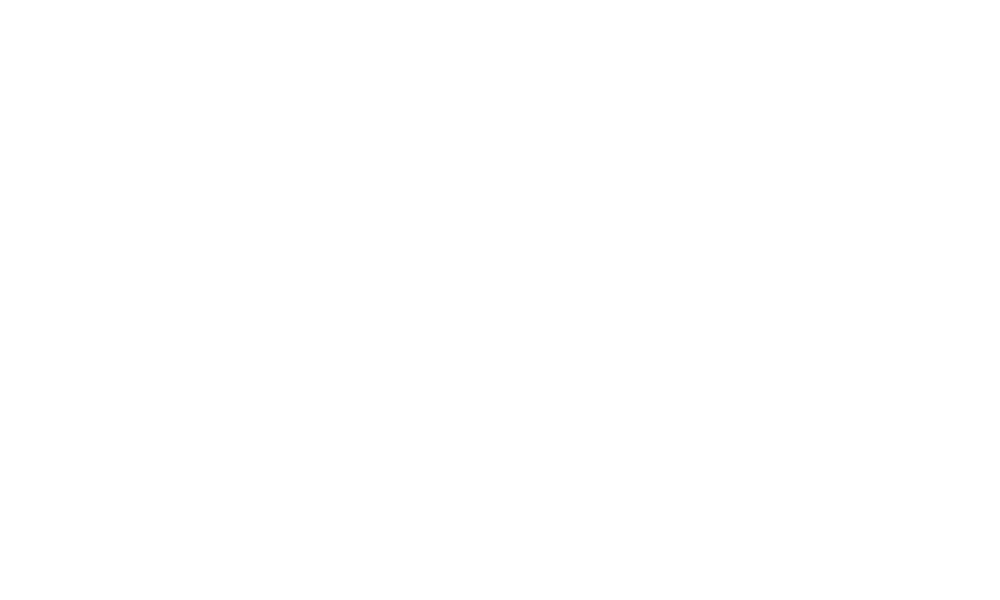

          trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
5835  79.322102  -19.893286  112.024134    79.322102    79.322102   
5836  79.335138  -23.555528  112.824395    79.335138    79.335138   
5837  79.348174  -26.545260  106.152422    79.348174    79.348174   
5838  79.361210  -30.526675  106.598027    79.361210    79.361210   
5839  79.374246  -31.723667   96.870501    79.374246    79.374246   

      additive_terms  additive_terms_lower  additive_terms_upper     daily  \
5835      -32.806804            -32.806804            -32.806804 -0.017026   
5836      -35.688886            -35.688886            -35.688886  0.004956   
5837      -38.580653            -38.580653            -38.580653  0.036523   
5838      -41.494899            -41.494899            -41.494899  0.062993   
5839      -44.418607            -44.418607            -44.418607  0.093856   

      daily_lower  daily_upper     yearly  yearly_lower  yearly_upper  \
5835    -0.017026    -0.017026 -32.770502  

<IPython.core.display.Javascript object>


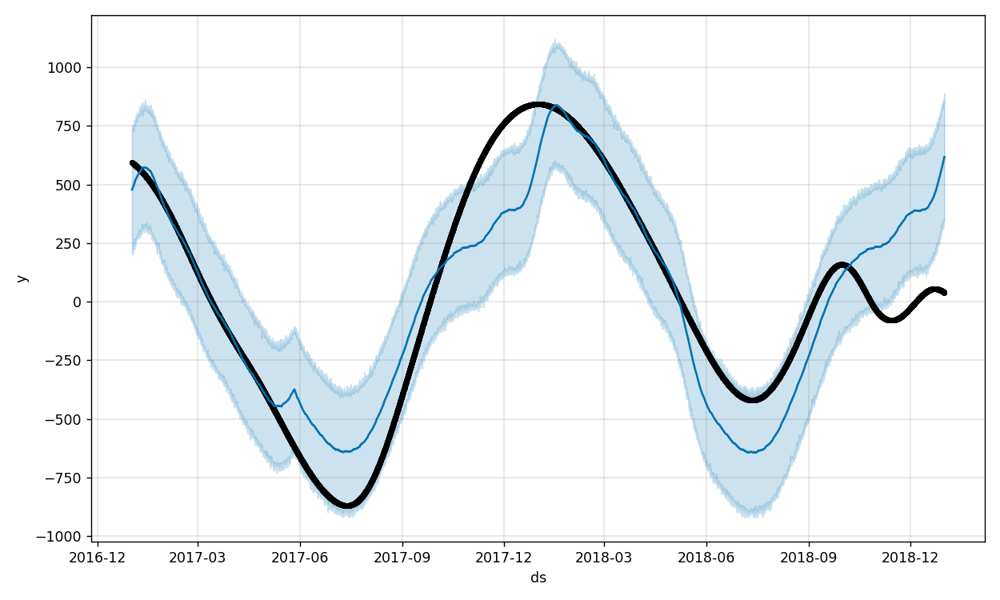

           trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
5835  102.244640  337.164143  864.904636   102.244640   102.244640   
5836  102.243687  349.901240  847.696178   102.243687   102.243687   
5837  102.242734  353.914904  858.168664   102.242734   102.242734   
5838  102.241781  346.404074  887.963519   102.241781   102.241781   
5839  102.240828  345.402063  870.540367   102.240828   102.240828   

      additive_terms  additive_terms_lower  additive_terms_upper     daily  \
5835      503.836760            503.836760            503.836760  0.061626   
5836      506.606472            506.606472            506.606472 -0.054757   
5837      509.478637            509.478637            509.478637 -0.179458   
5838      512.448845            512.448845            512.448845 -0.298106   
5839      515.476424            515.476424            515.476424 -0.424134   

      daily_lower  daily_upper      yearly  yearly_lower  yearly_upper  \
5835     0.061626     0.061626  505.

<IPython.core.display.Javascript object>


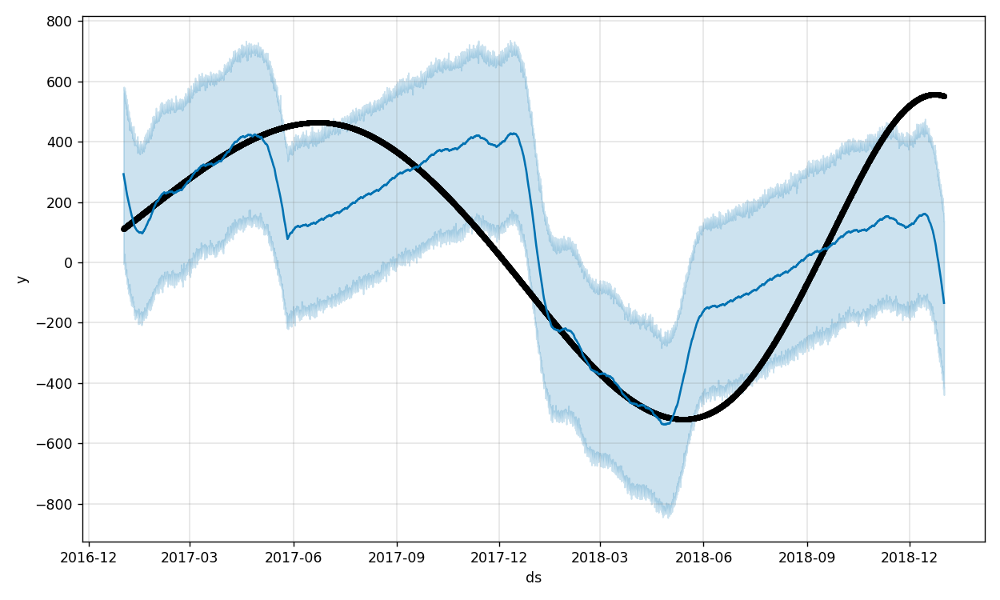

           trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
5835 -264.326923 -410.088408  162.666292  -264.326923  -264.326923   
5836 -264.418720 -412.624486  164.279108  -264.418720  -264.418720   
5837 -264.510518 -419.375161  155.246619  -264.510518  -264.510518   
5838 -264.602316 -412.491838  136.693139  -264.602316  -264.602316   
5839 -264.694114 -439.781614  137.208575  -264.694114  -264.694114   

      additive_terms  additive_terms_lower  additive_terms_upper     daily  \
5835      145.672931            145.672931            145.672931 -0.079585   
5836      141.950559            141.950559            141.950559  0.071636   
5837      138.089543            138.089543            138.089543  0.220185   
5838      134.118790            134.118790            134.118790  0.373859   
5839      130.061230            130.061230            130.061230  0.523954   

      daily_lower  daily_upper      yearly  yearly_lower  yearly_upper  \
5835    -0.079585    -0.079585  143.

<IPython.core.display.Javascript object>


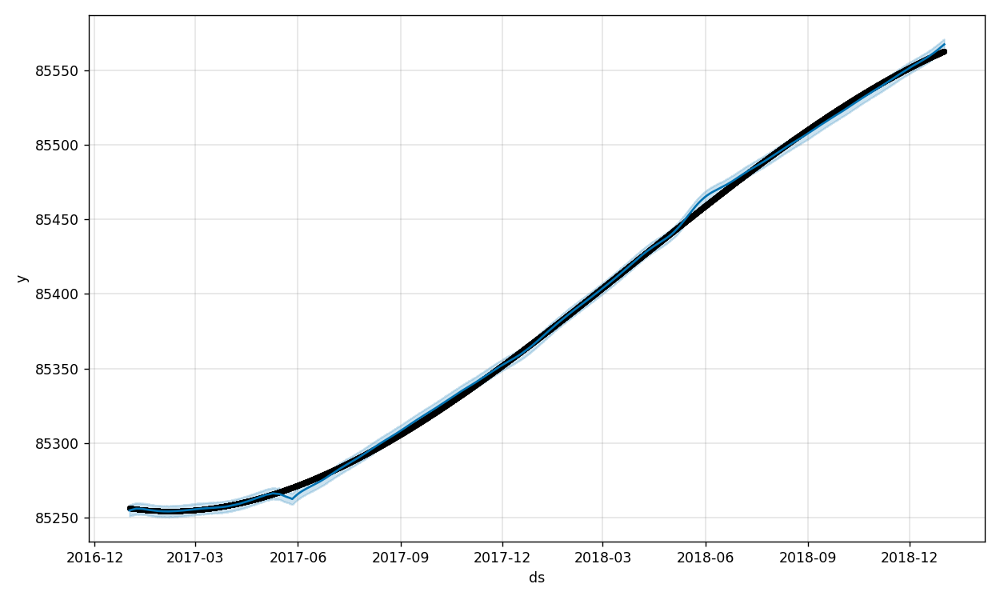

             trend    yhat_lower    yhat_upper   trend_lower   trend_upper  \
5835  85572.789091  85563.071024  85570.550960  85572.789091  85572.789091   
5836  85572.857327  85563.151513  85570.813139  85572.857327  85572.857327   
5837  85572.925564  85563.624511  85570.741618  85572.925564  85572.925564   
5838  85572.993800  85563.039389  85570.770955  85572.993800  85572.993800   
5839  85573.062036  85563.463944  85570.773866  85573.062036  85573.062036   

      additive_terms  additive_terms_lower  additive_terms_upper     daily  \
5835       -5.929288             -5.929288             -5.929288  0.000201   
5836       -5.915445             -5.915445             -5.915445 -0.000376   
5837       -5.901459             -5.901459             -5.901459 -0.001818   
5838       -5.885661             -5.885661             -5.885661 -0.002336   
5839       -5.870041             -5.870041             -5.870041 -0.003729   

      daily_lower  daily_upper    yearly  yearly_lower  yearly

<IPython.core.display.Javascript object>


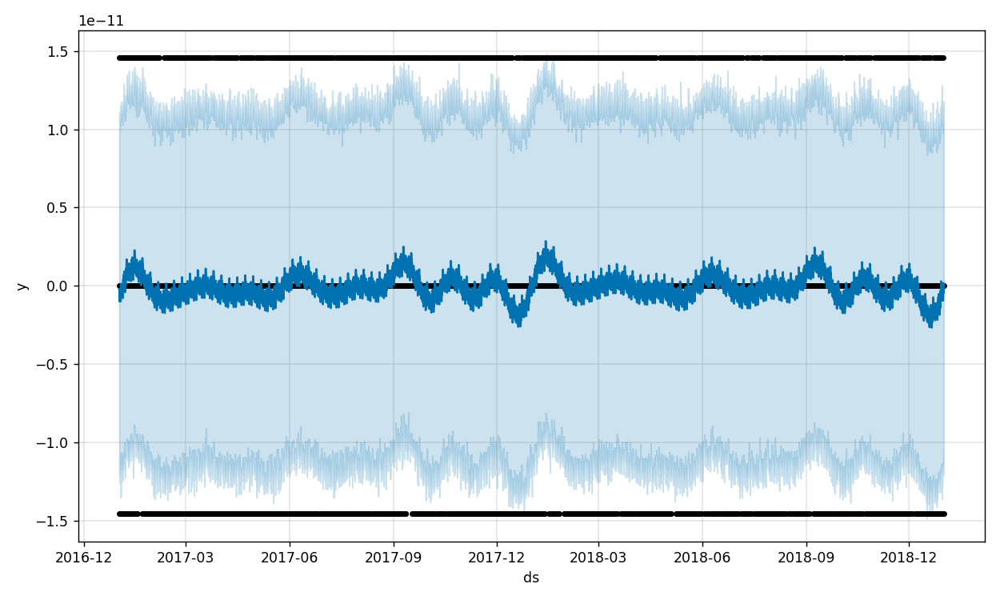

             trend    yhat_lower    yhat_upper   trend_lower   trend_upper  \
5835 -2.602248e-14 -1.176142e-11  1.056518e-11 -2.602248e-14 -2.602248e-14   
5836 -2.603356e-14 -1.147567e-11  1.139887e-11 -2.603356e-14 -2.603356e-14   
5837 -2.604463e-14 -1.203464e-11  1.159002e-11 -2.604463e-14 -2.604463e-14   
5838 -2.605571e-14 -1.073235e-11  1.146322e-11 -2.605571e-14 -2.605571e-14   
5839 -2.606678e-14 -1.128711e-11  1.178622e-11 -2.606678e-14 -2.606678e-14   

      additive_terms  additive_terms_lower  additive_terms_upper  \
5835   -5.556418e-13         -5.556418e-13         -5.556418e-13   
5836    2.052311e-13          2.052311e-13          2.052311e-13   
5837   -4.273792e-13         -4.273792e-13         -4.273792e-13   
5838   -1.952827e-14         -1.952827e-14         -1.952827e-14   
5839    1.034882e-13          1.034882e-13          1.034882e-13   

             daily   daily_lower   daily_upper        yearly  yearly_lower  \
5835 -2.338617e-13 -2.338617e-13 -2.338617e-

<IPython.core.display.Javascript object>


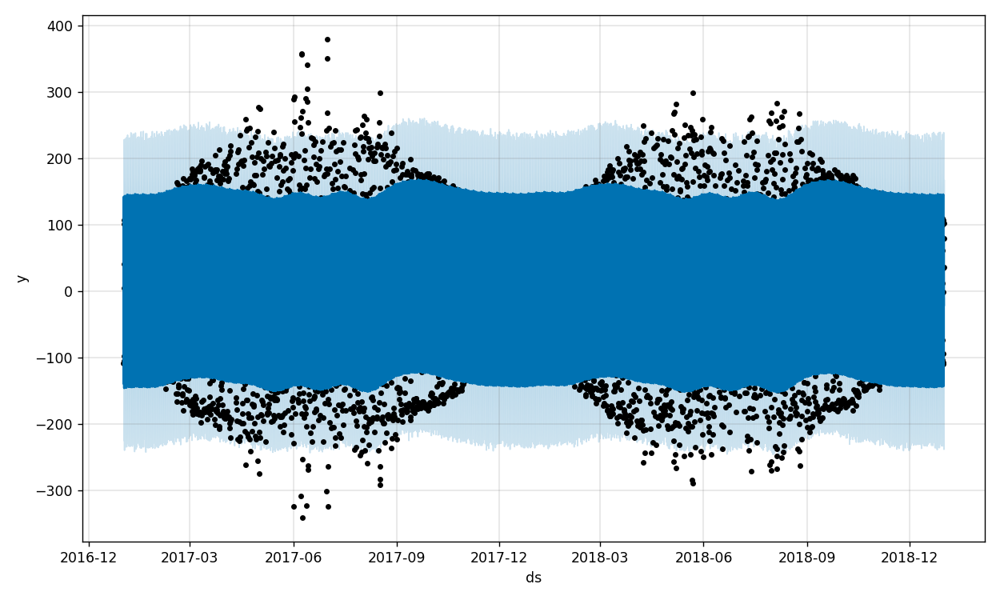

         trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
5835  4.137610 -111.132265   73.369141     4.137610     4.137610   
5836  4.137278 -237.623408  -62.988068     4.137278     4.137278   
5837  4.136946  -69.642995  110.523779     4.136946     4.136946   
5838  4.136614   -9.250619  168.200045     4.136614     4.136614   
5839  4.136282 -105.145348   72.495480     4.136282     4.136282   

      additive_terms  additive_terms_lower  additive_terms_upper       daily  \
5835      -24.131655            -24.131655            -24.131655  -20.189360   
5836     -147.353281           -147.353281           -147.353281 -143.288966   
5837       15.221170             15.221170             15.221170   19.438597   
5838       78.462209             78.462209             78.462209   82.839396   
5839      -24.829068            -24.829068            -24.829068  -20.312058   

      daily_lower  daily_upper    yearly  yearly_lower  yearly_upper  \
5835   -20.189360   -20.189360 -3.7663

<IPython.core.display.Javascript object>


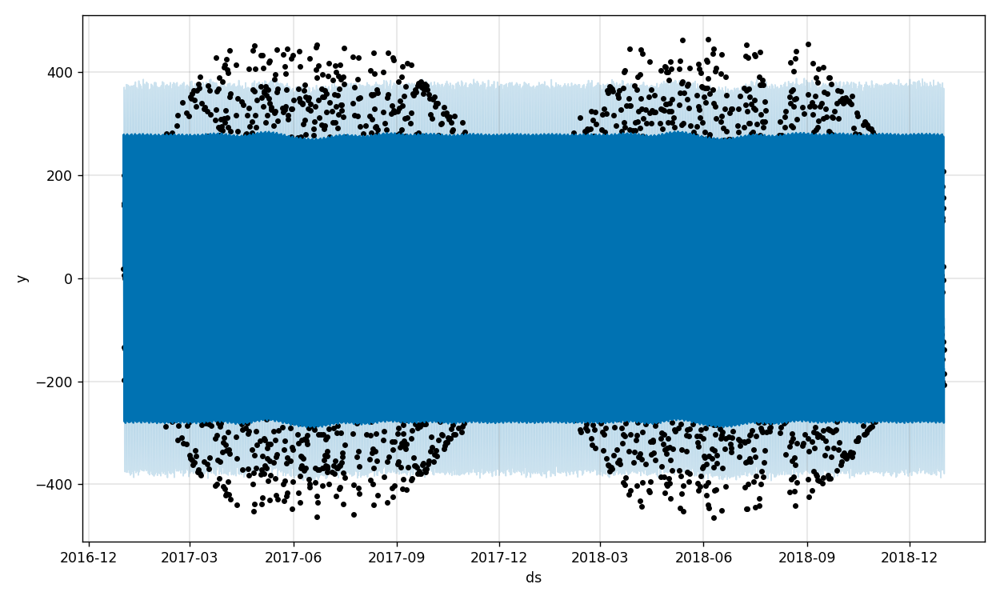

         trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
5835 -2.715379   71.876491  263.972521    -2.715379    -2.715379   
5836 -2.715219 -128.424470   62.037468    -2.715219    -2.715219   
5837 -2.715059 -314.400908 -118.005560    -2.715059    -2.715059   
5838 -2.714900 -378.624523 -182.807954    -2.714900    -2.714900   
5839 -2.714740 -276.561767  -76.793662    -2.714740    -2.714740   

      additive_terms  additive_terms_lower  additive_terms_upper       daily  \
5835      170.982009            170.982009            170.982009  173.231147   
5836      -31.217841            -31.217841            -31.217841  -28.753245   
5837     -214.602046           -214.602046           -214.602046 -212.093048   
5838     -277.878096           -277.878096           -277.878096 -275.501292   
5839     -174.340884           -174.340884           -174.340884 -172.264871   

      daily_lower  daily_upper    yearly  yearly_lower  yearly_upper  \
5835   173.231147   173.231147  0.2008

<IPython.core.display.Javascript object>


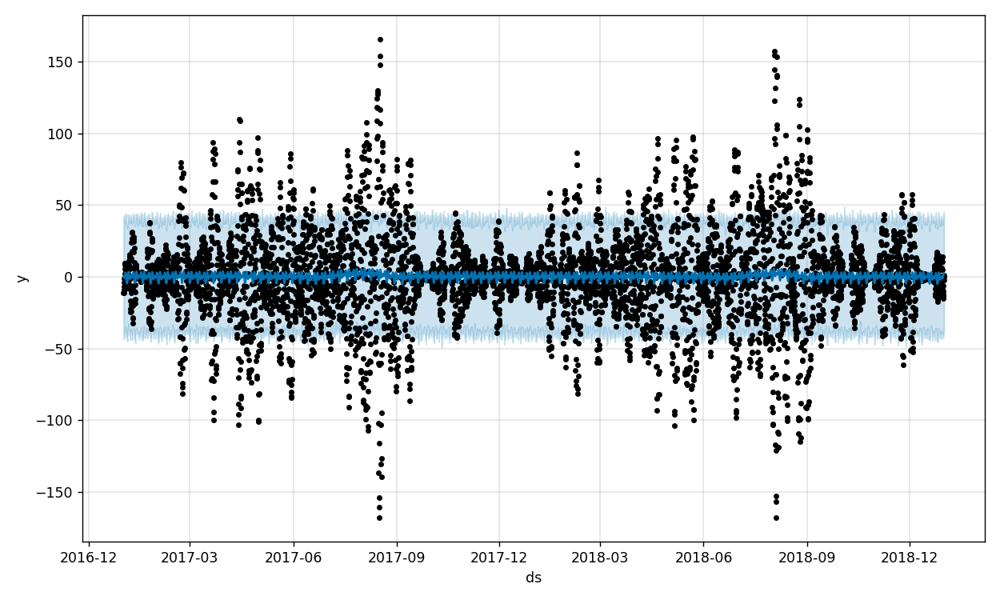

         trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
5835  0.035296  -37.564421   41.456359     0.035296     0.035296   
5836  0.035216  -38.377005   41.601846     0.035216     0.035216   
5837  0.035136  -39.304097   44.186553     0.035136     0.035136   
5838  0.035056  -39.693728   45.311489     0.035056     0.035056   
5839  0.034976  -36.155190   40.911866     0.034976     0.034976   

      additive_terms  additive_terms_lower  additive_terms_upper     daily  \
5835        1.699231              1.699231              1.699231  0.020695   
5836        2.189638              2.189638              2.189638  0.016474   
5837        2.505414              2.505414              2.505414  0.007025   
5838        2.581425              2.581425              2.581425 -0.015981   
5839        2.407854              2.407854              2.407854 -0.025993   

      daily_lower  daily_upper    yearly  yearly_lower  yearly_upper      yhat  
5835     0.020695     0.020695 -0.384210 

<IPython.core.display.Javascript object>


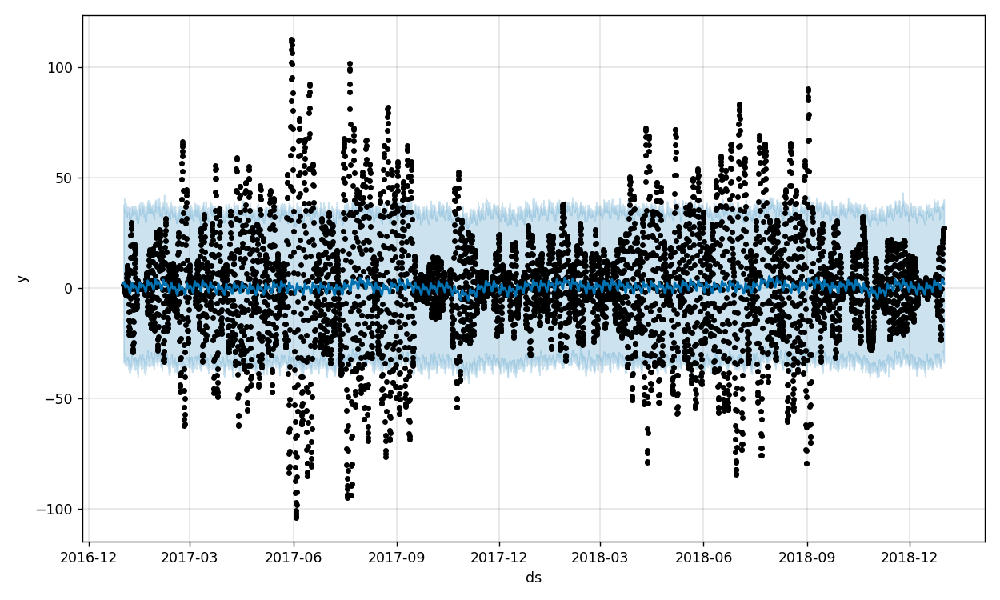

         trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
5835  1.109316  -30.583394   39.175025     1.109316     1.109316   
5836  1.109574  -29.626890   37.919347     1.109574     1.109574   
5837  1.109832  -31.516622   36.738833     1.109832     1.109832   
5838  1.110090  -33.851331   40.005427     1.110090     1.110090   
5839  1.110347  -33.472887   38.571240     1.110347     1.110347   

      additive_terms  additive_terms_lower  additive_terms_upper     daily  \
5835        1.147605              1.147605              1.147605  0.000021   
5836        0.920487              0.920487              0.920487  0.006173   
5837        0.759153              0.759153              0.759153  0.005594   
5838        0.677306              0.677306              0.677306  0.006153   
5839        0.678390              0.678390              0.678390  0.013027   

      daily_lower  daily_upper    yearly  yearly_lower  yearly_upper      yhat  
5835     0.000021     0.000021  0.823935 

<IPython.core.display.Javascript object>


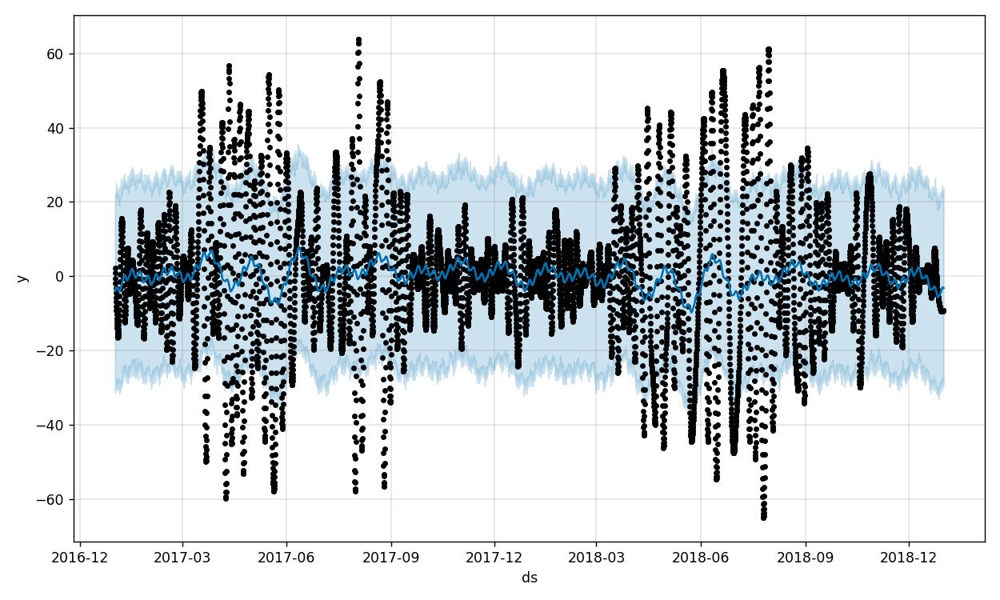

         trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
5835 -1.513840  -29.907724   22.155037    -1.513840    -1.513840   
5836 -1.514425  -27.036703   22.244102    -1.514425    -1.514425   
5837 -1.515010  -28.348282   23.757274    -1.515010    -1.515010   
5838 -1.515595  -29.183340   23.515188    -1.515595    -1.515595   
5839 -1.516180  -28.189375   22.903907    -1.516180    -1.516180   

      additive_terms  additive_terms_lower  additive_terms_upper     daily  \
5835       -1.510830             -1.510830             -1.510830 -0.001278   
5836       -1.526811             -1.526811             -1.526811  0.000100   
5837       -1.556390             -1.556390             -1.556390  0.000794   
5838       -1.601859             -1.601859             -1.601859 -0.001024   
5839       -1.663264             -1.663264             -1.663264 -0.004807   

      daily_lower  daily_upper    yearly  yearly_lower  yearly_upper      yhat  
5835    -0.001278    -0.001278 -2.625347 

<IPython.core.display.Javascript object>


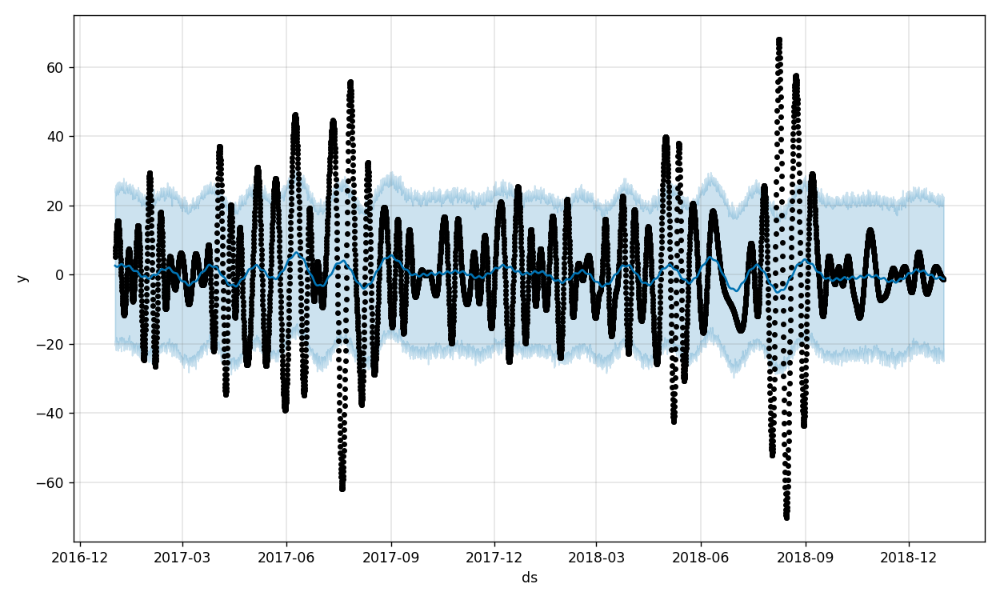

         trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
5835 -0.897891  -23.324107   22.592390    -0.897891    -0.897891   
5836 -0.898320  -24.184433   21.843172    -0.898320    -0.898320   
5837 -0.898748  -24.992101   21.597169    -0.898748    -0.898748   
5838 -0.899176  -21.403310   21.592587    -0.899176    -0.899176   
5839 -0.899604  -24.557874   22.512412    -0.899604    -0.899604   

      additive_terms  additive_terms_lower  additive_terms_upper     daily  \
5835       -0.340630             -0.340630             -0.340630  0.000628   
5836       -0.351835             -0.351835             -0.351835  0.000155   
5837       -0.358797             -0.358797             -0.358797 -0.000223   
5838       -0.361850             -0.361850             -0.361850 -0.001019   
5839       -0.360423             -0.360423             -0.360423 -0.001772   

      daily_lower  daily_upper    yearly  yearly_lower  yearly_upper      yhat  
5835     0.000628     0.000628 -0.057531 

<IPython.core.display.Javascript object>


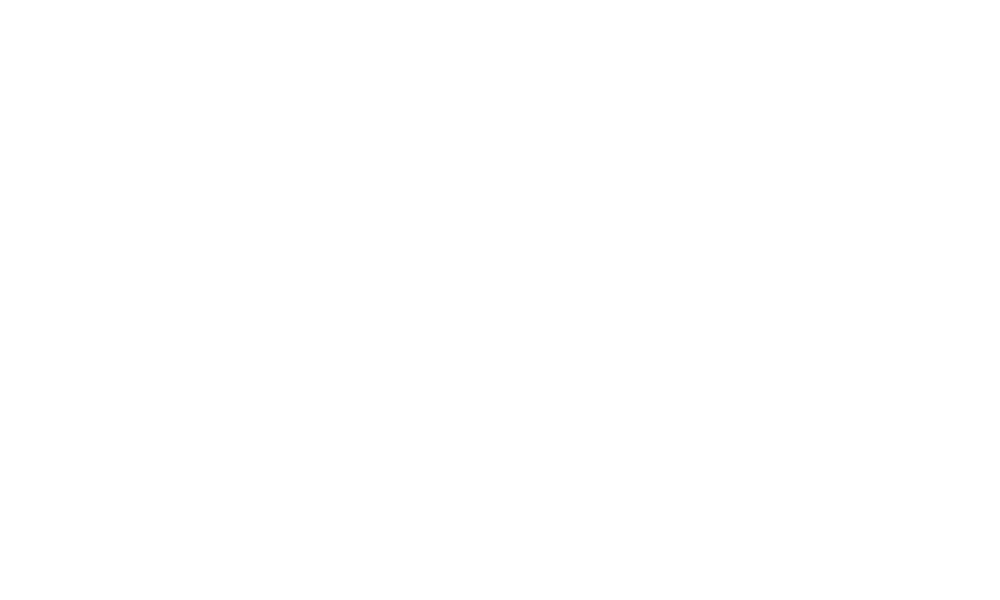

         trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
5835  0.141799  -11.978648   20.665359     0.141799     0.141799   
5836  0.141867  -11.864765   20.980656     0.141867     0.141867   
5837  0.141935  -11.375150   19.774469     0.141935     0.141935   
5838  0.142004  -11.154406   19.646540     0.142004     0.142004   
5839  0.142072  -12.264905   20.511972     0.142072     0.142072   

      additive_terms  additive_terms_lower  additive_terms_upper     daily  \
5835        4.039955              4.039955              4.039955  0.000900   
5836        4.044779              4.044779              4.044779 -0.001658   
5837        4.050529              4.050529              4.050529 -0.003288   
5838        4.055804              4.055804              4.055804 -0.005164   
5839        4.060731              4.060731              4.060731 -0.006789   

      daily_lower  daily_upper    yearly  yearly_lower  yearly_upper      yhat  
5835     0.000900     0.000900  4.033720 

<IPython.core.display.Javascript object>


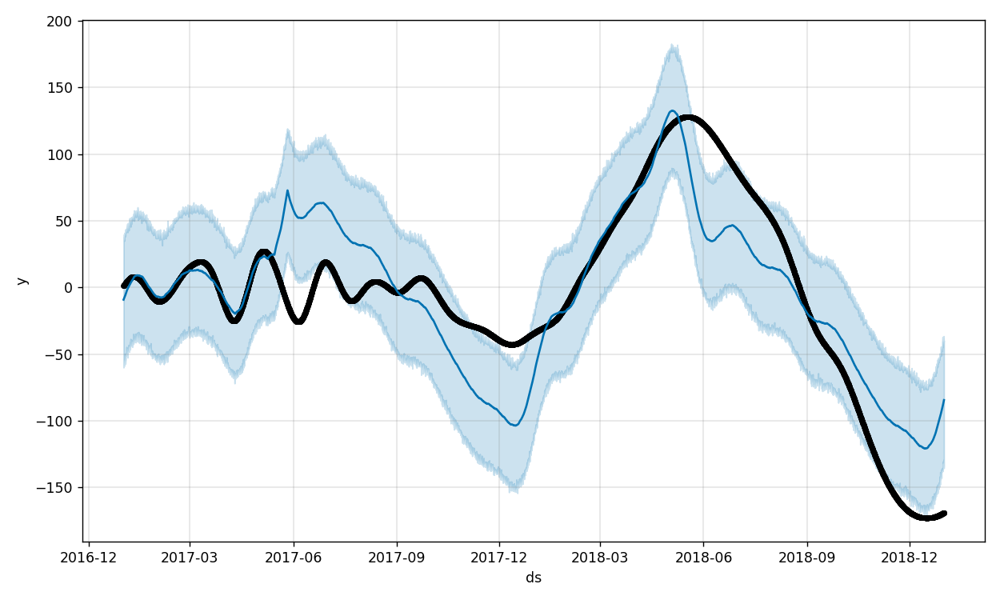

         trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
5835 -9.075600 -130.860679  -40.793416    -9.075600    -9.075600   
5836 -9.081436 -132.217041  -38.615241    -9.081436    -9.081436   
5837 -9.087272 -129.116942  -36.482643    -9.087272    -9.087272   
5838 -9.093109 -135.425248  -40.397988    -9.093109    -9.093109   
5839 -9.098945 -133.317665  -39.958841    -9.098945    -9.098945   

      additive_terms  additive_terms_lower  additive_terms_upper     daily  \
5835      -77.388014            -77.388014            -77.388014  0.010022   
5836      -76.884406            -76.884406            -76.884406 -0.008047   
5837      -76.362544            -76.362544            -76.362544 -0.023798   
5838      -75.830263            -75.830263            -75.830263 -0.042115   
5839      -75.286590            -75.286590            -75.286590 -0.057929   

      daily_lower  daily_upper     yearly  yearly_lower  yearly_upper  \
5835     0.010022     0.010022 -77.143948    -77.

<IPython.core.display.Javascript object>


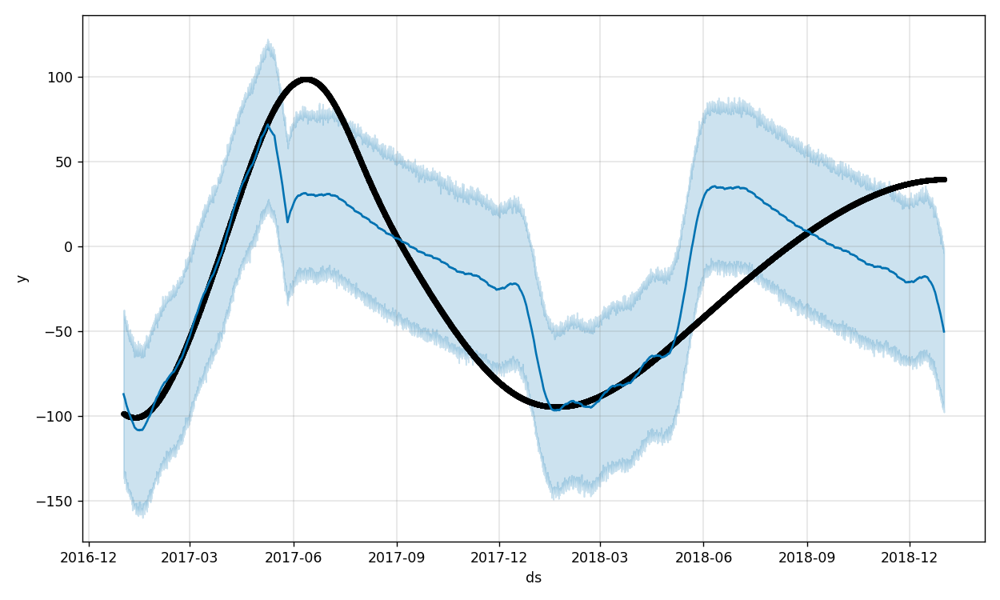

          trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
5835 -23.851715  -92.697377   -0.701484   -23.851715   -23.851715   
5836 -23.850317  -94.893778   -0.861265   -23.850317   -23.850317   
5837 -23.848918  -95.172038   -3.809349   -23.848918   -23.848918   
5838 -23.847520  -96.503726   -0.891178   -23.847520   -23.847520   
5839 -23.846122  -97.820912   -3.688525   -23.846122   -23.846122   

      additive_terms  additive_terms_lower  additive_terms_upper     daily  \
5835      -24.508190            -24.508190            -24.508190 -0.009927   
5836      -24.966333            -24.966333            -24.966333  0.007809   
5837      -25.441384            -25.441384            -25.441384  0.025897   
5838      -25.930470            -25.930470            -25.930470  0.044086   
5839      -26.429383            -26.429383            -26.429383  0.062232   

      daily_lower  daily_upper     yearly  yearly_lower  yearly_upper  \
5835    -0.009927    -0.009927 -24.781296  

<IPython.core.display.Javascript object>


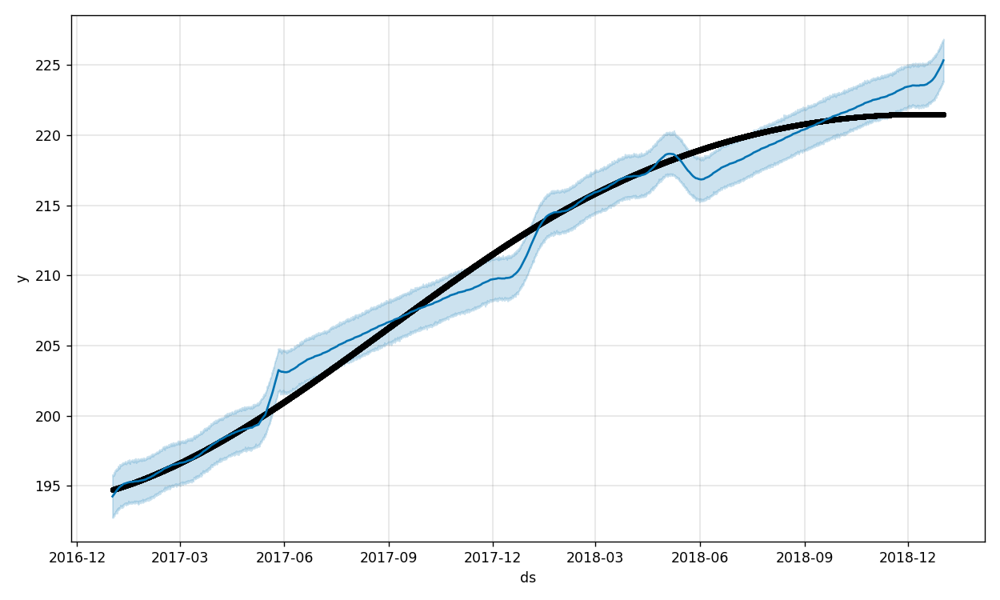

           trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
5835  225.749355  223.862191  226.650945   225.749355   225.749355   
5836  225.754058  223.700234  226.732440   225.754058   225.754058   
5837  225.758762  223.852665  226.700091   225.758762   225.758762   
5838  225.763465  223.787048  226.804873   225.763465   225.763465   
5839  225.768169  223.812862  226.847907   225.768169   225.768169   

      additive_terms  additive_terms_lower  additive_terms_upper     daily  \
5835       -0.525751             -0.525751             -0.525751  0.000389   
5836       -0.506040             -0.506040             -0.506040 -0.000273   
5837       -0.485754             -0.485754             -0.485754 -0.001148   
5838       -0.464636             -0.464636             -0.464636 -0.001844   
5839       -0.443246             -0.443246             -0.443246 -0.002735   

      daily_lower  daily_upper    yearly  yearly_lower  yearly_upper  \
5835     0.000389     0.000389 -0.5135

<IPython.core.display.Javascript object>


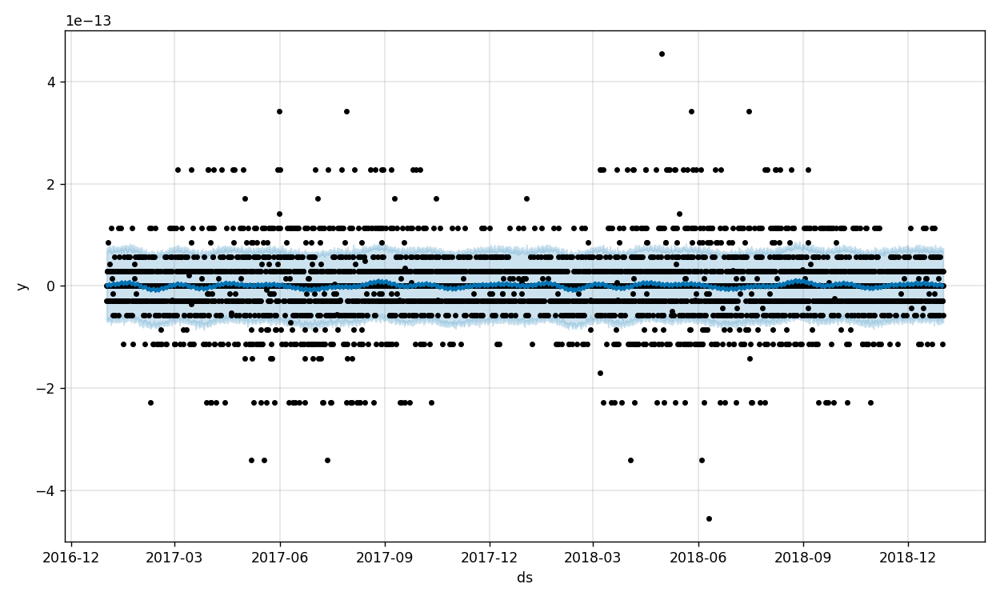

             trend    yhat_lower    yhat_upper   trend_lower   trend_upper  \
5835  8.708632e-16 -6.819277e-14  7.333584e-14  8.708632e-16  8.708632e-16   
5836  8.712201e-16 -6.708784e-14  6.923022e-14  8.712201e-16  8.712201e-16   
5837  8.715771e-16 -6.648682e-14  6.976674e-14  8.715771e-16  8.715771e-16   
5838  8.719340e-16 -6.879119e-14  6.936695e-14  8.719340e-16  8.719340e-16   
5839  8.722910e-16 -7.104756e-14  7.324956e-14  8.722910e-16  8.722910e-16   

      additive_terms  additive_terms_lower  additive_terms_upper  \
5835    1.777527e-15          1.777527e-15          1.777527e-15   
5836    7.076786e-16          7.076786e-16          7.076786e-16   
5837   -1.355206e-15         -1.355206e-15         -1.355206e-15   
5838   -6.917405e-16         -6.917405e-16         -6.917405e-16   
5839   -3.858869e-16         -3.858869e-16         -3.858869e-16   

             daily   daily_lower   daily_upper        yearly  yearly_lower  \
5835  2.630715e-15  2.630715e-15  2.630715e-

<IPython.core.display.Javascript object>


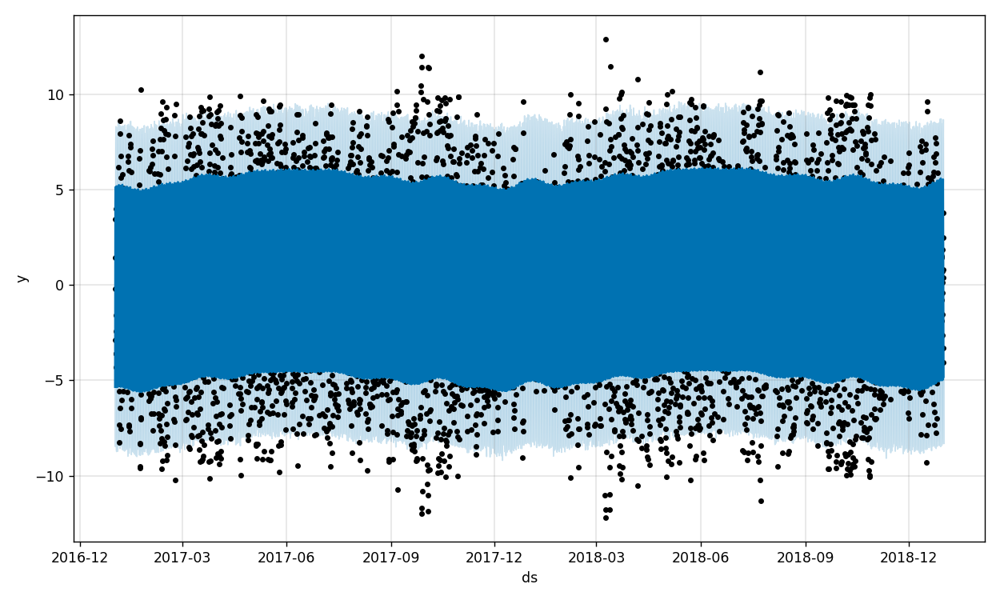

         trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
5835  0.116741    2.288749    8.698145     0.116741     0.116741   
5836  0.116761   -0.948513    5.831900     0.116761     0.116761   
5837  0.116782   -3.977885    2.426255     0.116782     0.116782   
5838  0.116802   -6.271483    0.225279     0.116802     0.116802   
5839  0.116823   -8.294430   -1.476220     0.116823     0.116823   

      additive_terms  additive_terms_lower  additive_terms_upper     daily  \
5835        5.430240              5.430240              5.430240  5.542097   
5836        2.182046              2.182046              2.182046  2.293811   
5837       -0.748251             -0.748251             -0.748251 -0.633244   
5838       -3.246633             -3.246633             -3.246633 -3.125683   
5839       -4.938790             -4.938790             -4.938790 -4.810235   

      daily_lower  daily_upper    yearly  yearly_lower  yearly_upper      yhat  
5835     5.542097     5.542097 -0.098601 

<IPython.core.display.Javascript object>


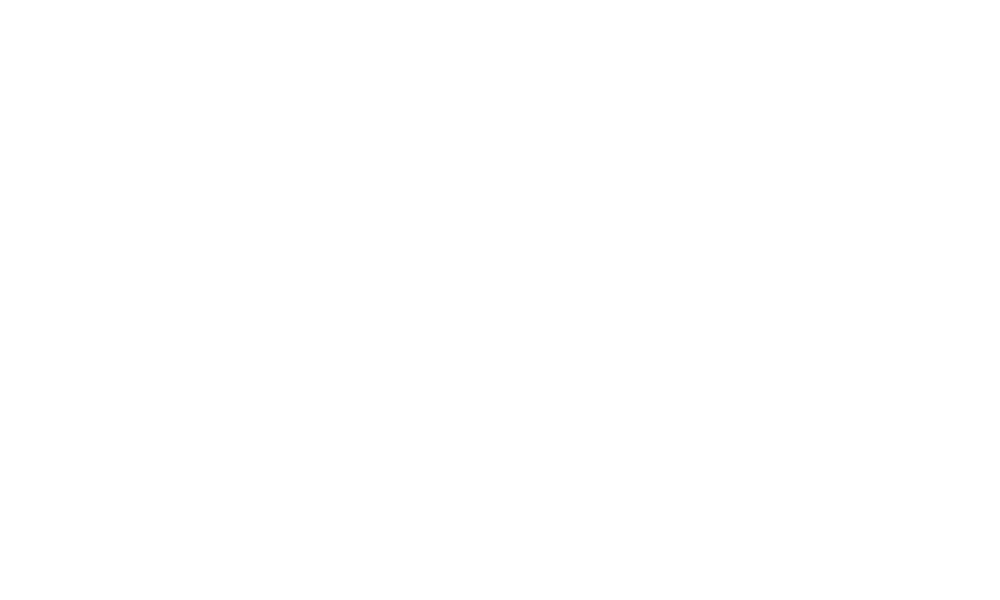

         trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
5835 -0.005489   -1.217946    3.233822    -0.005489    -0.005489   
5836 -0.005492   -1.808260    2.879471    -0.005492    -0.005492   
5837 -0.005495   -2.312523    2.234419    -0.005495    -0.005495   
5838 -0.005498   -3.231500    1.364862    -0.005498    -0.005498   
5839 -0.005501   -3.141056    1.083684    -0.005501    -0.005501   

      additive_terms  additive_terms_lower  additive_terms_upper     daily  \
5835        0.943027              0.943027              0.943027  0.960847   
5836        0.541262              0.541262              0.541262  0.589435   
5837       -0.139827             -0.139827             -0.139827 -0.070320   
5838       -0.769887             -0.769887             -0.769887 -0.689971   
5839       -1.052574             -1.052574             -1.052574 -0.973883   

      daily_lower  daily_upper    yearly  yearly_lower  yearly_upper      yhat  
5835     0.960847     0.960847  0.029539 

<IPython.core.display.Javascript object>


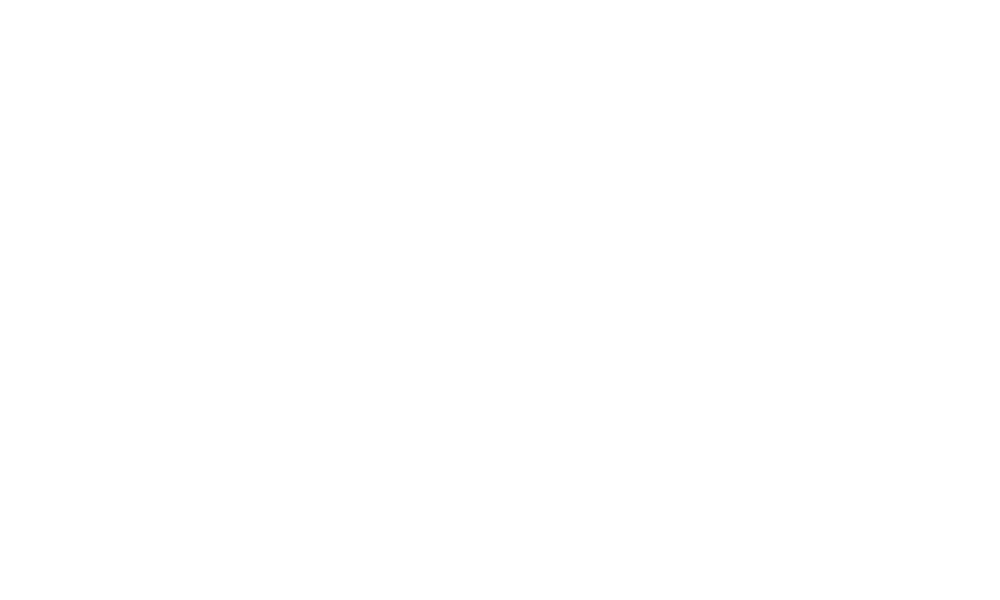

         trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
5835 -0.025746   -1.632798    1.616067    -0.025746    -0.025746   
5836 -0.025764   -1.528703    1.676281    -0.025764    -0.025764   
5837 -0.025782   -1.527585    1.533592    -0.025782    -0.025782   
5838 -0.025800   -1.896275    1.557913    -0.025800    -0.025800   
5839 -0.025818   -1.632315    1.583496    -0.025818    -0.025818   

      additive_terms  additive_terms_lower  additive_terms_upper     daily  \
5835        0.068417              0.068417              0.068417  0.012295   
5836        0.030729              0.030729              0.030729  0.009137   
5837       -0.010085             -0.010085             -0.010085  0.001526   
5838       -0.046367             -0.046367             -0.046367 -0.006718   
5839       -0.070492             -0.070492             -0.070492 -0.011191   

      daily_lower  daily_upper    yearly  yearly_lower  yearly_upper      yhat  
5835     0.012295     0.012295  0.006030 

<IPython.core.display.Javascript object>


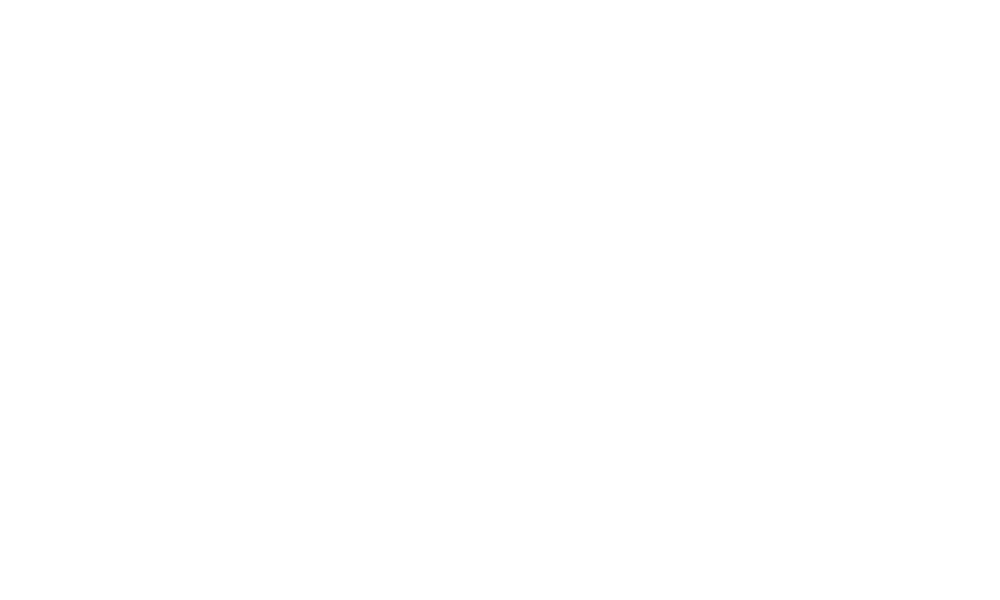

         trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
5835  0.033194   -1.585725    2.139823     0.033194     0.033194   
5836  0.033209   -1.702033    2.077426     0.033209     0.033209   
5837  0.033224   -1.721648    2.185214     0.033224     0.033224   
5838  0.033239   -1.622049    1.997817     0.033239     0.033239   
5839  0.033253   -1.825908    1.921291     0.033253     0.033253   

      additive_terms  additive_terms_lower  additive_terms_upper     daily  \
5835        0.239546              0.239546              0.239546 -0.000141   
5836        0.217155              0.217155              0.217155  0.000164   
5837        0.193589              0.193589              0.193589  0.000580   
5838        0.169516              0.169516              0.169516  0.000986   
5839        0.145702              0.145702              0.145702  0.001442   

      daily_lower  daily_upper    yearly  yearly_lower  yearly_upper      yhat  
5835    -0.000141    -0.000141 -0.006509 

<IPython.core.display.Javascript object>


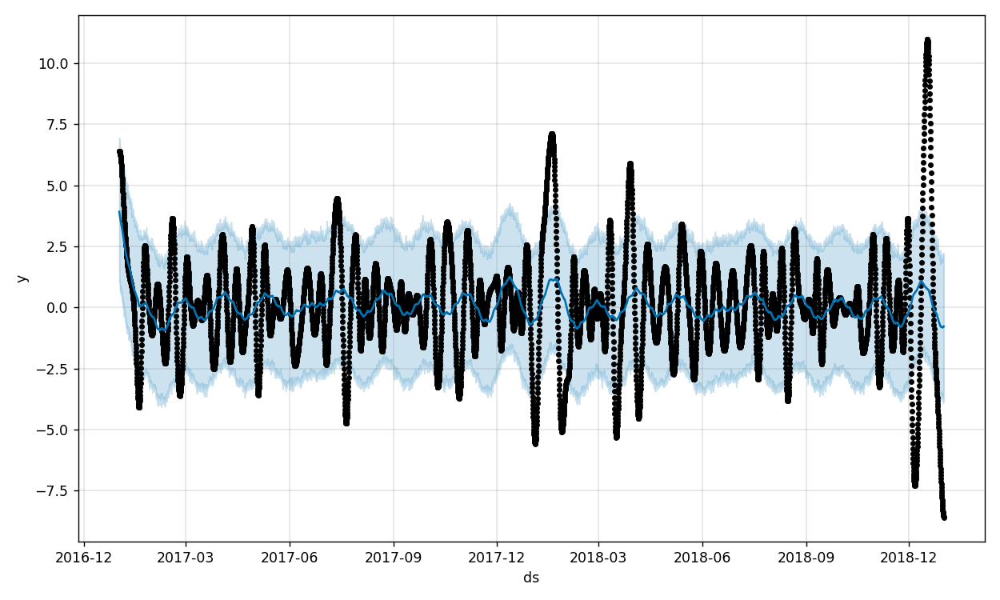

         trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
5835 -0.054691   -3.891896    1.931747    -0.054691    -0.054691   
5836 -0.054746   -3.584497    1.962619    -0.054746    -0.054746   
5837 -0.054802   -3.633118    2.196789    -0.054802    -0.054802   
5838 -0.054857   -3.472995    2.230484    -0.054857    -0.054857   
5839 -0.054912   -3.830477    1.891584    -0.054912    -0.054912   

      additive_terms  additive_terms_lower  additive_terms_upper     daily  \
5835       -0.745130             -0.745130             -0.745130  0.000927   
5836       -0.740438             -0.740438             -0.740438 -0.000813   
5837       -0.734281             -0.734281             -0.734281 -0.002612   
5838       -0.726909             -0.726909             -0.726909 -0.004424   
5839       -0.718735             -0.718735             -0.718735 -0.006244   

      daily_lower  daily_upper    yearly  yearly_lower  yearly_upper      yhat  
5835     0.000927     0.000927 -0.748104 

<IPython.core.display.Javascript object>


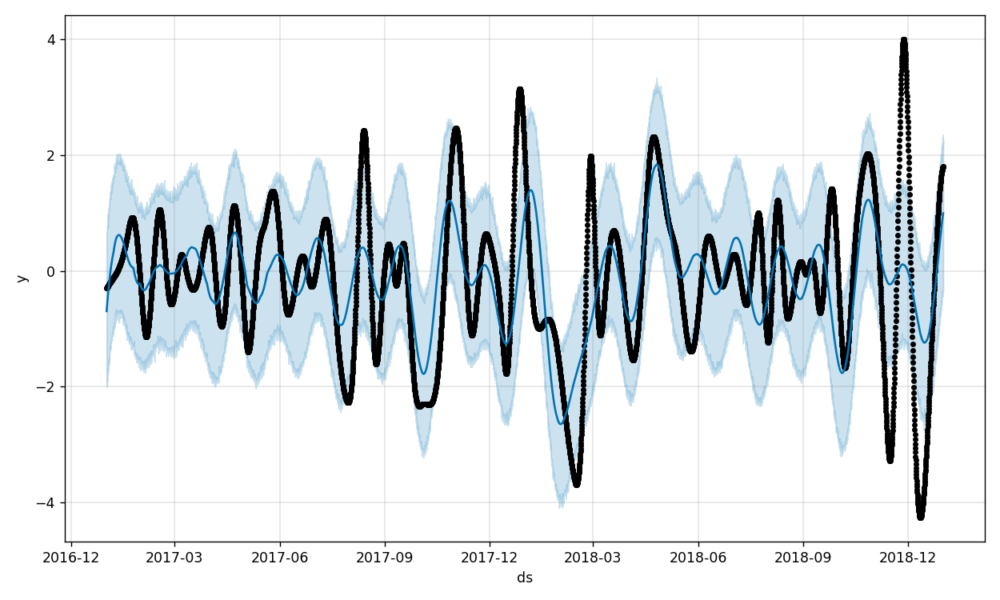

         trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
5835 -0.187511   -0.345040    2.305825    -0.187511    -0.187511   
5836 -0.187506   -0.344434    2.312285    -0.187506    -0.187506   
5837 -0.187501   -0.332744    2.347151    -0.187501    -0.187501   
5838 -0.187496   -0.372965    2.192247    -0.187496    -0.187496   
5839 -0.187491   -0.359726    2.256291    -0.187491    -0.187491   

      additive_terms  additive_terms_lower  additive_terms_upper     daily  \
5835        1.110183              1.110183              1.110183 -0.000066   
5836        1.128681              1.128681              1.128681  0.000023   
5837        1.146741              1.146741              1.146741  0.000103   
5838        1.164419              1.164419              1.164419  0.000192   
5839        1.181737              1.181737              1.181737  0.000265   

      daily_lower  daily_upper    yearly  yearly_lower  yearly_upper      yhat  
5835    -0.000066    -0.000066  1.103968 

<IPython.core.display.Javascript object>


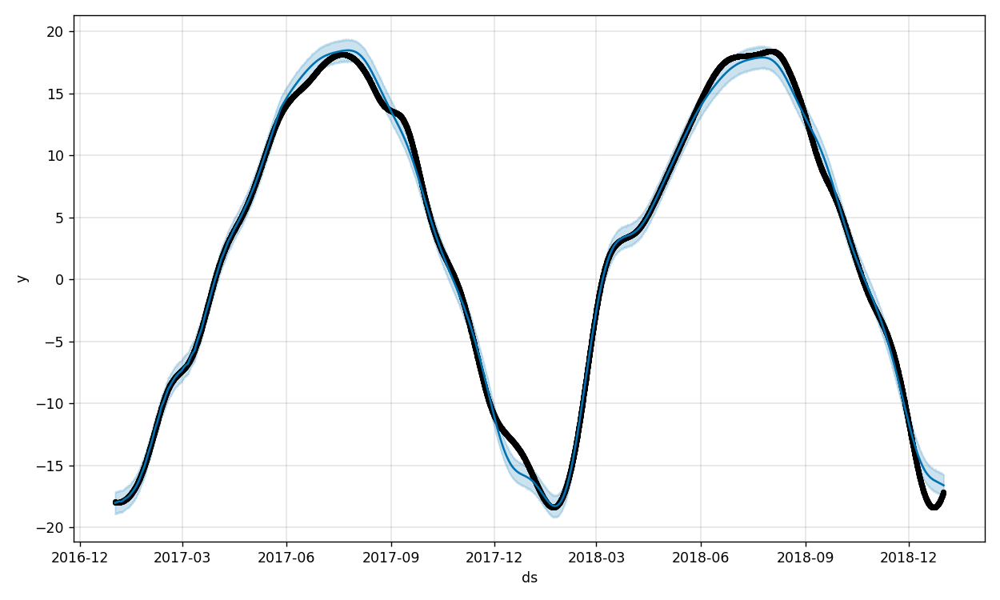

         trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
5835  2.280160  -17.471729  -15.737121     2.280160     2.280160   
5836  2.279965  -17.486546  -15.757043     2.279965     2.279965   
5837  2.279771  -17.480296  -15.763187     2.279771     2.279771   
5838  2.279576  -17.462104  -15.724829     2.279576     2.279576   
5839  2.279381  -17.509078  -15.743333     2.279381     2.279381   

      additive_terms  additive_terms_lower  additive_terms_upper     daily  \
5835      -18.870541            -18.870541            -18.870541  0.000012   
5836      -18.877348            -18.877348            -18.877348 -0.000075   
5837      -18.884193            -18.884193            -18.884193 -0.000174   
5838      -18.891049            -18.891049            -18.891049 -0.000231   
5839      -18.898015            -18.898015            -18.898015 -0.000315   

      daily_lower  daily_upper     yearly  yearly_lower  yearly_upper  \
5835     0.000012     0.000012 -18.869922    -18.

<IPython.core.display.Javascript object>


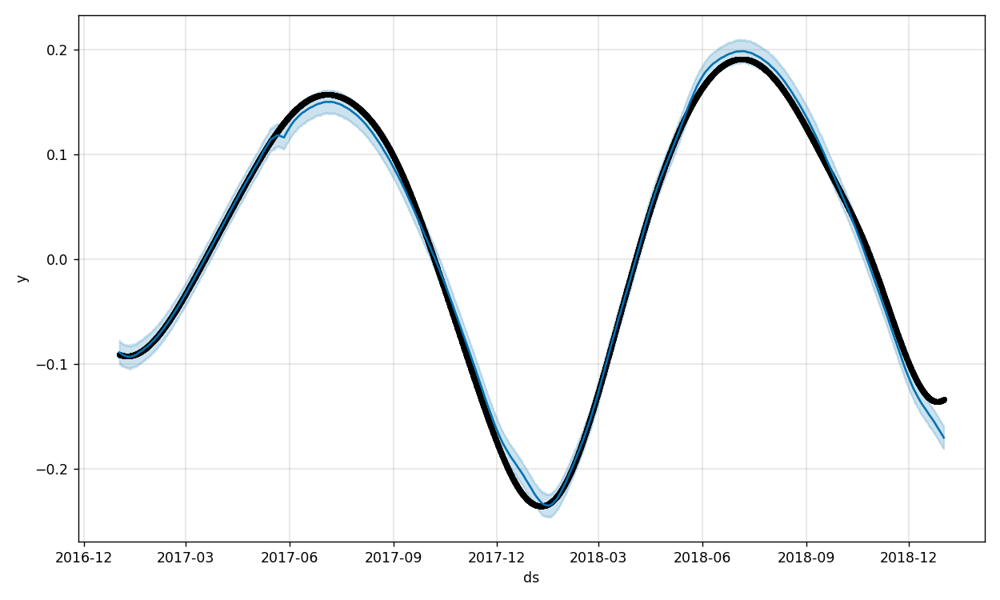

         trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
5835  0.039199   -0.180115   -0.158543     0.039199     0.039199   
5836  0.039216   -0.180238   -0.160074     0.039216     0.039216   
5837  0.039232   -0.180664   -0.158787     0.039232     0.039232   
5838  0.039249   -0.181429   -0.159599     0.039249     0.039249   
5839  0.039265   -0.181191   -0.158962     0.039265     0.039265   

      additive_terms  additive_terms_lower  additive_terms_upper     daily  \
5835       -0.208703             -0.208703             -0.208703 -0.000004   
5836       -0.208959             -0.208959             -0.208959  0.000003   
5837       -0.209223             -0.209223             -0.209223  0.000009   
5838       -0.209490             -0.209490             -0.209490  0.000017   
5839       -0.209762             -0.209762             -0.209762  0.000024   

      daily_lower  daily_upper    yearly  yearly_lower  yearly_upper      yhat  
5835    -0.000004    -0.000004 -0.208829 

<IPython.core.display.Javascript object>


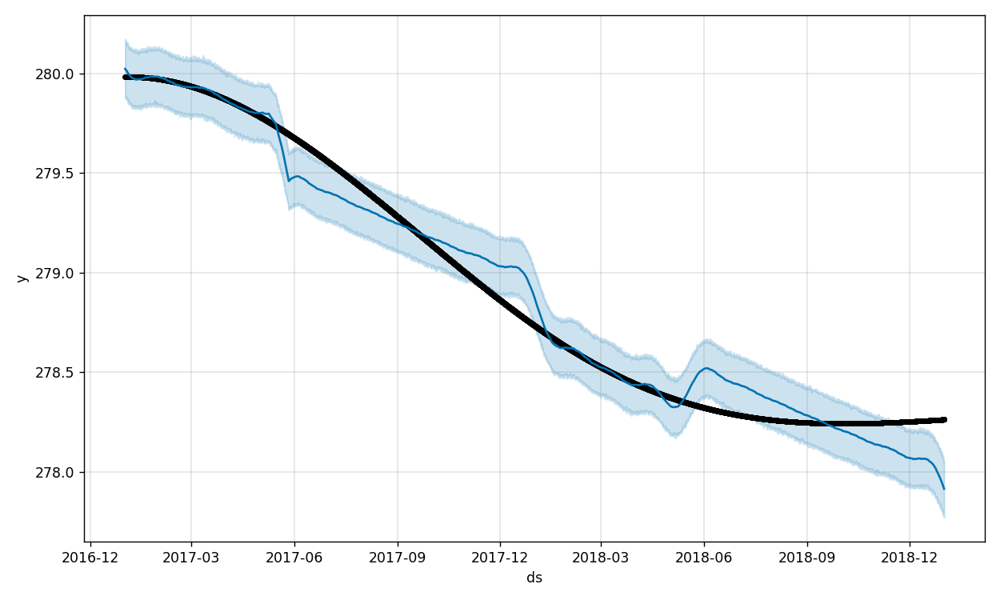

           trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
5835  277.878291  277.788253  278.070756   277.878291   277.878291   
5836  277.877961  277.779356  278.060174   277.877961   277.877961   
5837  277.877631  277.785912  278.057241   277.877631   277.877631   
5838  277.877302  277.783440  278.046237   277.877302   277.877302   
5839  277.876972  277.768519  278.051250   277.876972   277.876972   

      additive_terms  additive_terms_lower  additive_terms_upper     daily  \
5835        0.044500              0.044500              0.044500 -0.000049   
5836        0.042692              0.042692              0.042692  0.000038   
5837        0.040779              0.040779              0.040779  0.000090   
5838        0.038844              0.038844              0.038844  0.000179   
5839        0.036831              0.036831              0.036831  0.000233   

      daily_lower  daily_upper    yearly  yearly_lower  yearly_upper  \
5835    -0.000049    -0.000049  0.0434

<IPython.core.display.Javascript object>


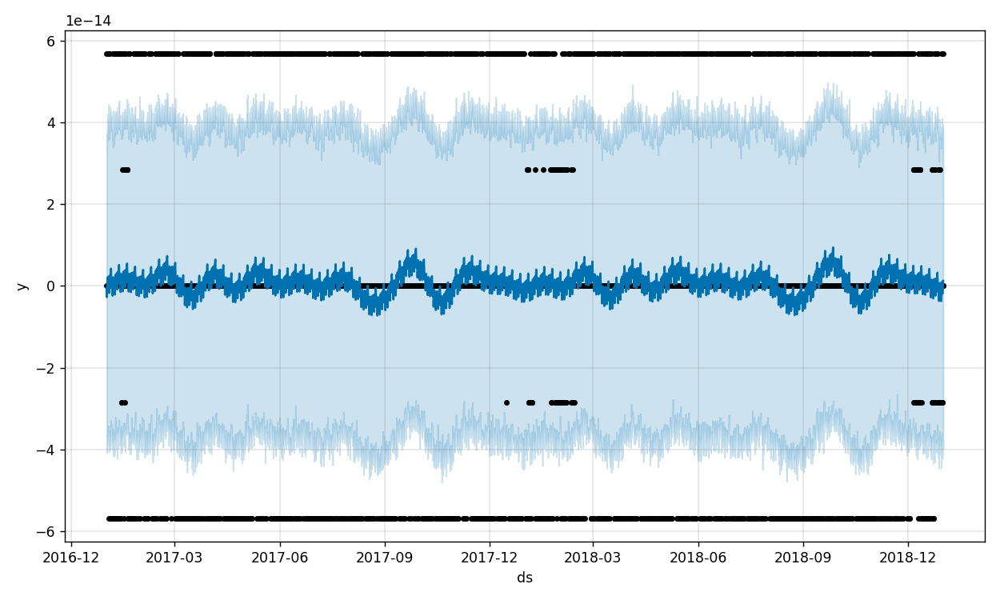

             trend    yhat_lower    yhat_upper   trend_lower   trend_upper  \
5835  1.085346e-15 -3.701090e-14  3.794812e-14  1.085346e-15  1.085346e-15   
5836  1.085398e-15 -3.846166e-14  3.716577e-14  1.085398e-15  1.085398e-15   
5837  1.085451e-15 -4.028577e-14  3.956020e-14  1.085451e-15  1.085451e-15   
5838  1.085503e-15 -3.745185e-14  3.908030e-14  1.085503e-15  1.085503e-15   
5839  1.085555e-15 -4.003407e-14  3.830598e-14  1.085555e-15  1.085555e-15   

      additive_terms  additive_terms_lower  additive_terms_upper  \
5835   -1.410777e-15         -1.410777e-15         -1.410777e-15   
5836   -1.514497e-15         -1.514497e-15         -1.514497e-15   
5837   -3.771040e-16         -3.771040e-16         -3.771040e-16   
5838   -1.930130e-18         -1.930130e-18         -1.930130e-18   
5839    1.919095e-16          1.919095e-16          1.919095e-16   

             daily   daily_lower   daily_upper        yearly  yearly_lower  \
5835 -6.102713e-16 -6.102713e-16 -6.102713e-

<IPython.core.display.Javascript object>


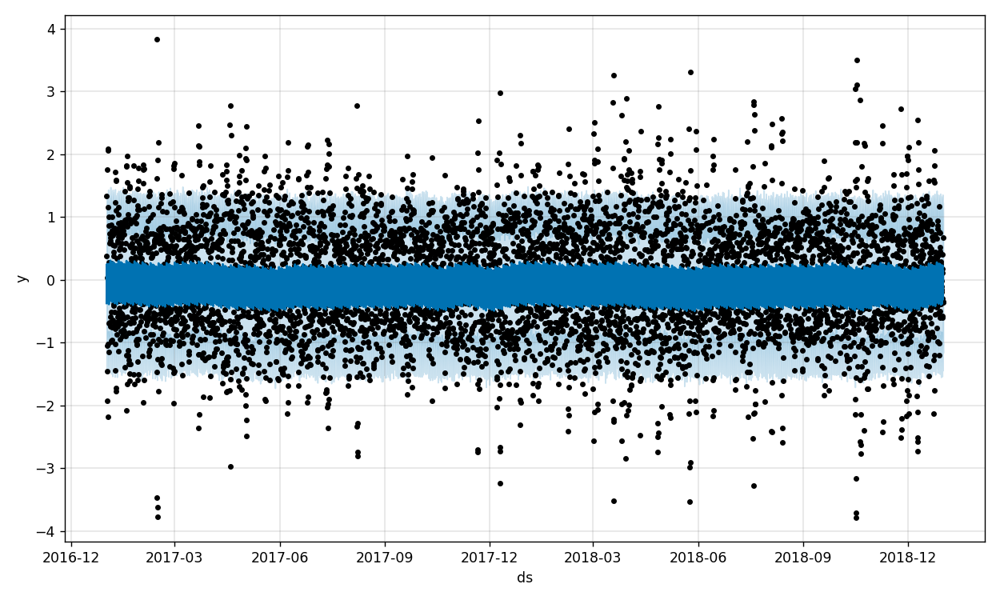

         trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
5835 -0.009971   -0.836116    1.357123    -0.009971    -0.009971   
5836 -0.009972   -1.442629    0.821631    -0.009972    -0.009972   
5837 -0.009973   -1.089785    1.122966    -0.009973    -0.009973   
5838 -0.009974   -0.998432    1.231966    -0.009974    -0.009974   
5839 -0.009975   -1.159831    1.011979    -0.009975    -0.009975   

      additive_terms  additive_terms_lower  additive_terms_upper     daily  \
5835        0.240549              0.240549              0.240549  0.215216   
5836       -0.308286             -0.308286             -0.308286 -0.328018   
5837        0.051777              0.051777              0.051777  0.037766   
5838        0.155495              0.155495              0.155495  0.146594   
5839        0.010202              0.010202              0.010202  0.005078   

      daily_lower  daily_upper    yearly  yearly_lower  yearly_upper      yhat  
5835     0.215216     0.215216  0.039369 

<IPython.core.display.Javascript object>


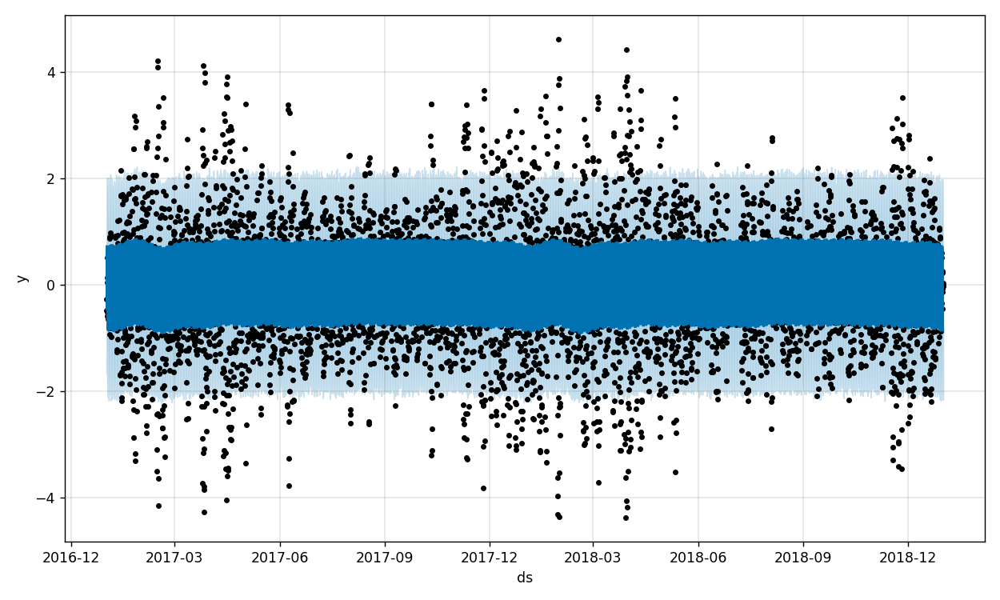

         trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
5835 -0.038995   -0.647165    1.795906    -0.038995    -0.038995   
5836 -0.038997   -1.145063    1.309858    -0.038997    -0.038997   
5837 -0.038998   -1.700183    0.724706    -0.038998    -0.038998   
5838 -0.039000   -2.165579    0.429186    -0.039000    -0.039000   
5839 -0.039001   -2.022623    0.426035    -0.039001    -0.039001   

      additive_terms  additive_terms_lower  additive_terms_upper     daily  \
5835        0.649444              0.649444              0.649444  0.734173   
5836        0.112179              0.112179              0.112179  0.199970   
5837       -0.444370             -0.444370             -0.444370 -0.354989   
5838       -0.785324             -0.785324             -0.785324 -0.696010   
5839       -0.825441             -0.825441             -0.825441 -0.737845   

      daily_lower  daily_upper    yearly  yearly_lower  yearly_upper      yhat  
5835     0.734173     0.734173 -0.069409 

<IPython.core.display.Javascript object>


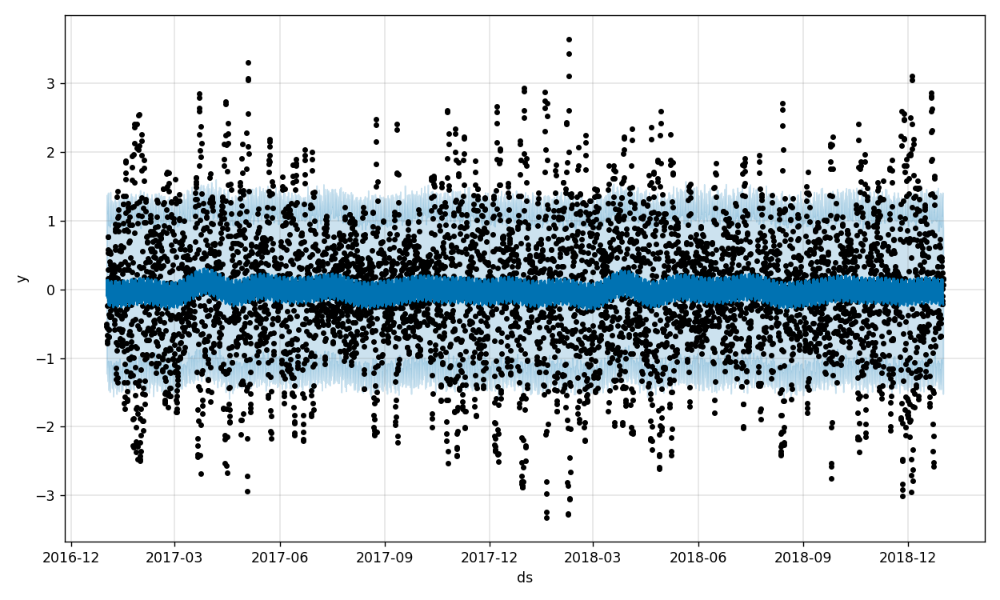

         trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
5835 -0.028785   -1.072946    1.405453    -0.028785    -0.028785   
5836 -0.028787   -1.144028    1.221992    -0.028787    -0.028787   
5837 -0.028788   -1.375109    1.107967    -0.028788    -0.028788   
5838 -0.028790   -1.522578    0.951755    -0.028790    -0.028790   
5839 -0.028792   -1.462460    0.895706    -0.028792    -0.028792   

      additive_terms  additive_terms_lower  additive_terms_upper     daily  \
5835        0.143664              0.143664              0.143664  0.134817   
5836        0.032603              0.032603              0.032603  0.041780   
5837       -0.100394             -0.100394             -0.100394 -0.072936   
5838       -0.189833             -0.189833             -0.189833 -0.145069   
5839       -0.193721             -0.193721             -0.193721 -0.133769   

      daily_lower  daily_upper    yearly  yearly_lower  yearly_upper      yhat  
5835     0.134817     0.134817 -0.020467 

<IPython.core.display.Javascript object>


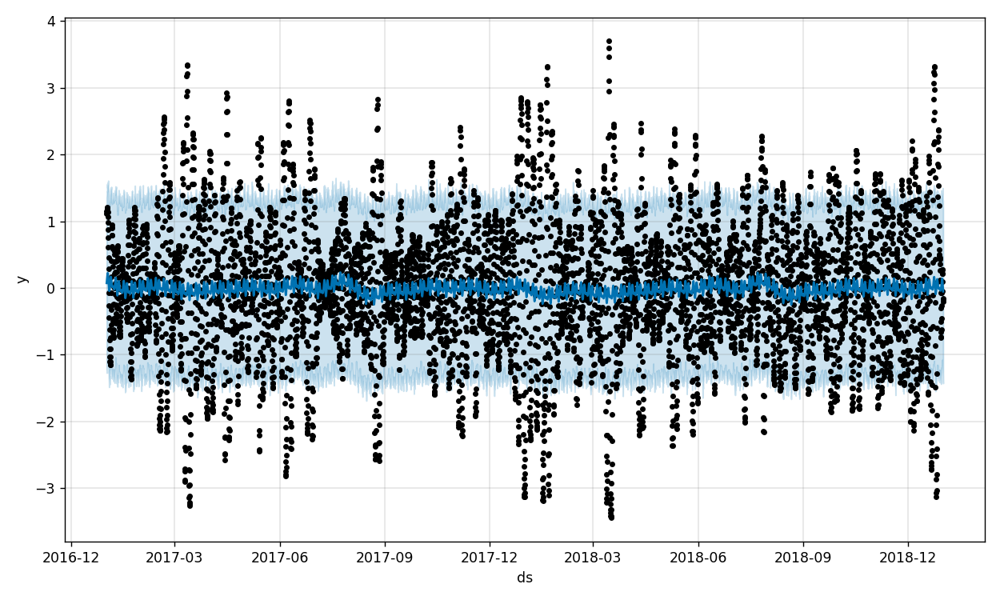

         trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
5835 -0.024055   -1.325160    1.439325    -0.024055    -0.024055   
5836 -0.024054   -1.275145    1.496249    -0.024054    -0.024054   
5837 -0.024054   -1.254838    1.258389    -0.024054    -0.024054   
5838 -0.024054   -1.397352    1.316736    -0.024054    -0.024054   
5839 -0.024053   -1.428371    1.172875    -0.024053    -0.024053   

      additive_terms  additive_terms_lower  additive_terms_upper     daily  \
5835        0.113804              0.113804              0.113804 -0.000117   
5836        0.081402              0.081402              0.081402 -0.000295   
5837        0.044756              0.044756              0.044756 -0.000341   
5838        0.006688              0.006688              0.006688 -0.000401   
5839       -0.029660             -0.029660             -0.029660 -0.000479   

      daily_lower  daily_upper    yearly  yearly_lower  yearly_upper      yhat  
5835    -0.000117    -0.000117  0.031913 

<IPython.core.display.Javascript object>


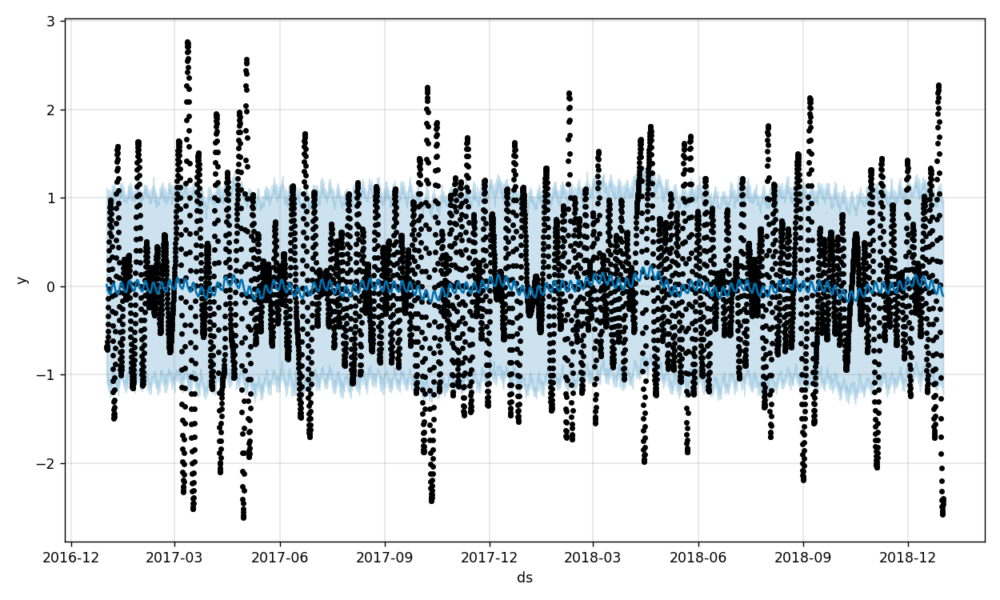

         trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
5835 -0.004852   -1.116385    0.963839    -0.004852    -0.004852   
5836 -0.004852   -1.218296    0.956618    -0.004852    -0.004852   
5837 -0.004852   -1.151123    0.910032    -0.004852    -0.004852   
5838 -0.004852   -1.152168    0.995825    -0.004852    -0.004852   
5839 -0.004852   -1.224408    0.948938    -0.004852    -0.004852   

      additive_terms  additive_terms_lower  additive_terms_upper     daily  \
5835       -0.093047             -0.093047             -0.093047  0.000170   
5836       -0.096402             -0.096402             -0.096402 -0.000106   
5837       -0.099419             -0.099419             -0.099419 -0.000408   
5838       -0.102218             -0.102218             -0.102218 -0.000700   
5839       -0.104943             -0.104943             -0.104943 -0.000983   

      daily_lower  daily_upper    yearly  yearly_lower  yearly_upper      yhat  
5835     0.000170     0.000170 -0.061242 

<IPython.core.display.Javascript object>


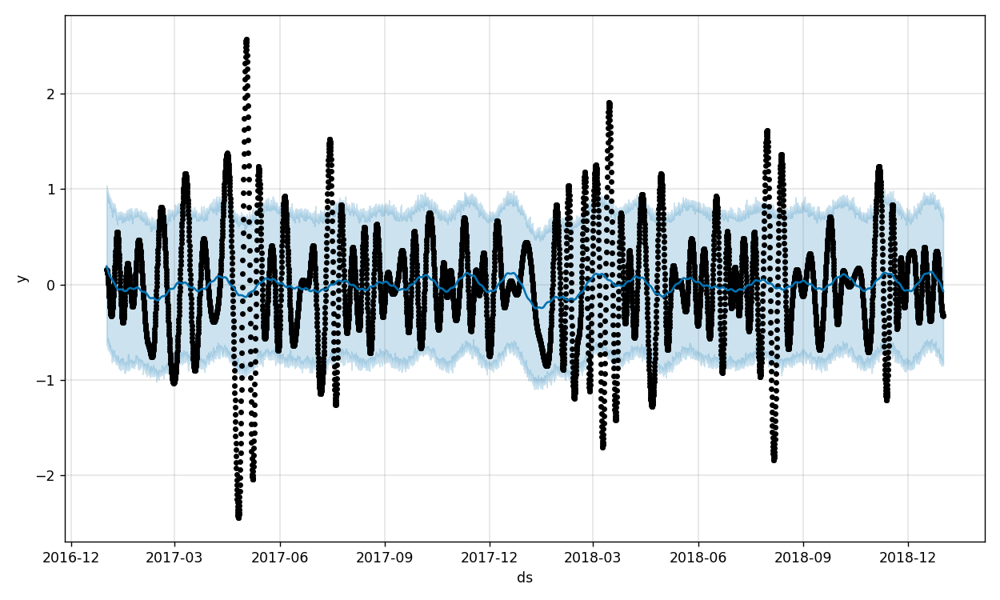

         trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
5835 -0.010727   -0.842300    0.768591    -0.010727    -0.010727   
5836 -0.010725   -0.821386    0.700370    -0.010725    -0.010725   
5837 -0.010723   -0.828226    0.807556    -0.010723    -0.010723   
5838 -0.010720   -0.849139    0.668322    -0.010720    -0.010720   
5839 -0.010718   -0.830461    0.735779    -0.010718    -0.010718   

      additive_terms  additive_terms_lower  additive_terms_upper     daily  \
5835       -0.042082             -0.042082             -0.042082  0.000016   
5836       -0.046007             -0.046007             -0.046007 -0.000018   
5837       -0.049855             -0.049855             -0.049855 -0.000057   
5838       -0.053623             -0.053623             -0.053623 -0.000090   
5839       -0.057327             -0.057327             -0.057327 -0.000128   

      daily_lower  daily_upper    yearly  yearly_lower  yearly_upper      yhat  
5835     0.000016     0.000016 -0.037281 

<IPython.core.display.Javascript object>


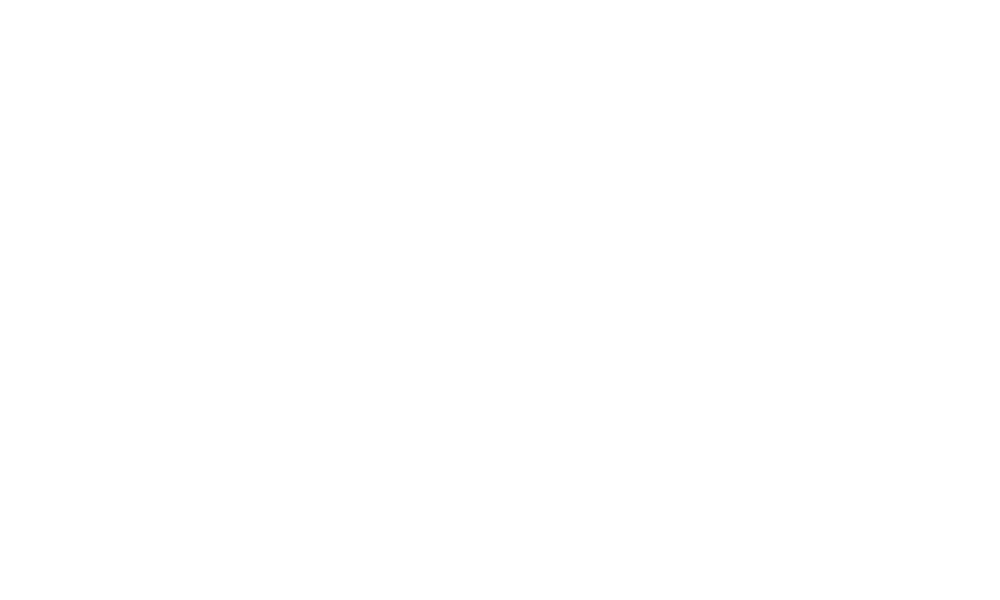

         trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
5835  0.034786   -0.466705    0.550670     0.034786     0.034786   
5836  0.034798   -0.455661    0.517036     0.034798     0.034798   
5837  0.034810   -0.439255    0.521250     0.034810     0.034810   
5838  0.034822   -0.413840    0.525689     0.034822     0.034822   
5839  0.034834   -0.405367    0.547061     0.034834     0.034834   

      additive_terms  additive_terms_lower  additive_terms_upper     daily  \
5835       -0.005756             -0.005756             -0.005756 -0.000096   
5836       -0.001844             -0.001844             -0.001844  0.000085   
5837        0.002005              0.002005              0.002005  0.000260   
5838        0.005813              0.005813              0.005813  0.000454   
5839        0.009560              0.009560              0.009560  0.000640   

      daily_lower  daily_upper    yearly  yearly_lower  yearly_upper      yhat  
5835    -0.000096    -0.000096 -0.004748 

<IPython.core.display.Javascript object>


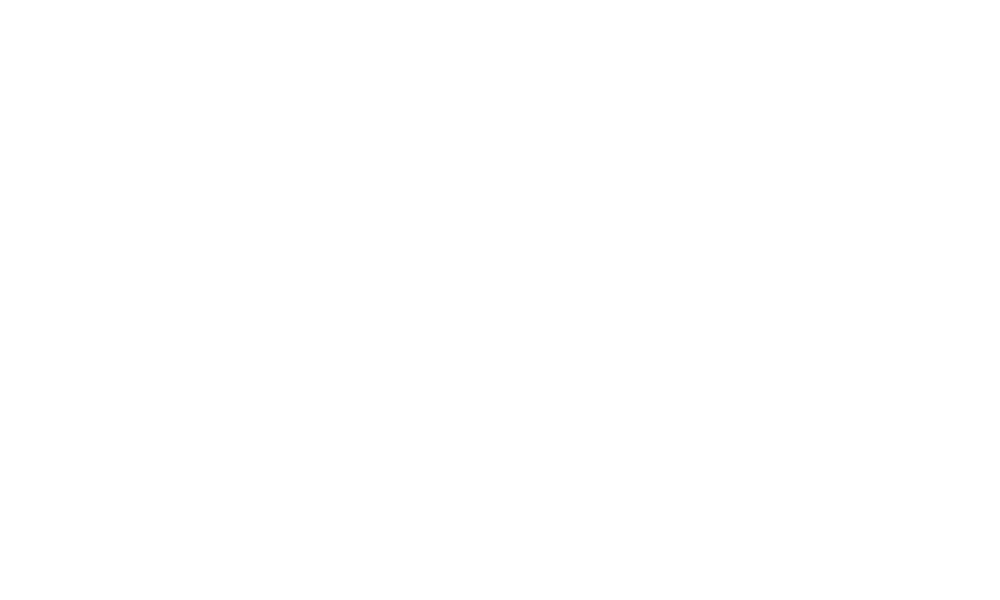

         trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
5835  0.043749    0.099925    0.375591     0.043749     0.043749   
5836  0.043759    0.100979    0.380128     0.043759     0.043759   
5837  0.043769    0.127243    0.396487     0.043769     0.043769   
5838  0.043780    0.118976    0.400234     0.043780     0.043780   
5839  0.043790    0.133995    0.404494     0.043790     0.043790   

      additive_terms  additive_terms_lower  additive_terms_upper     daily  \
5835        0.199837              0.199837              0.199837  0.000057   
5836        0.204804              0.204804              0.204804 -0.000042   
5837        0.209890              0.209890              0.209890 -0.000135   
5838        0.215057              0.215057              0.215057 -0.000245   
5839        0.220312              0.220312              0.220312 -0.000343   

      daily_lower  daily_upper    yearly  yearly_lower  yearly_upper      yhat  
5835     0.000057     0.000057  0.201559 

<IPython.core.display.Javascript object>


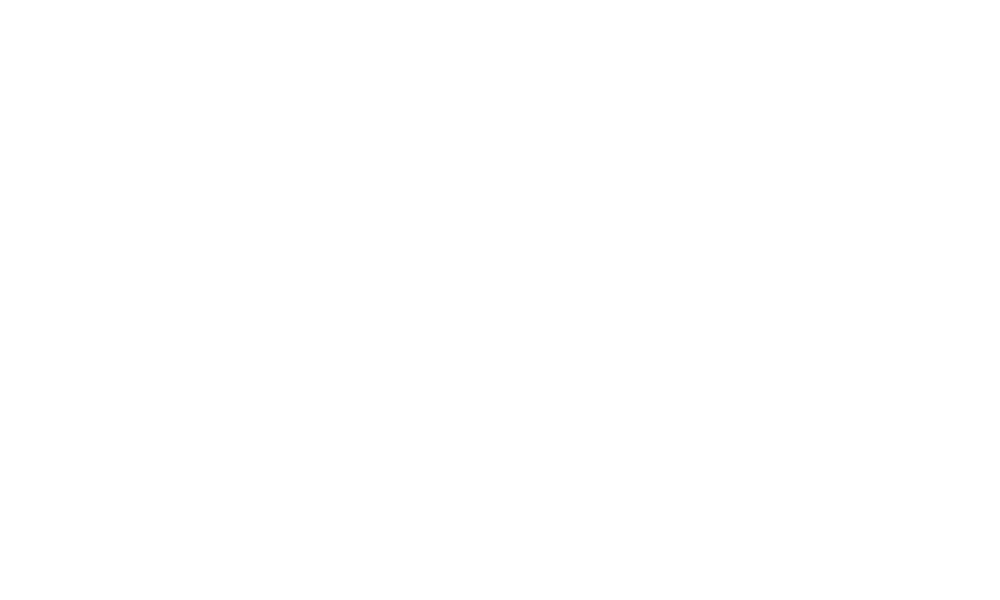

         trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
5835 -0.017585   -0.081024    0.041055    -0.017585    -0.017585   
5836 -0.017594   -0.087964    0.043805    -0.017594    -0.017594   
5837 -0.017602   -0.081728    0.041426    -0.017602    -0.017602   
5838 -0.017611   -0.082715    0.042018    -0.017611    -0.017611   
5839 -0.017620   -0.085687    0.037169    -0.017620    -0.017620   

      additive_terms  additive_terms_lower  additive_terms_upper     daily  \
5835       -0.001509             -0.001509             -0.001509 -0.000005   
5836       -0.001986             -0.001986             -0.001986  0.000005   
5837       -0.002468             -0.002468             -0.002468  0.000015   
5838       -0.002958             -0.002958             -0.002958  0.000024   
5839       -0.003455             -0.003455             -0.003455  0.000035   

      daily_lower  daily_upper    yearly  yearly_lower  yearly_upper      yhat  
5835    -0.000005    -0.000005 -0.001472 

<IPython.core.display.Javascript object>


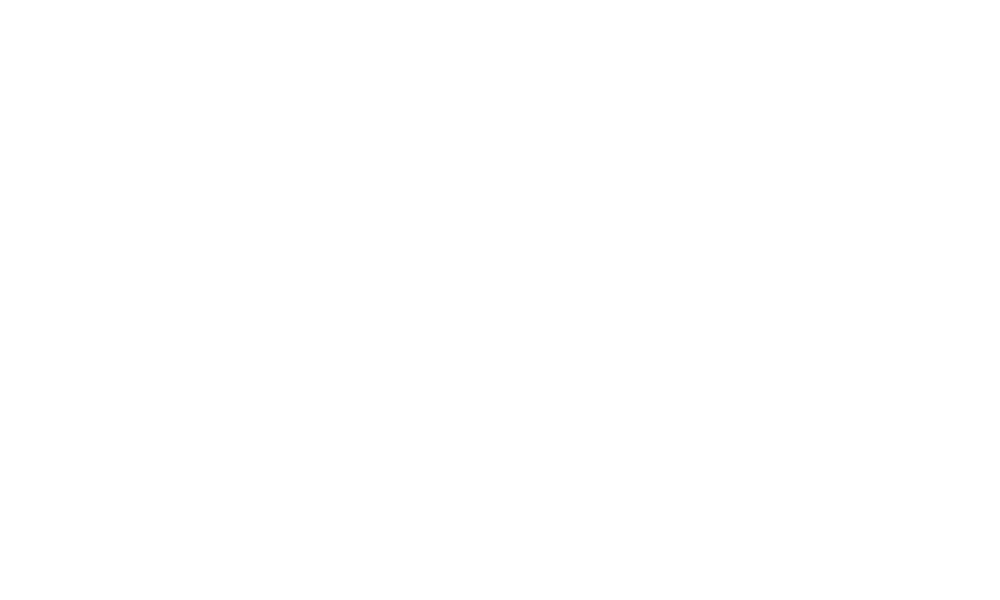

         trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
5835  0.165245    0.237761    0.533073     0.165245     0.165245   
5836  0.165294    0.236263    0.535280     0.165294     0.165294   
5837  0.165342    0.242600    0.535942     0.165342     0.165342   
5838  0.165390    0.246083    0.541320     0.165390     0.165390   
5839  0.165438    0.231780    0.533739     0.165438     0.165438   

      additive_terms  additive_terms_lower  additive_terms_upper     daily  \
5835        0.218792              0.218792              0.218792  0.000013   
5836        0.220283              0.220283              0.220283 -0.000019   
5837        0.221801              0.221801              0.221801 -0.000061   
5838        0.223361              0.223361              0.223361 -0.000093   
5839        0.224935              0.224935              0.224935 -0.000134   

      daily_lower  daily_upper    yearly  yearly_lower  yearly_upper      yhat  
5835     0.000013     0.000013  0.219444 

<IPython.core.display.Javascript object>


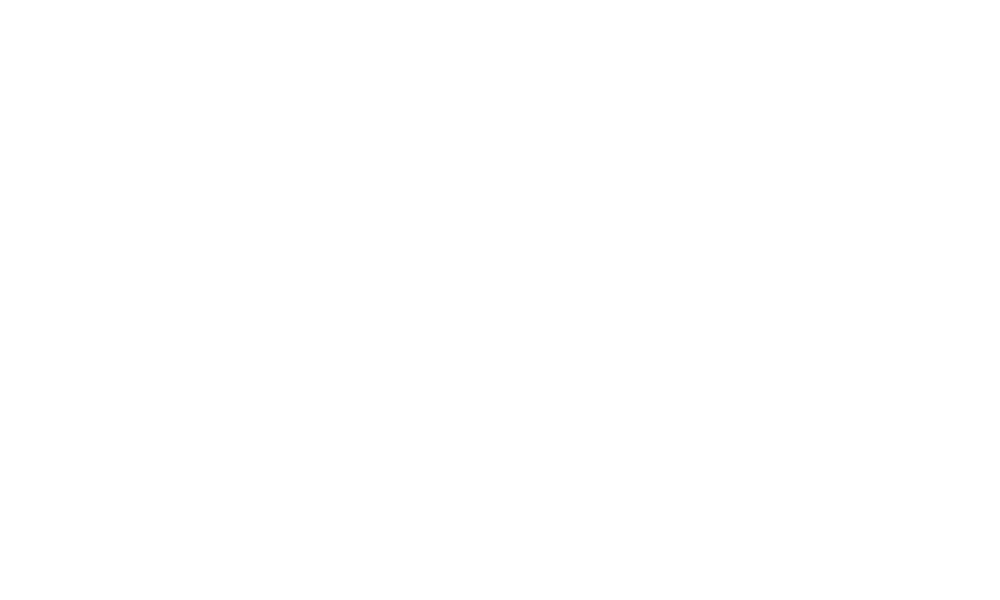

         trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
5835  3.930609    3.881033    3.967397     3.930609     3.930609   
5836  3.930535    3.878900    3.968087     3.930535     3.930535   
5837  3.930460    3.881759    3.971182     3.930460     3.930460   
5838  3.930385    3.884168    3.968449     3.930385     3.930385   
5839  3.930310    3.882130    3.973785     3.930310     3.930310   

      additive_terms  additive_terms_lower  additive_terms_upper     daily  \
5835       -0.005392             -0.005392             -0.005392  0.000010   
5836       -0.004778             -0.004778             -0.004778 -0.000007   
5837       -0.004149             -0.004149             -0.004149 -0.000027   
5838       -0.003501             -0.003501             -0.003501 -0.000045   
5839       -0.002845             -0.002845             -0.002845 -0.000066   

      daily_lower  daily_upper    yearly  yearly_lower  yearly_upper      yhat  
5835     0.000010     0.000010 -0.005082 

<IPython.core.display.Javascript object>


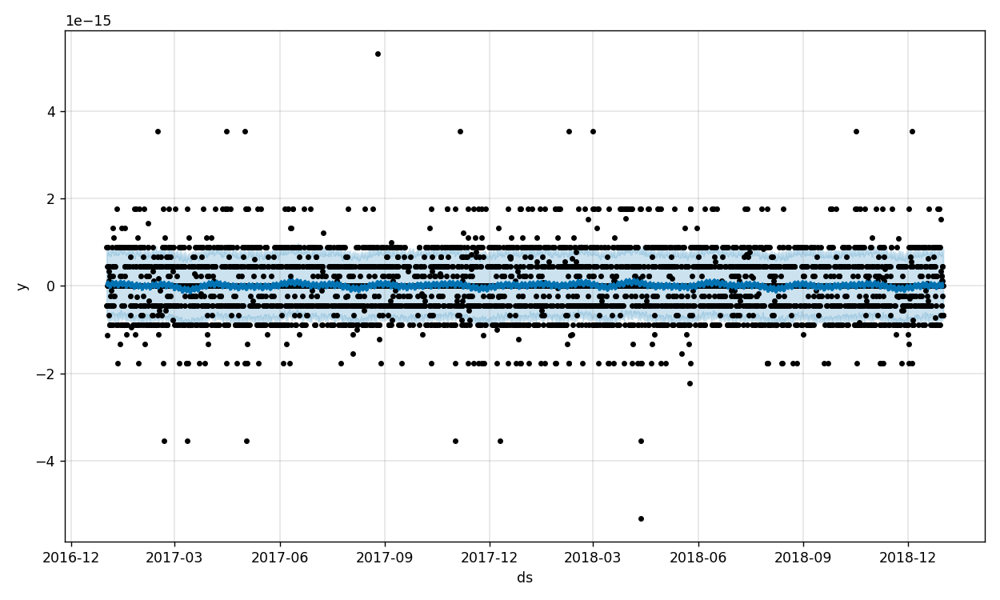

             trend    yhat_lower    yhat_upper   trend_lower   trend_upper  \
5835  1.036572e-17 -6.789432e-16  8.137121e-16  1.036572e-17  1.036572e-17   
5836  1.036349e-17 -7.465287e-16  7.765074e-16  1.036349e-17  1.036349e-17   
5837  1.036127e-17 -7.486913e-16  7.127713e-16  1.036127e-17  1.036127e-17   
5838  1.035905e-17 -7.110312e-16  7.317172e-16  1.035905e-17  1.035905e-17   
5839  1.035682e-17 -7.587134e-16  8.422319e-16  1.035682e-17  1.035682e-17   

      additive_terms  additive_terms_lower  additive_terms_upper  \
5835    6.596569e-17          6.596569e-17          6.596569e-17   
5836    6.376037e-18          6.376037e-18          6.376037e-18   
5837   -2.308559e-17         -2.308559e-17         -2.308559e-17   
5838   -4.207129e-17         -4.207129e-17         -4.207129e-17   
5839   -9.826434e-18         -9.826434e-18         -9.826434e-18   

             daily   daily_lower   daily_upper        yearly  yearly_lower  \
5835  4.601098e-17  4.601098e-17  4.601098e-

<IPython.core.display.Javascript object>


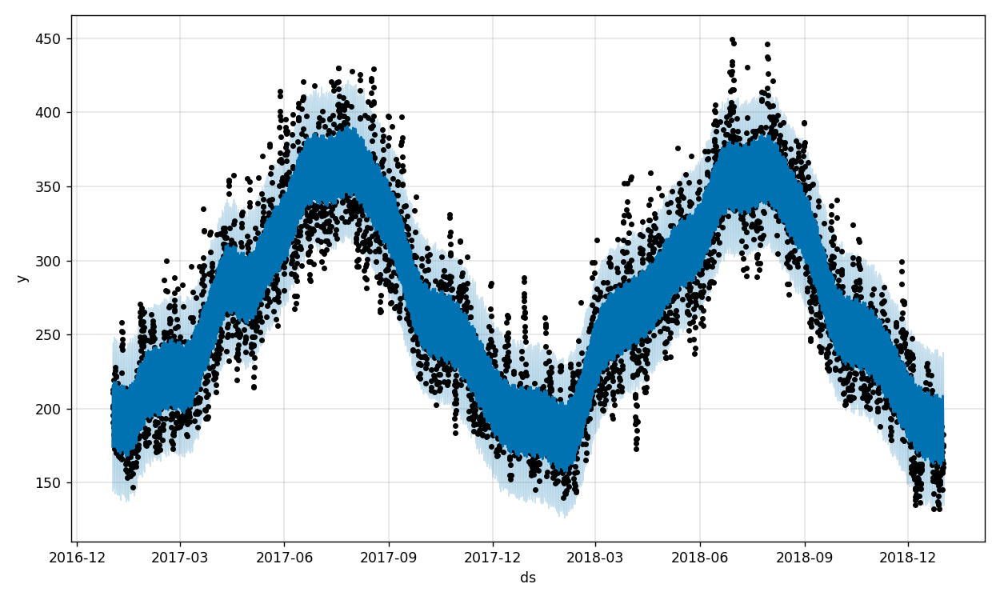

           trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
5835  264.254901  179.559872  238.228510   264.254901   264.254901   
5836  264.253024  166.661937  229.276484   264.253024   264.253024   
5837  264.251147  153.518227  213.121382   264.251147   264.251147   
5838  264.249270  141.881190  201.652353   264.249270   264.249270   
5839  264.247393  134.863247  193.024873   264.247393   264.247393   

      additive_terms  additive_terms_lower  additive_terms_upper      daily  \
5835      -55.601220            -55.601220            -55.601220  23.042836   
5836      -68.293779            -68.293779            -68.293779  10.493126   
5837      -80.877591            -80.877591            -80.877591  -1.913910   
5838      -92.472001            -92.472001            -92.472001 -13.335390   
5839      -99.276805            -99.276805            -99.276805 -20.006560   

      daily_lower  daily_upper     yearly  yearly_lower  yearly_upper  \
5835    23.042836    23.042836 

<IPython.core.display.Javascript object>


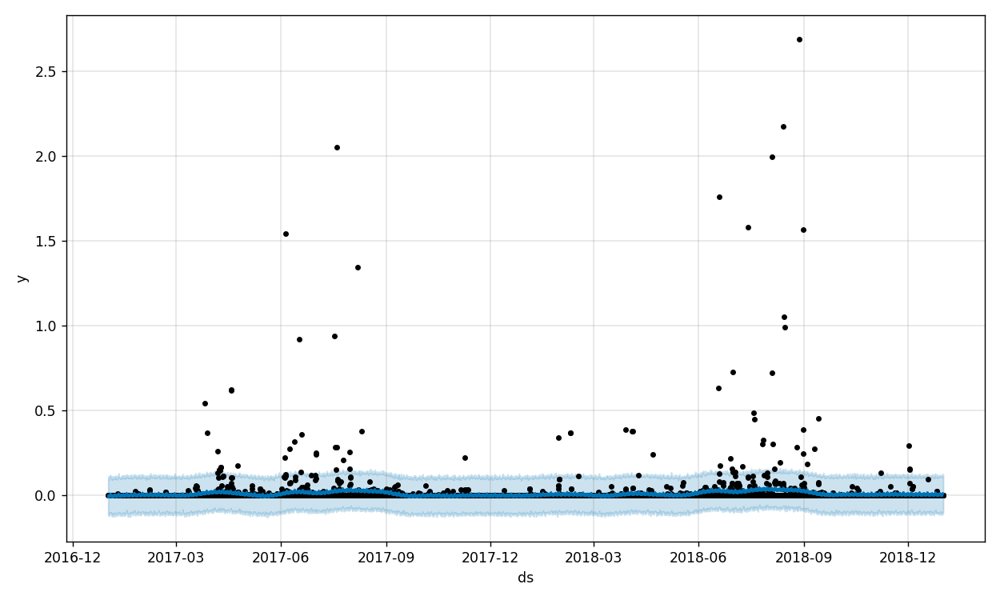

         trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
5835  0.014016   -0.098288    0.123882     0.014016     0.014016   
5836  0.014019   -0.105733    0.120965     0.014019     0.014019   
5837  0.014021   -0.106300    0.111403     0.014021     0.014021   
5838  0.014023   -0.102121    0.123765     0.014023     0.014023   
5839  0.014025   -0.094222    0.112245     0.014025     0.014025   

      additive_terms  additive_terms_lower  additive_terms_upper     daily  \
5835       -0.003689             -0.003689             -0.003689  0.002255   
5836       -0.005402             -0.005402             -0.005402 -0.000970   
5837       -0.004733             -0.004733             -0.004733 -0.001549   
5838       -0.003145             -0.003145             -0.003145 -0.000847   
5839       -0.002560             -0.002560             -0.002560 -0.000723   

      daily_lower  daily_upper    yearly  yearly_lower  yearly_upper      yhat  
5835     0.002255     0.002255 -0.009174 

<IPython.core.display.Javascript object>


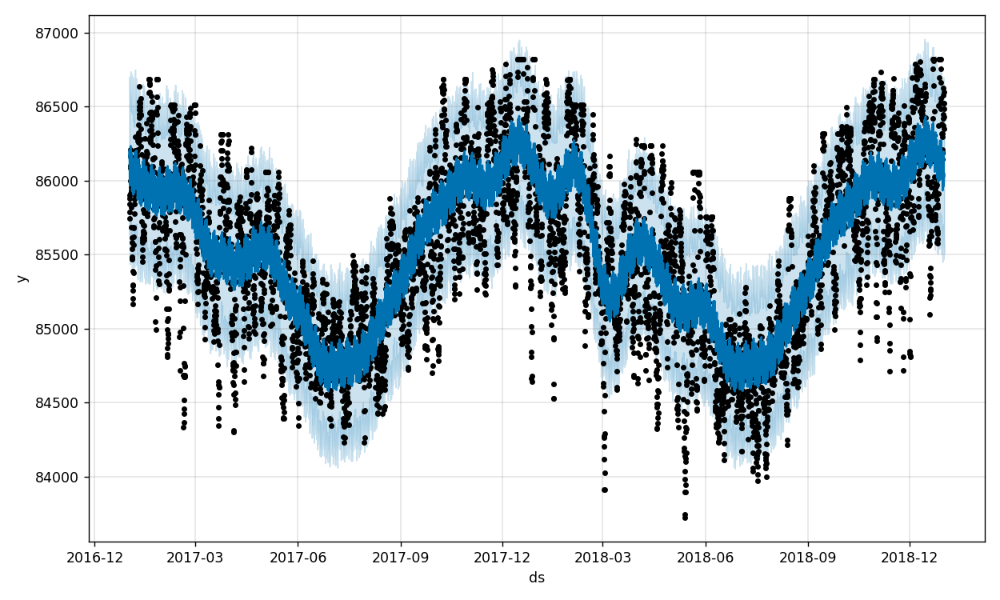

             trend    yhat_lower    yhat_upper   trend_lower   trend_upper  \
5835  85495.353712  85468.433221  86480.576037  85495.353712  85495.353712   
5836  85495.352382  85509.827888  86533.562782  85495.352382  85495.352382   
5837  85495.351052  85562.825655  86523.695658  85495.351052  85495.351052   
5838  85495.349723  85533.446319  86534.291517  85495.349723  85495.349723   
5839  85495.348393  85509.854419  86504.728050  85495.348393  85495.348393   

      additive_terms  additive_terms_lower  additive_terms_upper       daily  \
5835      466.421064            466.421064            466.421064 -105.949694   
5836      489.720369            489.720369            489.720369  -78.984288   
5837      548.194972            548.194972            548.194972  -14.103041   
5838      555.116065            555.116065            555.116065    1.649248   
5839      534.964357            534.964357            534.964357   -7.774693   

      daily_lower  daily_upper      yearly  yearly

<IPython.core.display.Javascript object>


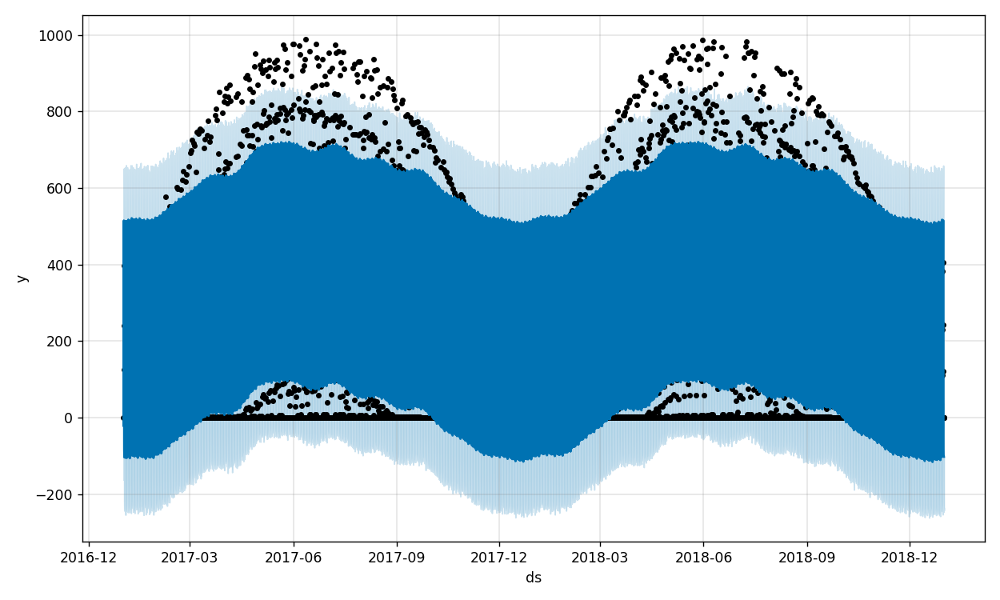

           trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
5835  193.859665   99.007703  368.895526   193.859665   193.859665   
5836  193.859515 -219.687440   60.024086   193.859515   193.859515   
5837  193.859365 -246.447932   32.778009   193.859365   193.859365   
5838  193.859216 -235.096196   40.149844   193.859216   193.859216   
5839  193.859066 -242.442858   36.973455   193.859066   193.859066   

      additive_terms  additive_terms_lower  additive_terms_upper       daily  \
5835       49.265295             49.265295             49.265295  153.131434   
5836     -276.010292           -276.010292           -276.010292 -172.132179   
5837     -296.608638           -296.608638           -296.608638 -192.752968   
5838     -296.575010           -296.575010           -296.575010 -192.754575   
5839     -296.511715           -296.511715           -296.511715 -192.718858   

      daily_lower  daily_upper      yearly  yearly_lower  yearly_upper  \
5835   153.131434   153.

<IPython.core.display.Javascript object>


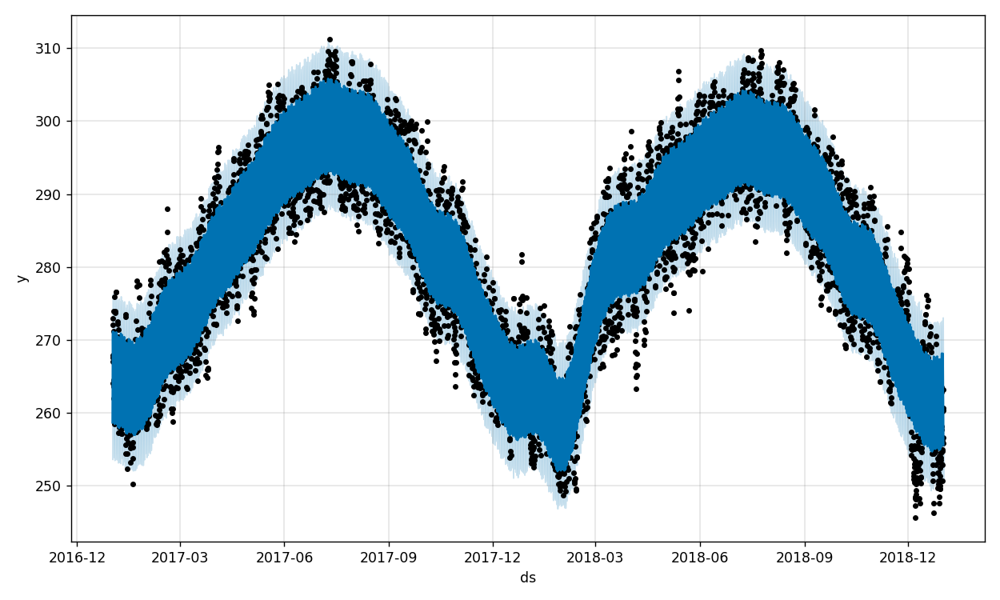

           trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
5835  280.074524  263.224956  273.086976   280.074524   280.074524   
5836  280.073981  259.583484  268.915333   280.073981   280.073981   
5837  280.073438  256.357639  265.762970   280.073438   280.073438   
5838  280.072896  252.665510  262.475387   280.072896   280.072896   
5839  280.072353  250.746233  260.888868   280.072353   280.072353   

      additive_terms  additive_terms_lower  additive_terms_upper     daily  \
5835      -11.935812            -11.935812            -11.935812  6.524491   
5836      -15.635233            -15.635233            -15.635233  2.895866   
5837      -19.300483            -19.300483            -19.300483 -0.705333   
5838      -22.476304            -22.476304            -22.476304 -3.830765   
5839      -24.485227            -24.485227            -24.485227 -5.808263   

      daily_lower  daily_upper     yearly  yearly_lower  yearly_upper  \
5835     6.524491     6.524491 -18.70

<IPython.core.display.Javascript object>


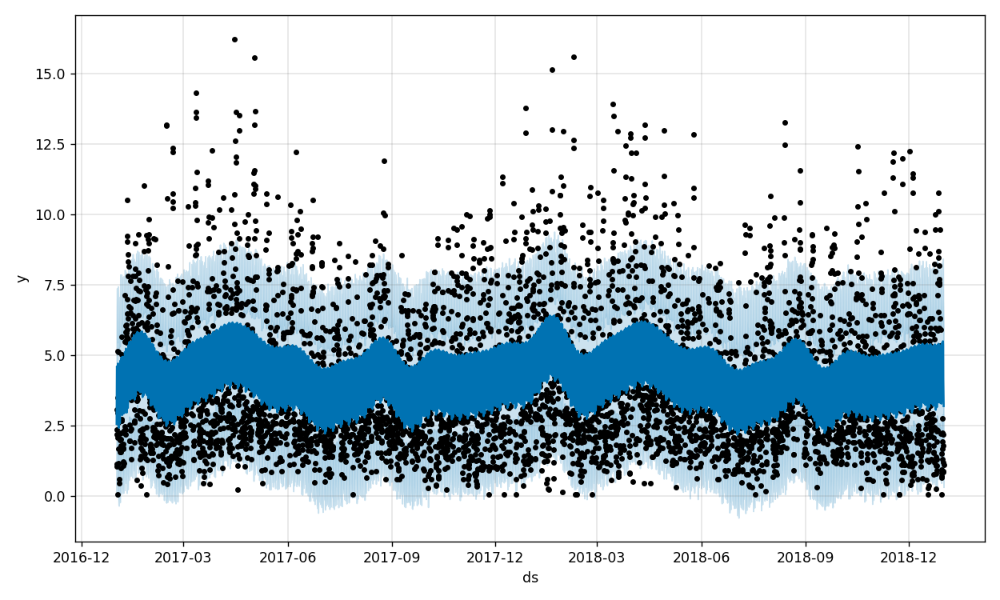

         trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
5835  4.040572    2.609513    8.063440     4.040572     4.040572   
5836  4.040556    1.172038    6.956152     4.040556     4.040556   
5837  4.040540    1.149569    6.642101     4.040540     4.040540   
5838  4.040524    0.491803    6.314830     4.040524     4.040524   
5839  4.040508    0.312231    5.975995     4.040508     4.040508   

      additive_terms  additive_terms_lower  additive_terms_upper     daily  \
5835        1.322562              1.322562              1.322562  1.085305   
5836        0.094858              0.094858              0.094858 -0.086657   
5837       -0.268239             -0.268239             -0.268239 -0.391258   
5838       -0.629281             -0.629281             -0.629281 -0.695977   
5839       -0.851260             -0.851260             -0.851260 -0.868636   

      daily_lower  daily_upper    yearly  yearly_lower  yearly_upper      yhat  
5835     1.085305     1.085305  0.196956 

In [8]:
X=np.empty((data.shape[0],0))
features = ['trend', 'yhat_lower', 'yhat_upper', 'trend_lower', 'trend_upper', 'additive_terms',
        'additive_terms_lower', 'additive_terms_upper', 'daily', 'daily_lower', 'daily_upper',
        'yearly', 'yearly_lower', 'yearly_upper', 'yhat']
for i in range(0, len(IImfs)):
    temp_df = pd.DataFrame(data['ds'])
    temp_df['y'] = IImfs[i]
    m = Prophet(changepoint_prior_scale=1.0, seasonality_prior_scale=0.1, seasonality_mode='additive', changepoint_range=0.2, yearly_seasonality=True)
    m.fit(temp_df)
    future = m.make_future_dataframe(periods=0, freq='3H')
    forecast = m.predict(future)
    X=np.append(X, forecast[features].to_numpy(), axis=1)
    fig1 = m.plot(forecast)
    fig1.show()
    print(forecast[features].tail())

In [9]:
X.shape

(5840, 1140)

In [10]:
#split the data into training and testing sets
split_line=4672
X_train = np.array(X[:split_line])
X_test = np.array(X[split_line:])
y_train = np.array(y[:split_line])
y_test = np.array(y[split_line:])

In [11]:
scaler = MinMaxScaler()
X_train = scaler.fit_transform(X_train)
X_test = scaler.transform(X_test)

In [12]:
X_train = np.reshape(X_train, (X_train.shape[0], 1, X_train.shape[1]))
X_test = np.reshape(X_test, (X_test.shape[0], 1, X_test.shape[1]))

In [13]:
#define the model structure
model = keras.models.Sequential()
model.add(keras.layers.GRU(1024, input_shape = (1, X_train.shape[1:][1]),
                           activation = 'relu', recurrent_activation = 'relu',
                           return_sequences = True))
model.add(keras.layers.GRU(1024, activation = 'sigmoid', recurrent_activation = 'sigmoid', return_sequences = True))
model.add(keras.layers.GRU(1024, activation = 'tanh', recurrent_activation = 'tanh', return_sequences = True))
model.add(keras.layers.Dense(1))

In [14]:
#define the hyperparameters for fitting the data to the model keras.optimizers.Adam(0.001)
model.compile(loss = keras.losses.Huber(), optimizer = keras.optimizers.Nadam(0.001))

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 gru (GRU)                   (None, 1, 1024)           6653952   
                                                                 
 gru_1 (GRU)                 (None, 1, 1024)           6297600   
                                                                 
 gru_2 (GRU)                 (None, 1, 1024)           6297600   
                                                                 
 dense (Dense)               (None, 1, 1)              1025      
                                                                 
Total params: 19,250,177
Trainable params: 19,250,177
Non-trainable params: 0
_________________________________________________________________


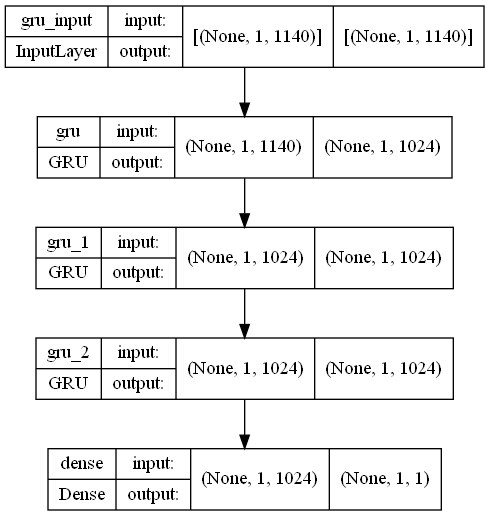

In [15]:
model.summary()
plot_model(model, to_file='model_plot.png', show_shapes=True, show_layer_names=True)

In [16]:
#callback function to stop running epochs when the error does not improve by a specified amount
es_callback = keras.callbacks.EarlyStopping(patience = 200, restore_best_weights = True)

In [17]:
#fit the model
history = model.fit(X_train, y_train, validation_split = 0.1, epochs = 10000, verbose = 1, shuffle = True,
                    callbacks = [es_callback])
#history = model.fit(X_train, y_train, epochs = 200, verbose = 1, shuffle = True)

Epoch 1/10000
132/132 [==============================] - 63s 453ms/step - loss: 1.4769 - val_loss: 1.1120
Epoch 2/10000
132/132 [==============================] - 67s 505ms/step - loss: 1.3223 - val_loss: 1.1018
Epoch 3/10000
132/132 [==============================] - 61s 465ms/step - loss: 1.2966 - val_loss: 1.1203
Epoch 4/10000
132/132 [==============================] - 59s 446ms/step - loss: 1.2834 - val_loss: 1.1441
Epoch 5/10000
132/132 [==============================] - 60s 456ms/step - loss: 1.2744 - val_loss: 1.1136
Epoch 6/10000
132/132 [==============================] - 57s 432ms/step - loss: 1.2640 - val_loss: 1.1023
Epoch 7/10000
132/132 [==============================] - 57s 430ms/step - loss: 1.2609 - val_loss: 1.1006
Epoch 8/10000
132/132 [==============================] - 60s 452ms/step - loss: 1.2556 - val_loss: 1.1061
Epoch 9/10000
132/132 [==============================] - 66s 500ms/step - loss: 1.2607 - val_loss: 1.1238
Epoch 10/10000
132/132 [======================

132/132 [==============================] - 54s 411ms/step - loss: 0.9693 - val_loss: 1.2169
Epoch 78/10000
132/132 [==============================] - 54s 411ms/step - loss: 0.9647 - val_loss: 1.1852
Epoch 79/10000
132/132 [==============================] - 54s 413ms/step - loss: 0.9550 - val_loss: 1.2099
Epoch 80/10000
132/132 [==============================] - 55s 416ms/step - loss: 0.9381 - val_loss: 1.2077
Epoch 81/10000
132/132 [==============================] - 54s 411ms/step - loss: 0.9391 - val_loss: 1.1741
Epoch 82/10000
132/132 [==============================] - 55s 416ms/step - loss: 0.9178 - val_loss: 1.2758
Epoch 83/10000
132/132 [==============================] - 55s 413ms/step - loss: 0.9183 - val_loss: 1.2164
Epoch 84/10000
132/132 [==============================] - 55s 413ms/step - loss: 0.8981 - val_loss: 1.2201
Epoch 85/10000
132/132 [==============================] - 54s 412ms/step - loss: 0.8886 - val_loss: 1.2519
Epoch 86/10000
132/132 [============================

132/132 [==============================] - 59s 449ms/step - loss: 0.2152 - val_loss: 1.5176
Epoch 154/10000
132/132 [==============================] - 59s 445ms/step - loss: 0.2013 - val_loss: 1.4543
Epoch 155/10000
132/132 [==============================] - 57s 432ms/step - loss: 0.1930 - val_loss: 1.4579
Epoch 156/10000
132/132 [==============================] - 58s 443ms/step - loss: 0.1942 - val_loss: 1.4873
Epoch 157/10000
132/132 [==============================] - 58s 441ms/step - loss: 0.1897 - val_loss: 1.4625
Epoch 158/10000
132/132 [==============================] - 58s 438ms/step - loss: 0.1796 - val_loss: 1.4851
Epoch 159/10000
132/132 [==============================] - 57s 430ms/step - loss: 0.1765 - val_loss: 1.4906
Epoch 160/10000
132/132 [==============================] - 62s 468ms/step - loss: 0.1778 - val_loss: 1.4354
Epoch 161/10000
132/132 [==============================] - 59s 446ms/step - loss: 0.1666 - val_loss: 1.5060
Epoch 162/10000
132/132 [===================

KeyboardInterrupt: 

In [48]:
#make predictions
predictions = model.predict(X_test)
predictions = predictions.flatten()
predictions[predictions < 0] = 0
print_metrics(predictions[:-1], y_test)

mape:  0.877871016662419
mae:  1.8967450761138345
mse:  6.530319519196664
rmse:  2.5554489858333436
score:  -0.300678733579278
accuracy:  0.2493573264781491


In [49]:
#print training error for checking over-fitting
mse_train = metrics.mean_absolute_percentage_error((model.predict(X_train)).flatten(), y_train)
print('train mape: ', mse_train)

train mape:  0.1862004957449733


<IPython.core.display.Javascript object>


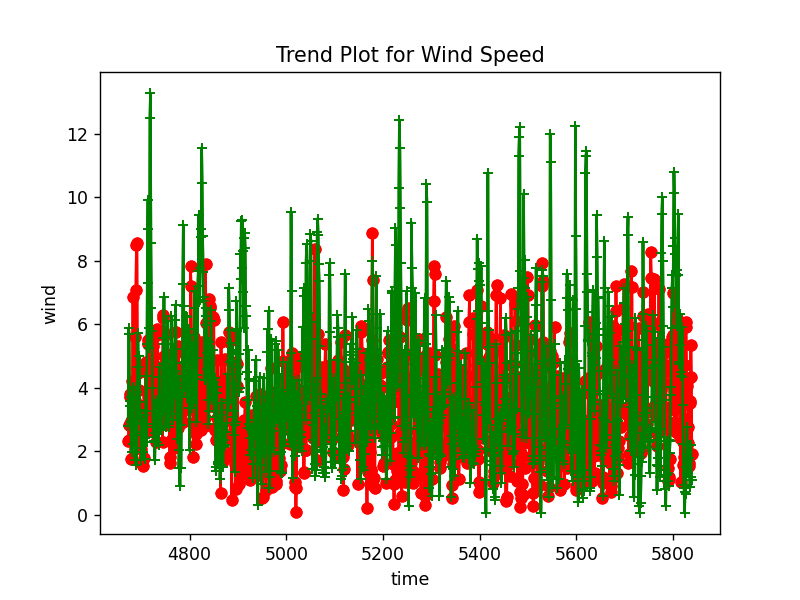

In [50]:
import matplotlib.pyplot as plt
%matplotlib notebook
x1=x2=data[["ds"]][1:][split_line:].index
y1=predictions[:-1]
y2=y_test
plt.plot(x1,y1,'ro-',x2,y2,'g+-')
plt.title('Trend Plot for Wind Speed')
l1=plt.plot(x1,y1,'ro-',label='predict')
l2=plt.plot(x2,y2,'g+-',label='real')
plt.xlabel('time')
plt.ylabel('wind')
plt.show()

<IPython.core.display.Javascript object>


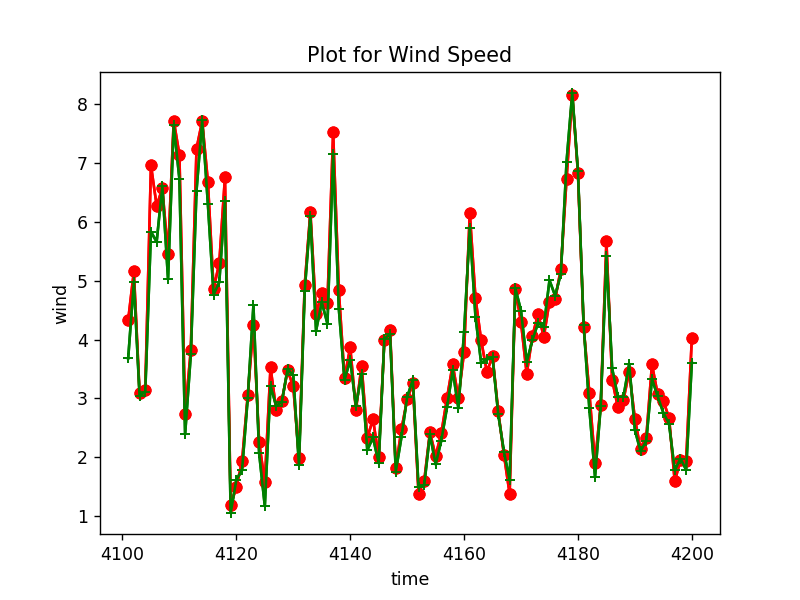

In [51]:
import matplotlib.pyplot as plt
%matplotlib notebook
fore_line=4100
end_line=4200
x1=x2=data[["ds"]][1:][fore_line:end_line].index
y1=model.predict(X_train).flatten()[fore_line:end_line]
y1[y1 < 0] = 0
y2=y_train[fore_line:end_line]
plt.plot(x1,y1,'ro-',x2,y2,'g+-')
plt.title('Plot for Wind Speed')
l1=plt.plot(x1,y1,'ro-',label='predict')
l2=plt.plot(x2,y2,'g+-',label='real')
plt.xlabel('time')
plt.ylabel('wind')
plt.show()

In [52]:
predicted = model.predict(X_train).flatten()
predicted[predicted < 0] = 0
generated = pd.DataFrame(data['ds'])[:-1]
generated['y_pred'] = np.append(predicted, predictions)[:-1]
generated['y_real'] = np.array(y)
generated.to_csv("GRU-exp1.csv")
generated.tail()

,ds,y_pred,y_real
5834,2018-12-31 06:00:00,3.575832,0.873997
5835,2018-12-31 09:00:00,3.523343,0.859997
5836,2018-12-31 12:00:00,5.342017,2.185997
5837,2018-12-31 15:00:00,4.326177,1.189999
5838,2018-12-31 18:00:00,1.904823,1.101997
